# Construct a multi-omics cell atlas of mouse thymus

- by CHANG XU changxu@nus.edu.sg.
- Last update: October 4th 2024

## Download the data （Under review, will be provided later）
- if you are have ``wget`` installed, you can run the following code to automatically download and unzip the data.

In [ ]:
# Skip this cells if data are already download
! wget -O A02677B5_cellbin_Protein.h5ad "*******"
! wget -O A02677B5_cellbin_domain_to_cellbin.h5ad "*******"

- if you do not have wget installed, manually download data from the links below:
    - Mouse spleen cellbin collected from ADT: "********************"
    - Mouse spleen cellbin collected from RNA: "********************"

In [2]:
import torch
import numpy as np
from builtins import range
from torch_geometric.data import InMemoryDataset, Data
from sklearn.metrics import pairwise_distances
import time
import spateo as st
import seaborn as sns

import pandas as pd
import anndata
import os 
import sys
import random
import matplotlib.pyplot as plt
import scanpy as sc
import logging
import sklearn
from collections import Counter
import yaml

import sodirac as sd

2024-11-18 09:34:03.625172: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2024-11-18 09:34:04.914482: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2024-11-18 09:34:05.097246: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1731893645.458955 3599521 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1731893645.594103 3599521 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-11-18 09:34:06.483523: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU ins

[easydl] tensorflow not available!


In [2]:
def seed_torch(seed=1029):   
    random.seed(seed)    
    os.environ['PYTHONHASHSEED'] = str(seed)    
    np.random.seed(seed)    
    torch.manual_seed(seed)    
    torch.cuda.manual_seed(seed)    
    torch.cuda.manual_seed_all(seed) 
    # if you are using multi-GPU.    
    torch.backends.cudnn.benchmark = False    
    torch.backends.cudnn.deterministic = True

seed_torch(seed=6)

In [ ]:
##########
import stereo as st
import os
import scanpy as sc

now="20241015172805"

######## read data
adata_cellbin = sc.read(f"/home/users/nus/changxu/scratch/section5/Results/A02677B5_cellbin_Dirac/{now}/Total/A02677B5_cellbin_Dirac_Total_target.h5ad")
adata_bin100 = sc.read("/home/users/nus/changxu/scratch/section5/Results/A02677B5_bin100_Dirac/20240923144826/A02677B5_bin100_Dirac_RNA_20240923144826.h5ad")

# create a dictionary to map cluster to annotation label
cluster2annotation = {
    "0": "Cortex",
    "1": "Medulla",
    "2": "Capsule",
    "3": "Cortex-Medulla",
}

# add a new `.obs` column called `cell type` by mapping clusters to annotation using pandas `map` function
adata_bin100.obs["region domain"] = adata_bin100.obs['Combined_leiden'].map(cluster2annotation).astype("category")

########### save colors
cluster2colors = {
    "Cortex": '#0d0887',
    "Medulla": '#9c179e',
    "Capsule": '#ed7953',
    "Cortex-Medulla":'#f0f921',
}
sc.pl.spatial(adata_bin100, color=["region domain"], palette=cluster2colors, frameon=False, spot_size=200, show=False)
adata_bin100.write(f"/home/users/nus/changxu/scratch/section5/Results/A02677B5_cellbin_Dirac/{now}/Total/bin100.h5ad", compression="gzip")

adata_bin50 = sc.read("/home/users/nus/changxu/scratch/section5/Results/A02677B5_bin50_Dirac/20240626143030/A02677B5_bin50_Dirac_RNA_deal.h5ad")

cluster2annotation = {
    "C_0":'Medullar level III',
    "C_1": 'Cortical level I',
    "C_2": 'Capsular',
    "C_3": 'Cortical level II',
    "C_4":'Cortical level III',
    "C_5":'Medullar level II',
    "C_6":'Cortical CMJ',
    "C_7":'Medullar level I',
    "C_8":'Medullar CMJ',
    "C_9":'Sub-Capsular',
}

# ['Capsular','Sub-Capsular','Cortical level I','Cortical level II','Cortical level III','Cortical CMJ','Medullar CMJ','Medullar level I','Medullar level II','Medullar level III']
# add a new `.obs` column called `cell type` by mapping clusters to annotation using pandas `map` function
adata_bin50.obs["region domain"] = adata_bin50.obs['Combined_leiden'].map(cluster2annotation).astype("category")

cluster2colors = {'Cortical level I': '#4DAF4A', 'Sub-Capsular': '#377EB8', 'Medullar level III': '#F781BF', 'Cortical level II': '#984EA3', 
                  'Cortical level III': '#FF7F00', 'Medullar CMJ': '#A65628', 'Medullar level II': '#E5D8BD', 'Medullar level I': '#999999', 
                  'Cortical CMJ': '#FFFF33', 'Capsular': '#E41A1C'}
sc.pl.spatial(adata_bin50, color=["region domain"], palette = cluster2colors, frameon=False, spot_size=65, img_key=None)

adata_bin50.write(f"/home/users/nus/changxu/scratch/section5/Results/A02677B5_cellbin_Dirac/{now}/Total/bin50.h5ad", compression="gzip")

adata_cellbin.write(f"/home/users/nus/changxu/scratch/section5/Results/A02677B5_cellbin_Dirac/{now}/Total/cellbin.h5ad", compression="gzip")

###############
adata_cellbin = st.io.read_h5ad(f"/home/users/nus/changxu/scratch/section5/Results/A02677B5_cellbin_Dirac/{now}/Total/cellbin.h5ad")
adata_bin100 = st.io.read_h5ad(f"/home/users/nus/changxu/scratch/section5/Results/A02677B5_cellbin_Dirac/{now}/Total/bin100.h5ad")
adata_bin50 = st.io.read_h5ad(f"/home/users/nus/changxu/scratch/section5/Results/A02677B5_cellbin_Dirac/{now}/Total/bin50.h5ad")


st.utils.cluster_bins_to_cellbins(adata_bin100, adata_cellbin, 'region domain')
adata_cellbin.cells["Clusters_from_bin100"] = adata_cellbin.cells["region domain_from_bins"]

st.utils.cluster_bins_to_cellbins(adata_bin50, adata_cellbin, 'region domain')
adata_cellbin.cells["Clusters_from_bin50"] = adata_cellbin.cells["region domain_from_bins"]

st.io.stereo_to_anndata(adata_cellbin,flavor='scanpy',output=os.path.join(f"/home/users/nus/changxu/scratch/section5/Results/A02677B5_cellbin_Dirac/{now}/Total","A02677B5_cluster_to_cellbin.h5ad"))

## Step 1: Remove cell types that do not exist in single-cell CITE-seq
- This step is to remove medullary thymic epithelial cells (mTEC).

In [3]:
############## First step1
data_path = "/home/project/11003054/changxu/Data/Stereo_cite_seq"
data_name = "A02677B5_cellbin"
methods = "Dirac"
use_obs_name = "cell_type"
now = time.strftime("%Y%m%d%H%M%S", time.localtime(time.time()))
print(now)

save_path = os.path.join("/home/users/nus/changxu/scratch/section5/Results", f"{data_name}_{methods}_scRNA_seq", f"{now}")
if not os.path.exists(save_path):
	os.makedirs(save_path)

colormaps= ["#E41A1C", "#377EB8", "#4DAF4A", "#984EA3", "#FF7F00", "#A65628", "#FFFF33", "#F781BF", "#999999", 
"#E5D8BD", "#B3CDE3", "#CCEBC5", "#FED9A6", "#FBB4AE", "#8DD3C7", "#BEBADA", "#80B1D3", "#B3DE69", "#FCCDE5", 
"#BC80BD", "#FFED6F", "#8DA0CB", "#E78AC3", "#E5C494", "#CCCCCC", "#FB9A99", "#E31A1C", "#CAB2D6","#6A3D9A", "#B15928"]

source_adata = anndata.read_h5ad(os.path.join(data_path, "single_cite_seq", "HTA08_v02_A04_Science_mouse_4_8weeks_by_QJ.h5ad"))
target_adata = anndata.read_h5ad(os.path.join(data_path, f"{data_name}_RNA.h5ad"))
source_adata.obs[f"{use_obs_name}"].value_counts()
sc.pp.filter_cells(target_adata, min_genes=100)
sc.pp.filter_genes(target_adata, min_cells=3)

20241015164118


In [4]:
source_adata.obs['cell_type'].value_counts()

DP(Q)                5742
DP(P)                2339
αβT(entry)           1777
CD4+T                1092
mTEC_I                991
mTEC_II               666
CD8+T                 577
Fb_Postn              528
mTEC_III              496
mTEC_IV(tuft)         284
Endo                  239
DN(Q)                 231
IELpA                 188
Fb_Pi16               130
B                     128
IELpB_NKT              93
Ery                    83
cTEC                   71
γδT                    59
Fb_Aldh1a2             57
Mac                    54
TEC(neuro)_like_1      45
Treg                   41
Mono                   35
TEC(neuro)_like_2      28
Fb                     22
DC2                    22
VSMC                   21
pDC                    16
DC1                     9
aDC                     7
DN(P)                   6
Name: cell_type, dtype: int64

In [5]:
source_adata.X.toarray()

array([[0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 1.86401676, 0.        ,
        0.        ],
       [0.        , 0.        , 1.55098021, ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 2.68329737,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ]])

In [6]:
####### Delete cells with fewer than 20
cells_to_keep = source_adata.obs[f"{use_obs_name}"].value_counts() >= 20
cells_to_keep = cells_to_keep[cells_to_keep].index.tolist()

# Keep only the rows where the number of cells is greater than or equal to 20
source_adata = source_adata[source_adata.obs[f"{use_obs_name}"].isin(cells_to_keep)]
print(source_adata.obs[f"{use_obs_name}"].value_counts())

print(target_adata.shape)
print(source_adata.shape)

# raw_matrix = (np.exp(source_adata.X.toarray()) - 1) / 10000
# # Extract the count vector for each cell
# counts_per_cell = source_adata.obs['nCount_RNA'].values
# # Multiply each column in the matrix by the corresponding count value, and round
# raw_matrix = np.round(raw_matrix * counts_per_cell[:, np.newaxis])
# # If needed, convert the matrix back to sparse format
# source_adata.X = sp.csr_matrix(raw_matrix)

######################
source_adata_raw = source_adata.copy()
sc.pp.log1p(source_adata_raw)
sc.tl.rank_genes_groups(source_adata_raw, groupby=use_obs_name, use_raw=False)
markers_df = pd.DataFrame(source_adata_raw.uns["rank_genes_groups"]["names"]).iloc[0:100, :]
markers = list(np.unique(markers_df.melt().value.values))
len(markers)

common_genes = list(set(markers) & set(source_adata.var_names) & (set(target_adata.var_names)))
source_adata = source_adata[:,common_genes].copy()
target_adata = target_adata[:,common_genes].copy()

source_adata.obs[f"{use_obs_name}_num"] = source_adata.obs[f"{use_obs_name}"].astype('category').cat.codes


DP(Q)                5742
DP(P)                2339
αβT(entry)           1777
CD4+T                1092
mTEC_I                991
mTEC_II               666
CD8+T                 577
Fb_Postn              528
mTEC_III              496
mTEC_IV(tuft)         284
Endo                  239
DN(Q)                 231
IELpA                 188
Fb_Pi16               130
B                     128
IELpB_NKT              93
Ery                    83
cTEC                   71
γδT                    59
Fb_Aldh1a2             57
Mac                    54
TEC(neuro)_like_1      45
Treg                   41
Mono                   35
TEC(neuro)_like_2      28
Fb                     22
DC2                    22
VSMC                   21
Name: cell_type, dtype: int64
(173649, 23586)
(16039, 15624)


In [7]:
###### create colors for cell types
colormaps_clusters = dict(set(zip(source_adata.obs[f"{use_obs_name}"].unique(), colormaps)))
print(colormaps_clusters)

source_adata.obs["batch"] = "Source"
target_adata.obs["batch"] = "Target"
pairs = dict(set(zip(source_adata.obs[f"{use_obs_name}_num"], source_adata.obs[f"{use_obs_name}"])))
source_label = source_adata.obs[f"{use_obs_name}_num"].values
source_regions = source_adata.obs["batch"].values
target_regions = target_adata.obs["batch"].values


# sc.pp.normalize_total(source_adata, target_sum=1e4)
# sc.pp.log1p(source_adata)
sc.pp.scale(source_adata)
# sc.pp.pca(source_adata)

sc.pp.normalize_total(target_adata, target_sum=1e4)
sc.pp.log1p(target_adata)
sc.pp.scale(target_adata)


source_adata.obsm["X_HVG"] = source_adata.X
target_adata.obsm["X_HVG"] = target_adata.X

source_adata.obsm["X_HVG"] = source_adata.obsm["X_HVG"].astype("float32")
target_adata.obsm["X_HVG"] = target_adata.obsm["X_HVG"].astype("float32")
print(target_adata)
print(source_adata)

{'Fb': '#BEBADA', 'cTEC': '#80B1D3', 'mTEC_II': '#CCCCCC', 'DC2': '#B3CDE3', 'VSMC': '#CAB2D6', 'IELpB_NKT': '#CCEBC5', 'DP(P)': '#984EA3', 'CD4+T': '#4DAF4A', 'Mac': '#F781BF', 'CD8+T': '#FFFF33', 'B': '#FBB4AE', 'DP(Q)': '#E41A1C', 'Fb_Pi16': '#FB9A99', 'Mono': '#8DD3C7', 'IELpA': '#FF7F00', 'Fb_Postn': '#FCCDE5', 'mTEC_IV(tuft)': '#E78AC3', 'Fb_Aldh1a2': '#E5C494', 'Endo': '#B3DE69', 'Treg': '#999999', 'mTEC_I': '#BC80BD', 'αβT(entry)': '#377EB8', 'TEC(neuro)_like_1': '#8DA0CB', 'TEC(neuro)_like_2': '#E31A1C', 'γδT': '#FED9A6', 'Ery': '#A65628', 'mTEC_III': '#FFED6F', 'DN(Q)': '#E5D8BD'}
AnnData object with n_obs × n_vars = 173649 × 1260
    obs: 'dnbCount', 'area', 'total_counts', 'n_genes_by_counts', 'pct_counts_mt', 'orig.ident', 'x', 'y', 'n_genes', 'batch'
    var: 'n_cells', 'n_counts', 'mean_umi', 'mean', 'std'
    uns: 'bin_size', 'bin_type', 'resolution', 'sn', 'log1p'
    obsm: 'cell_border', 'spatial', 'X_HVG'
AnnData object with n_obs × n_vars = 16039 × 1260
    obs: 'ce

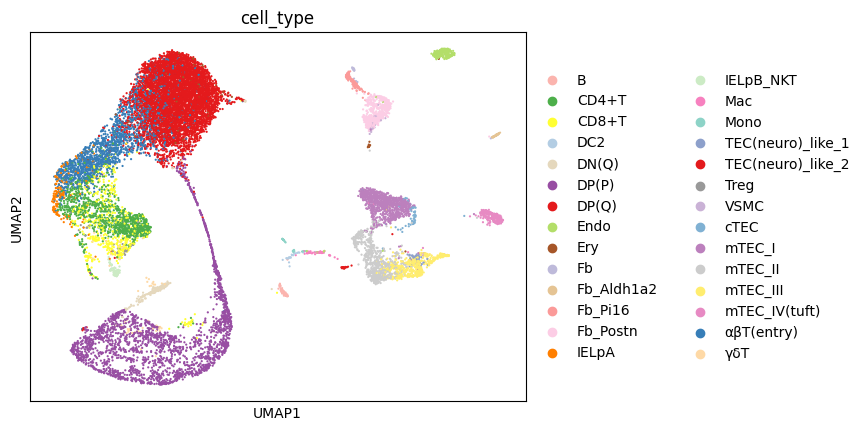

In [8]:
dp = sc.pl.umap(source_adata,color = "cell_type", palette = colormaps_clusters, size=10, return_fig=True)
dp.savefig(os.path.join(os.path.join("/home/users/nus/changxu/scratch/section5/Results", f"{data_name}_{methods}_scRNA_seq", f"{now}"),"cite_seq_annotation.pdf"), bbox_inches='tight', dpi = 300)

Found 2 unique domains.


Computing METIS partitioning...
Done!
Computing METIS partitioning...
Done!
SpaGNNs..: 100%|█| 50/50 [00:54<00:00,  1.09s/it, Loss=0.218, Ac


Counter({'DP(Q)': 45865, 'αβT(entry)': 26853, 'DP(P)': 22722, 'CD4+T': 15555, 'mTEC_I': 8386, 'CD8+T': 8171, 'mTEC_II': 6298, 'mTEC_III': 5109, 'DN(Q)': 4997, 'IELpA': 3560, 'cTEC': 2664, 'Fb_Postn': 2411, 'IELpB_NKT': 2007, 'VSMC': 1986, 'Treg': 1927, 'TEC(neuro)_like_1': 1770, 'mTEC_IV(tuft)': 1716, 'Ery': 1691, 'Mac': 1523, 'Fb': 1336, 'DC2': 1230, 'B': 1136, 'γδT': 1087, 'Mono': 1033, 'TEC(neuro)_like_2': 885, 'Fb_Pi16': 818, 'Endo': 590, 'Fb_Aldh1a2': 323})


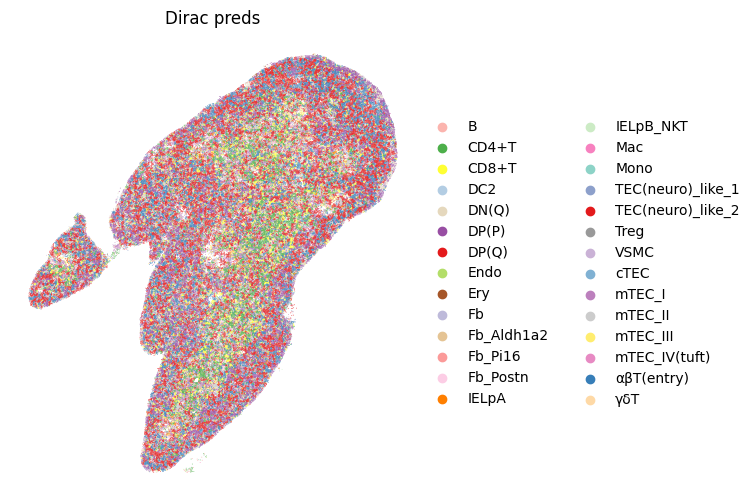

In [9]:
# Clear GPU memory
source_edge_index = get_multi_edge_index(source_adata.obsm["X_pca"].copy(), source_adata.obs[f"{use_obs_name}_num"], n_neighbors = 8)
source_edge_index = torch.LongTensor(source_edge_index).T
target_adata.obsm['spatial'] = target_adata.obsm['spatial'].astype("float32")
target_edge_index = get_single_edge_index(target_adata.obsm["spatial"].copy(), n_neighbors = 10)
target_edge_index = torch.LongTensor(target_edge_index).T

torch.cuda.empty_cache()
semisuper = fit_semisupervised(save_path = save_path, use_gpu=True)
samples = semisuper._get_data(
                source_data = source_adata.obsm["X_HVG"].copy(),
                source_label = source_label,
                source_edge_index = source_edge_index,
                target_data = target_adata.obsm["X_HVG"].copy(),
                target_edge_index = target_edge_index,
                source_domain = np.zeros(source_adata.shape[0]),
                target_domain = np.ones(target_adata.shape[0]),
                num_parts_source = source_adata.shape[0] // 300,
                num_parts_target = target_adata.shape[0] // 300,
                weighted_classes = False,)

models = semisuper._get_model(samples=samples, opt_GNN = "SAGE")
results = semisuper._train_GCAN(samples=samples, models=models, n_epochs=50)
np.save(os.path.join(save_path, f"{data_name}_{methods}_Results.npy"), results)


source_adata.obsm[f"{methods}_embed"] = results["source_feat"]
target_adata.obsm[f"{methods}_embed"] = results["target_feat"]
target_adata.obs[f"{methods}_confs"] = results["target_confs"]
target_adata.obs[f"{methods}_pred_num"] = results["target_pred"]
target_adata.obs[f"{methods}_pred_clusters"] = target_adata.obs[f"{methods}_pred_num"].map(pairs)
print(Counter(target_adata.obs[f"{methods}_pred_clusters"]))

fig, ax = plt.subplots(figsize=(8, 6))

sc.pl.spatial(target_adata, 
              color=[f"{methods}_pred_clusters"], 
              frameon=False, 
              spot_size=20, 
              title=["Dirac preds"], 
              palette = colormaps_clusters,
              ax=ax)
fig.savefig(os.path.join(save_path, f"{data_name}_cell_type.pdf"), bbox_inches='tight', dpi = 300)


# save_fig_path = os.path.join(save_path, "Single_cell_type")
# if not os.path.exists(save_fig_path):
#     os.makedirs(save_fig_path)


# single_cell_list = ['DP(Q)', 'CD4+T', 'αβT(entry)', 'DP(P)', 'CD8+T', 'mTEC_I', 'Fb_Aldh1a2', 'mTEC_III', 'mTEC_II', 'Fb_Postn', 'Endo']


# for i in target_adata.obs[f"{methods}_pred_clusters"].unique():
# # for i in single_cell_list:
#     fig, ax = plt.subplots(figsize=(8, 6))
#     sc.pl.spatial(target_adata, 
#                   color=[f"{methods}_pred_clusters"], 
#                   groups=[i], 
#                   frameon=False, 
#                   spot_size=20, 
#                   title=["Dirac preds"], 
#                   palette = colormaps_clusters,
#                   ax=ax,
#                  )
#     fig.savefig(os.path.join(save_fig_path, f"{data_name}_{i}.pdf"), bbox_inches='tight', dpi = 300)

######### save data
# target_adata.write(os.path.join(save_path, f"{data_name}_{methods}_target.h5ad"), compression="gzip")
# source_adata.write(os.path.join(save_path, f"{data_name}_{methods}_source.h5ad"), compression="gzip")

In [10]:
save_path

'/home/users/nus/changxu/scratch/section5/Results/A02677B5_cellbin_Dirac_scRNA_seq/20241015164118'

In [11]:
target_adata.obs['Dirac_pred_clusters'].unique().tolist()

['γδT',
 'DP(P)',
 'cTEC',
 'DP(Q)',
 'CD8+T',
 'αβT(entry)',
 'DN(Q)',
 'mTEC_III',
 'mTEC_II',
 'Mono',
 'IELpB_NKT',
 'Treg',
 'CD4+T',
 'IELpA',
 'Mac',
 'mTEC_I',
 'DC2',
 'TEC(neuro)_like_1',
 'VSMC',
 'Fb_Pi16',
 'Fb',
 'TEC(neuro)_like_2',
 'Fb_Postn',
 'Ery',
 'mTEC_IV(tuft)',
 'B',
 'Fb_Aldh1a2',
 'Endo']

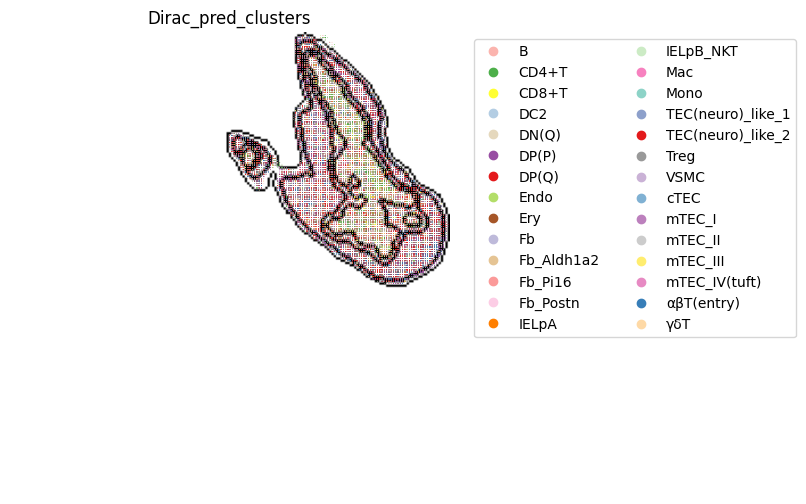

<Figure size 640x480 with 0 Axes>

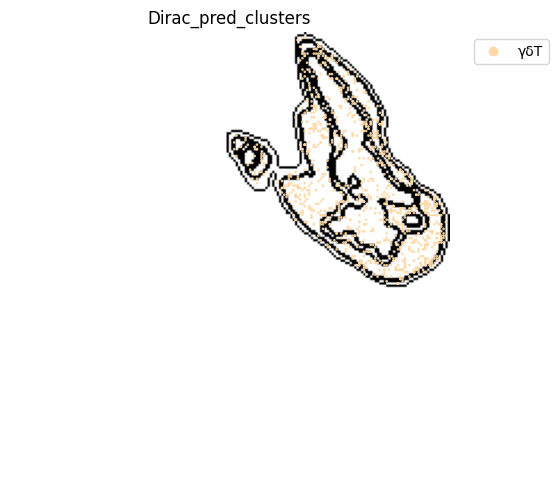

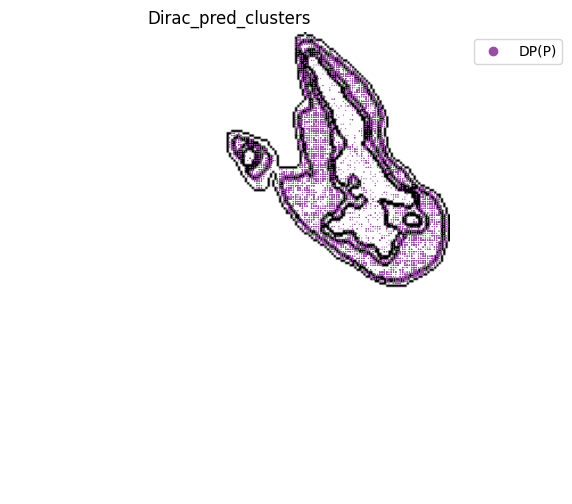

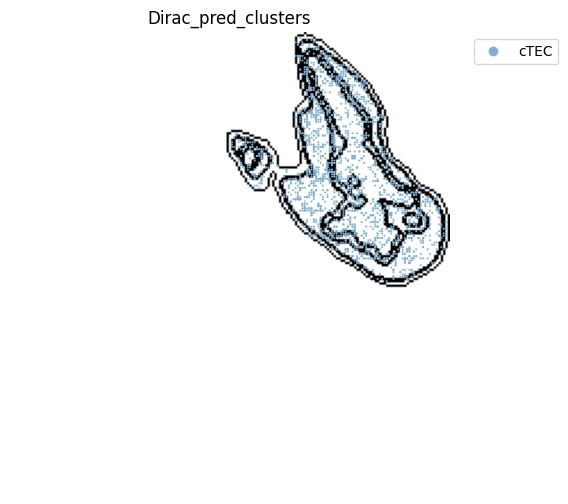

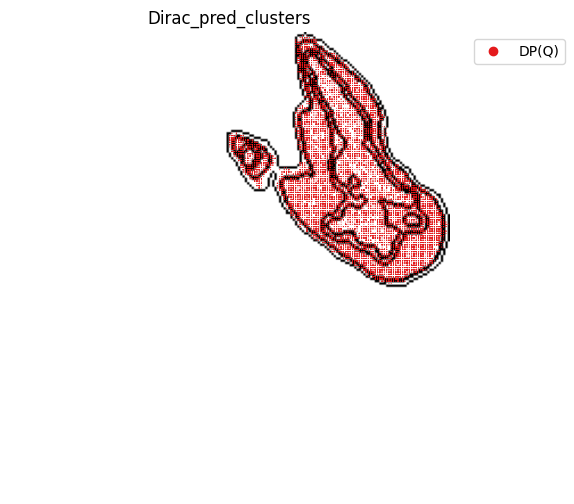

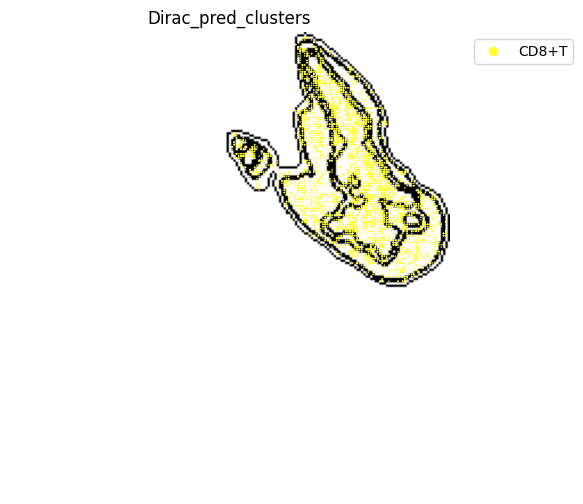

...

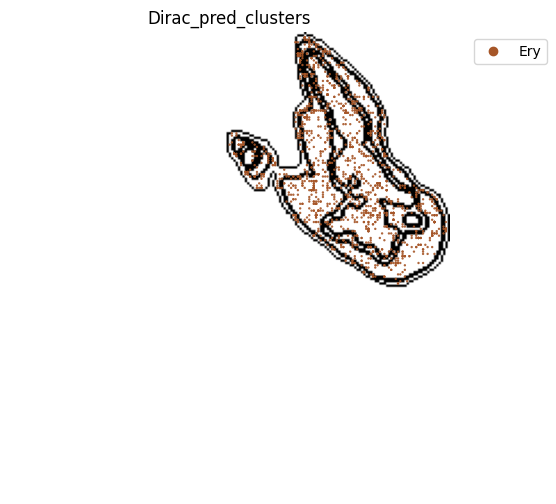

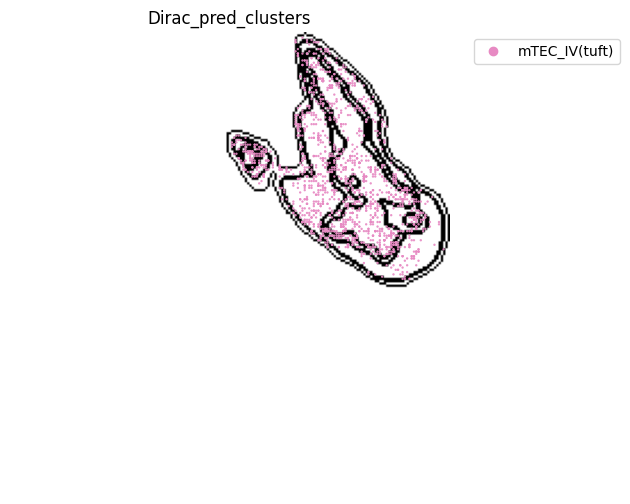

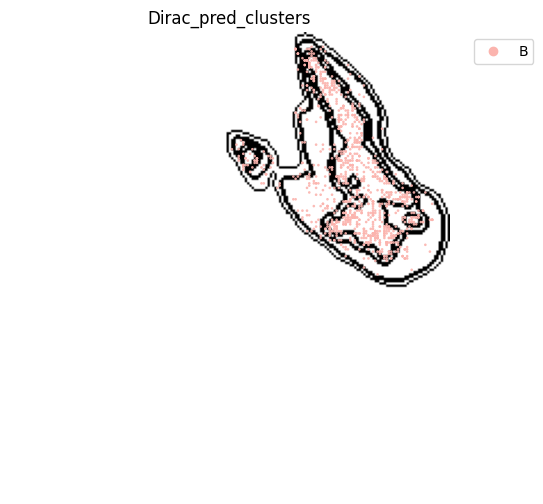

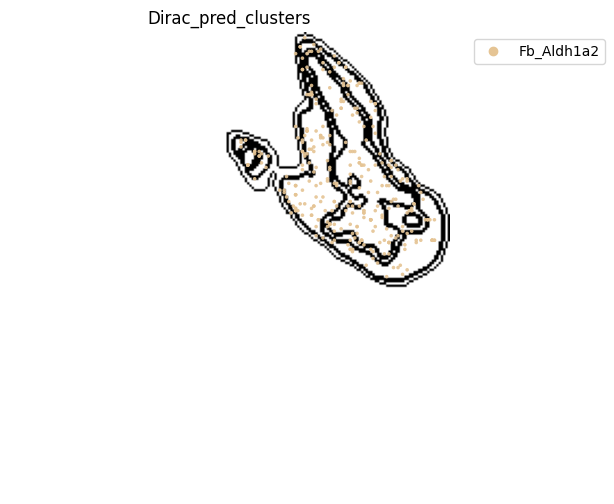

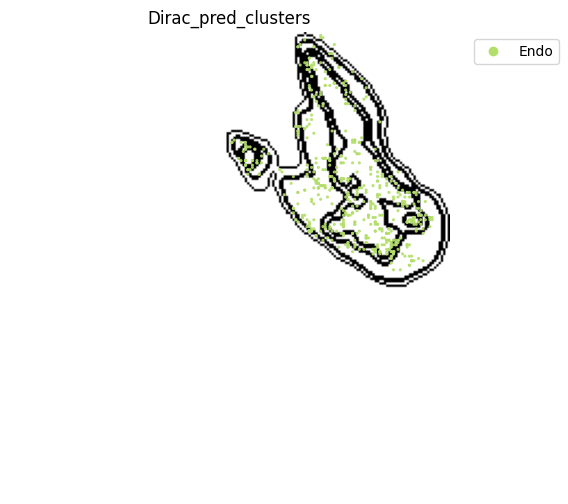

In [12]:
target_adata.uns['__type'] = 'UMI'
target_adata.obsm['spatial_bin100'] = target_adata.obsm['spatial'] // 100

target_adata = st.io.read_image(
    target_adata,
    filename=os.path.join("/home/users/nus/changxu/scratch/section5/Results/A02677B5_bin100_Dirac/20240923144826", "spatial_domains.png"),
    img_layer="layer1",
    slice="slice1",
    scale_factor=1,
)

fig, ax = plt.subplots(figsize=(8, 6))
st.pl.space(
    target_adata,
    space='spatial_bin100',
    color=["Dirac_pred_clusters"],
    alpha=0.9,
    # figsize=(5, 3),
    show_legend="upper left",
    img_layers = "layer1",
    slices="slice1",
    # dpi=300, 
    pointsize=0.03,
    color_key = colormaps_clusters,
    ax=ax,
)
plt.tight_layout()
plt.show() 
fig.savefig(os.path.join(save_path, f"{data_name}_{methods}_cell_type_outlines.png"), dpi = 600)

save_fig_path = os.path.join(save_path, "Single_cell_type_outline")
if not os.path.exists(save_fig_path):
    os.makedirs(save_fig_path)

for i in target_adata.obs[f"{methods}_pred_clusters"].unique():
    fig, ax = plt.subplots(figsize=(8, 6))
    st.pl.space(
        target_adata[target_adata.obs[f"{methods}_pred_clusters"].isin([i])],
        space = 'spatial_bin100',
        color = ["Dirac_pred_clusters"],
        alpha = 0.9,
        figsize = (5, 3),
        show_legend = "upper left",
        img_layers = "layer1",
        slices="slice1",
        dpi=300, 
        pointsize=0.03,
        color_key = colormaps_clusters,
        ax=ax)
    fig.savefig(os.path.join(save_fig_path, f"{data_name}_{i}.png"), dpi = 600)

In [17]:
########### collect cell types
collect_cell_types = ["DP(Q)", "DP(P)","αβT(entry)","CD4+T","CD8+T","DN(Q)","B","γδT","Treg","DN(P)","Ery", "IELpB_NKT"] #, 'Mono', 'Mac'
collect_cell_id = target_adata[target_adata.obs[f"{methods}_pred_clusters"].isin(collect_cell_types)].obs_names

In [18]:
collect_cell_id

Index(['73250667242492', '69256347657413', '69221987919057', '69191923148014',
       '69097433867495', '69067369096442', '68947110012158', '68934225110254',
       '68728066680051', '68594922693882',
       ...
       '59579786350141', '59523951775316', '59502476938775', '59498181971596',
       '59476707135090', '59425167527467', '59420872560193', '59399397723770',
       '59390807789206', '59377922887262'],
      dtype='object', length=132011)

## Step 2: Run the horizontal integration task of DIRAC
- Annotation using ADT + RNA
- Annotation using RNA only
- Annotation using ADT only

### Step 2.1: ADT+RNA
- Load packages and data, including CITE-seq and Stereo-CITE-seq.
- Filter data and preprocess
- Run DIRAC's horizontal integration task
- Visualize the spatial distribution of mouse spleen cells

In [20]:
data_path = "/home/project/11003054/changxu/Data/Stereo_cite_seq"
data_name = "A02677B5_cellbin"
methods = "Dirac"
use_obs_name = "annotations"
results_path = "/home/users/nus/changxu/scratch/section5/Results"
now = time.strftime("%Y%m%d%H%M%S", time.localtime(time.time()))

colormaps= ["#E41A1C", "#377EB8", "#4DAF4A", "#984EA3", "#FF7F00", "#A65628", "#FFFF33", "#F781BF", "#999999", 
"#E5D8BD", "#B3CDE3", "#CCEBC5", "#FED9A6", "#FBB4AE", "#8DD3C7", "#BEBADA", "#80B1D3", "#B3DE69", "#FCCDE5", 
"#BC80BD", "#FFED6F", "#8DA0CB", "#E78AC3", "#E5C494", "#CCCCCC", "#FB9A99", "#E31A1C", "#CAB2D6","#6A3D9A", "#B15928"]

source_adata = anndata.read_h5ad(os.path.join(data_path, "single_cite_seq", "post_adata_annotated.h5ad"))
target_adata = anndata.read_h5ad(os.path.join(data_path, f"{data_name}_RNA.h5ad"))
target_adata_protein = anndata.read_h5ad(os.path.join(data_path, f"{data_name}_Protein.h5ad"))

In [16]:
# source_adata_raw = source_adata.copy()
# source_adata_raw = source_adata_raw.raw.to_adata()
# sc.pp.log1p(source_adata_raw)
# sc.tl.rank_genes_groups(source_adata_raw, groupby=use_obs_name, use_raw=False)
# markers_df = pd.DataFrame(source_adata_raw.uns["rank_genes_groups"]["names"]).iloc[0:100, :]
# markers = list(np.unique(markers_df.melt().value.values))
# len(markers)

# common_genes = list(set(markers) & set(source_adata.var_names))

In [21]:
include_cells = [c not in ["Doublet"] for c in source_adata.obs[use_obs_name]]
source_adata = source_adata[include_cells]

print(source_adata.obs[f"{use_obs_name}"].value_counts())

target_adata = target_adata[collect_cell_id]
print(target_adata)

DP_Q2             10864
DP_Sig             9824
DP_Q1              8556
Mature_CD4         6525
Immature_CD8       5686
DP_P               5593
Immature_CD4       5164
Mature_CD8         4234
DN                 2395
GD_T               2279
Treg               1966
Neg_sel_2          1560
Dying              1552
Neg_sel_1          1206
Mature_cycling      992
Interferon_sig      984
NKT                 928
Myeloid             908
B                   106
Erythrocyte          43
Name: annotations, dtype: int64
View of AnnData object with n_obs × n_vars = 132011 × 27445
    obs: 'dnbCount', 'area', 'total_counts', 'n_genes_by_counts', 'pct_counts_mt', 'orig.ident', 'x', 'y'
    var: 'n_cells', 'n_counts', 'mean_umi'
    uns: 'bin_size', 'bin_type', 'resolution', 'sn'
    obsm: 'cell_border', 'spatial'


In [18]:
source_adata.obs[f"{use_obs_name}"].value_counts()

DP_Q2             10864
DP_Sig             9824
DP_Q1              8556
Mature_CD4         6525
Immature_CD8       5686
DP_P               5593
Immature_CD4       5164
Mature_CD8         4234
DN                 2395
GD_T               2279
Treg               1966
Neg_sel_2          1560
Dying              1552
Neg_sel_1          1206
Mature_cycling      992
Interferon_sig      984
NKT                 928
Myeloid             908
B                   106
Erythrocyte          43
Name: annotations, dtype: int64

In [22]:
import re
pattern = re.compile(r'ADT_(.*?)_A\d+')
source_adata_protein_names = [pattern.search(s).group(1) for s in source_adata.uns["protein_names"]]

def remove_parentheses(text):
    return re.sub(r'\(.*?\)', '', text)

source_adata_protein_names = [remove_parentheses(item) for item in source_adata_protein_names]
source_adata_protein_names = [s.replace('-', '_') for s in source_adata_protein_names]
source_adata_protein_names = [s.replace('.', '_') for s in source_adata_protein_names]

In [23]:
target_adata_protein_names = [s.replace('_Ms', '') for s in target_adata_protein.var_names]

In [24]:
############# Personalize and modify some names
######### Preferably use the source proteome to change the target protein names
source_adata_protein_names = [protein.replace('CD21_CD35', 'CD21_35') for protein in source_adata_protein_names]
source_adata_protein_names = [protein.replace('NK_1_1', 'NK1_1') for protein in source_adata_protein_names]
source_adata_protein_names = [protein.replace('TCRr_d', 'TCR_r_d') for protein in source_adata_protein_names]
source_adata_protein_names = [protein.replace('TER_119_ErythroidCells', 'TER119') for protein in source_adata_protein_names]
source_adata_protein_names = [protein.replace('Tim_4', 'Tim4') for protein in source_adata_protein_names]
source_adata_protein_names = [protein.replace('Ly_6C', 'Ly6C') for protein in source_adata_protein_names]
source_adata_protein_names = [protein.replace('Ly_6A_E', 'Ly6A_E') for protein in source_adata_protein_names]


In [25]:
intersection = list(set(source_adata_protein_names) & set(target_adata_protein_names))
print(intersection)

['CD5', 'CD20', 'CD115', 'CD4', 'CD79b', 'IgD', 'CD102', 'CX3CR1', 'CD73', 'CD93', 'NK1_1', 'CD25', 'CD357', 'CD11c', 'CD8b', 'CD172a', 'CD301a', 'TCR_r_d', 'CD103', 'CD23', 'CD223', 'CD63', 'CD68', 'CD304', 'CD106', 'CD49d', 'CD62L', 'CD69', 'CD83', 'CD90_2', 'CD169', 'Tim4', 'CD21_35', 'CD64', 'CD24', 'CD134', 'CD29', 'CD274', 'TER119', 'XCR1', 'CD137', 'IgM', 'CD38', 'CD8a', 'CD36', 'CD86', 'CD43', 'CD127', 'CD11a', 'F4_80', 'Ly6C', 'CD45_2', 'FceRIa', 'CD150', 'CD41', 'CD55', 'CD19', 'CD366', 'CD301b', 'SiglecH', 'I_A_I_E', 'CD54', 'CD279', 'CD48', 'CD45', 'CD200', 'CD71', 'Ly6A_E']


In [26]:
# pd.DataFrame(target_adata_protein_names).to_csv(os.path.join(data_path, "stereo_seq_protein_names.csv"))

In [27]:
# pd.DataFrame(source_adata_protein_names).to_csv(os.path.join(data_path, "cite_seq_protein_names.csv"))

In [28]:
# # Get common variable names (gene names) and include marker genes
# common_genes = list(set(source_adata.var_names) & set(target_adata.var_names) & set(markers))

# # Reindex both AnnData objects, keeping only the common genes
# target_adata = target_adata[:, common_genes]
# source_adata = source_adata[:, common_genes]


In [29]:
######################### Create a protein dataset.
source_adata_protein = anndata.AnnData(X=source_adata.obsm["protein_expression"])
source_adata_protein.obs_names = source_adata.obs_names
source_adata_protein.var_names = source_adata_protein_names
source_adata_protein.obs["annotations"] = source_adata.obs["annotations"]

target_adata_protein.var_names = target_adata_protein_names

######################### Get the intersection of proteins.
source_adata_protein = source_adata_protein[:, intersection]
target_adata_protein = target_adata_protein[:, intersection]

In [30]:
######################### Create a Protein + RNA dataset for the source data.
source_adata_total = anndata.AnnData(X=np.concatenate((source_adata.X, source_adata_protein.X), axis=1))
source_adata_total.obs_names = source_adata.obs_names
source_adata_total.var_names = source_adata.var_names.tolist() + source_adata_protein.var_names.tolist()
source_adata_total.obs["annotations"] = source_adata.obs["annotations"]
source_adata_total.obs["batch_indices"] = source_adata.obs["batch_indices"]

########################
# Align the target data with the source data (protein data matching)
target_adata_protein = target_adata_protein[target_adata.obs_names, :]
target_adata_total = anndata.AnnData(X=np.concatenate((target_adata.X.toarray(), target_adata_protein.X.toarray()), axis=1))
target_adata_total.obs_names = target_adata.obs_names
target_adata_total.var_names = target_adata.var_names.tolist() + target_adata_protein.var_names.tolist()
target_adata_total.obsm["spatial"] = target_adata_protein[target_adata.obs_names, :].obsm["spatial"]

In [33]:
source_adata_total.X

array([[ 0.,  0.,  0., ...,  4., 32., 27.],
       [ 0.,  0.,  0., ...,  9.,  3., 47.],
       [ 0.,  0.,  1., ...,  2., 12.,  5.],
       ...,
       [ 0.,  0.,  0., ...,  8., 15.,  4.],
       [ 0.,  0.,  0., ...,  2., 24., 17.],
       [ 1.,  0.,  1., ...,  4., 56., 10.]], dtype=float32)

In [34]:
target_adata_total.X

array([[ 0,  0,  0, ...,  1,  5,  7],
       [ 0,  0,  0, ...,  4,  1,  0],
       [ 0,  0,  0, ...,  7,  4,  2],
       ...,
       [ 0,  0,  0, ...,  7,  0,  8],
       [ 0,  0,  0, ...,  6,  0, 22],
       [ 0,  0,  0, ...,  4,  2, 24]], dtype=uint32)

In [35]:
######################### Train the Protein + RNA model step 1) Pre-training

# Define 'use_counts' to select the counts (total RNA/protein data)
use_counts = "Total"

# Identify common features (genes/proteins) between source and target datasets
common_features = list(set(source_adata_total.var_names) & set(target_adata_total.var_names))

# Subset the datasets to include only the common features
source_adata_total = source_adata_total[:, common_features].copy()
target_adata_total = target_adata_total[:, common_features].copy()

# Print the shape of the source and target data to check the number of cells and features
print(source_adata_total.shape)
print(target_adata_total.shape)

# Convert the category variable into numeric codes for easier processing
source_adata_total.obs[f"{use_obs_name}_num"] = source_adata_total.obs[f"{use_obs_name}"].astype('category').cat.codes

###### Generate a color mapping for clusters
colormaps_clusters = dict(set(zip(source_adata_total.obs[f"{use_obs_name}"].unique(), colormaps)))
print(colormaps_clusters)

# Create a save directory for the results if it doesn't already exist
save_path = os.path.join(results_path, f"{data_name}_{methods}", f"{now}", f"{use_counts}")
if not os.path.exists(save_path):
    os.makedirs(save_path)

# Add batch information for source and target datasets
source_adata_total.obs["batch"] = "Source"
target_adata_total.obs["batch"] = "Target"

# Create a dictionary to map numeric labels to the region names
pairs = dict(set(zip(source_adata_total.obs[f"{use_obs_name}_num"], source_adata_total.obs[f"{use_obs_name}"])))

# Extract label and region information for the source and target datasets
source_label = source_adata_total.obs[f"{use_obs_name}_num"].values
source_regions = source_adata_total.obs["batch"].values
target_regions = target_adata_total.obs["batch"].values

# Normalize, log-transform, and scale the data for source and target datasets
sc.pp.normalize_total(source_adata_total, target_sum=1e4)
sc.pp.log1p(source_adata_total)
sc.pp.scale(source_adata_total)
sc.pp.pca(source_adata_total)

sc.pp.normalize_total(target_adata_total, target_sum=1e4)
sc.pp.log1p(target_adata_total)
sc.pp.scale(target_adata_total)

# Store the processed RNA and protein data for both source and target datasets
source_adata_total.obsm["X_HVG"] = source_adata_total.X
target_adata_total.obsm["X_HVG"] = target_adata_total.X

# Cast the data to 'float32' type for better memory management and computational efficiency
source_adata_total.obsm["X_HVG"] = source_adata_total.obsm["X_HVG"].astype("float32")
target_adata_total.obsm["X_HVG"] = target_adata_total.obsm["X_HVG"].astype("float32")

(71365, 5054)
(132011, 5054)
{'DP_P': '#80B1D3', 'Neg_sel_1': '#B3DE69', 'Mature_CD8': '#984EA3', 'Erythrocyte': '#FCCDE5', 'Dying': '#999999', 'NKT': '#CCEBC5', 'DP_Sig': '#A65628', 'Immature_CD4': '#B3CDE3', 'Myeloid': '#8DD3C7', 'B': '#FF7F00', 'Mature_CD4': '#4DAF4A', 'DP_Q2': '#F781BF', 'Neg_sel_2': '#FED9A6', 'GD_T': '#BC80BD', 'Treg': '#BEBADA', 'Mature_cycling': '#FBB4AE', 'Immature_CD8': '#E5D8BD', 'Interferon_sig': '#FFFF33', 'DN': '#377EB8', 'DP_Q1': '#E41A1C'}


In [36]:
source_adata_total.obs["batch_indices"] = source_adata.obs["batch_indices"]
# source_edge_index = get_multi_edge_index(source_adata_total.obsm["X_pca"].copy(), source_adata_total.obs["batch_indices"].copy(), n_neighbors = 25)
source_edge_index = sd.utils.get_multi_edge_index(source_adata_total.obsm["X_pca"].copy(), source_adata_total.obs[f"{use_obs_name}"].copy(), n_neighbors = 10)
# source_edge_index = get_single_edge_index(source_adata_total.obsm["X_pca"].copy(), n_neighbors = 25)
source_edge_index = torch.LongTensor(source_edge_index).T
target_adata_total.obsm['spatial'] = target_adata_total.obsm['spatial'].astype('float32')
target_edge_index = sd.utils.get_single_edge_index(target_adata_total.obsm["spatial"].copy(), n_neighbors = 15)
target_edge_index = torch.LongTensor(target_edge_index).T

In [37]:
# Clear GPU memory
torch.cuda.empty_cache()
semisuper = sd.main.fit_semisupervised(save_path = save_path, use_gpu=True)
# num_parts = 200
samples = semisuper._get_data(
                source_data = source_adata_total.obsm["X_HVG"].copy(),
                source_label = source_label,
                source_edge_index = source_edge_index,
                target_data = target_adata_total.obsm["X_HVG"].copy(),
                target_edge_index = target_edge_index,
                source_domain = np.zeros(source_adata_total.shape[0]),
                target_domain = np.ones(target_adata_total.shape[0]),
                num_parts_source = source_adata_total.shape[0] // 1024,
                num_parts_target = target_adata_total.shape[0] // 1024,
                weighted_classes = False,)

models = semisuper._get_model(samples=samples, opt_GNN = "SAGE")
results = semisuper._train_GCAN(samples=samples, models=models, n_epochs=50)
np.save(os.path.join(save_path, f"{data_name}_{methods}_Results.npy"), results)

Found 2 unique domains.


Computing METIS partitioning...
Done!
Computing METIS partitioning...
Done!
SpaGNNs..: 100%|█| 50/50 [02:03<00:00,  2.47s/it, Loss=2.48, Acc


Counter({'DP_Q2': 42752, 'DP_Q1': 29797, 'Mature_CD4': 24624, 'DP_Sig': 19517, 'Immature_CD4': 7072, 'Immature_CD8': 2653, 'DP_P': 2001, 'Mature_CD8': 842, 'GD_T': 454, 'DN': 449, 'Interferon_sig': 439, 'Dying': 334, 'Treg': 319, 'Neg_sel_2': 283, 'NKT': 228, 'Mature_cycling': 108, 'Myeloid': 72, 'Neg_sel_1': 58, 'Erythrocyte': 8, 'B': 1})


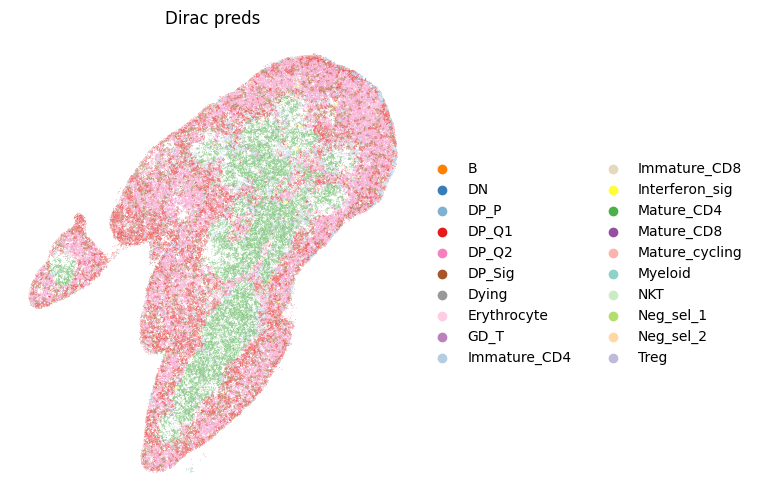

In [38]:
source_adata_total.obsm[f"{methods}_embed"] = results["source_feat"]
target_adata_total.obsm[f"{methods}_embed"] = results["target_feat"]
target_adata_total.obs[f"{methods}_confs"] = results["target_confs"]
target_adata_total.obs[f"{methods}_pred_num"] = results["target_pred"]
target_adata_total.obs[f"{methods}_pred_clusters"] = target_adata_total.obs[f"{methods}_pred_num"].map(pairs)
print(Counter(target_adata_total.obs[f"{methods}_pred_clusters"]))

fig, ax = plt.subplots(figsize=(8, 6))

sc.pl.spatial(target_adata_total, 
              color=[f"{methods}_pred_clusters"], 
              frameon=False, 
              spot_size=15, 
              title=["Dirac preds"], 
              palette = colormaps_clusters,
              img_key = None,
              ax=ax)
fig.savefig(os.path.join(save_path, f"{data_name}_cell_type.pdf"), bbox_inches='tight', dpi = 300)

In [35]:
# save_fig_path = os.path.join(save_path, "Single_cell_type")
# if not os.path.exists(save_fig_path):
#     os.makedirs(save_fig_path)

# for i in target_adata_total.obs[f"{methods}_pred_clusters"].unique():
#     fig, ax = plt.subplots(figsize=(8, 6))
#     sc.pl.spatial(target_adata_total, 
#                   color=[f"{methods}_pred_clusters"], 
#                   groups=[i], 
#                   frameon=False, 
#                   spot_size=15, 
#                   title=["Dirac preds"], 
#                   palette = colormaps_clusters,
#                   img_key = None,
#                   ax=ax,
#                  )
#     fig.savefig(os.path.join(save_fig_path, f"{data_name}_{i}.pdf"), bbox_inches='tight', dpi = 300)

In [39]:
target_adata_total.obsm['spatial_bin100'] = target_adata_total.obsm['spatial'] // 100

target_adata_total = st.io.read_image(
    target_adata_total,
    filename=os.path.join("/home/users/nus/changxu/scratch/section5/Results/A02677B5_bin100_Dirac/20240923144826", "spatial_domains.png"),
    img_layer="layer1",
    slice="slice1",
    scale_factor=1,
)
target_adata_total.uns["__type"] = "UMI"

In [40]:
target_adata_total.uns['Dirac_pred_clusters_colors']

['#ff7f00ff',
 '#377eb8ff',
 '#80b1d3ff',
 '#e41a1cff',
 '#f781bfff',
 '#a65628ff',
 '#999999ff',
 '#fccde5ff',
 '#bc80bdff',
 '#b3cde3ff',
 '#e5d8bdff',
 '#ffff33ff',
 '#4daf4aff',
 '#984ea3ff',
 '#fbb4aeff',
 '#8dd3c7ff',
 '#ccebc5ff',
 '#b3de69ff',
 '#fed9a6ff',
 '#bebadaff']

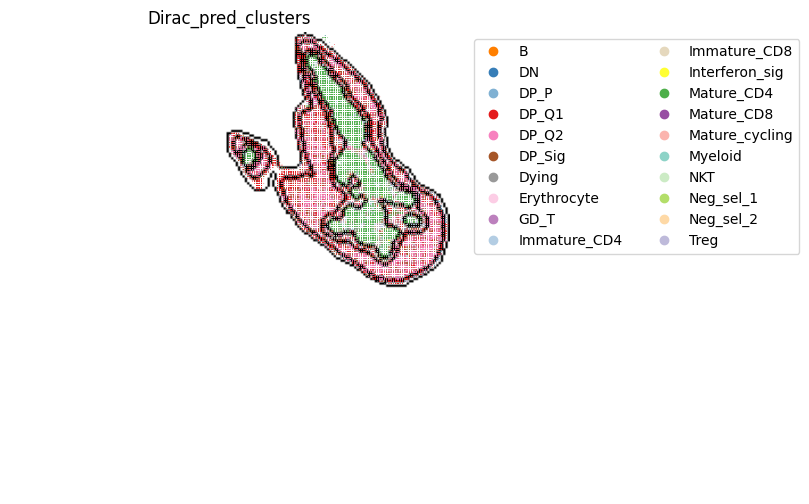

<Figure size 640x480 with 0 Axes>

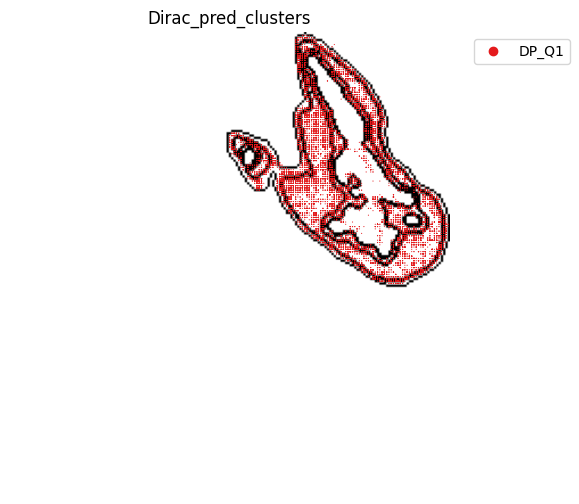

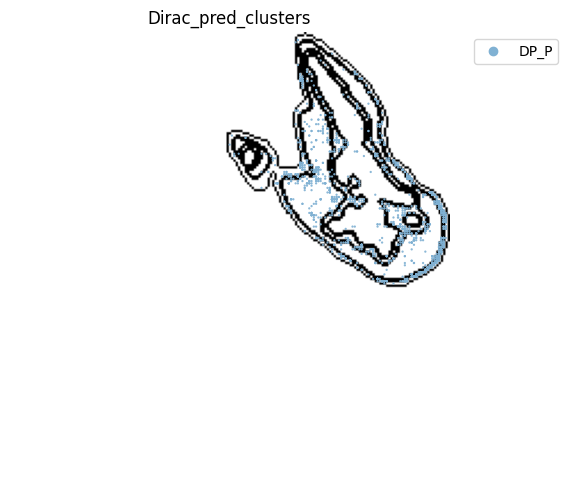

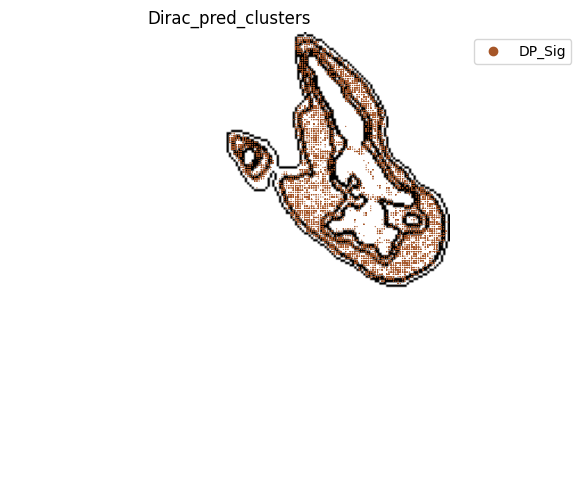

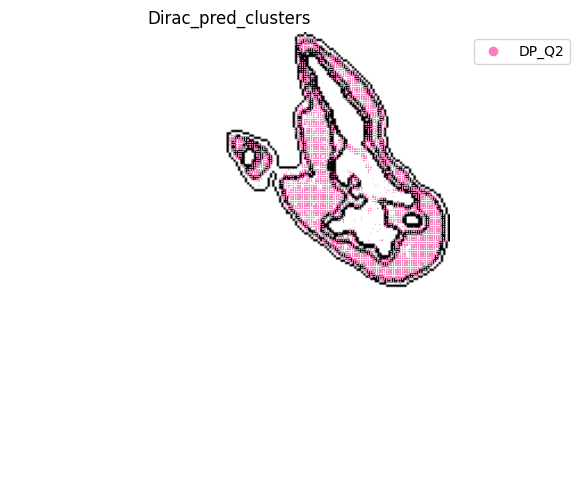

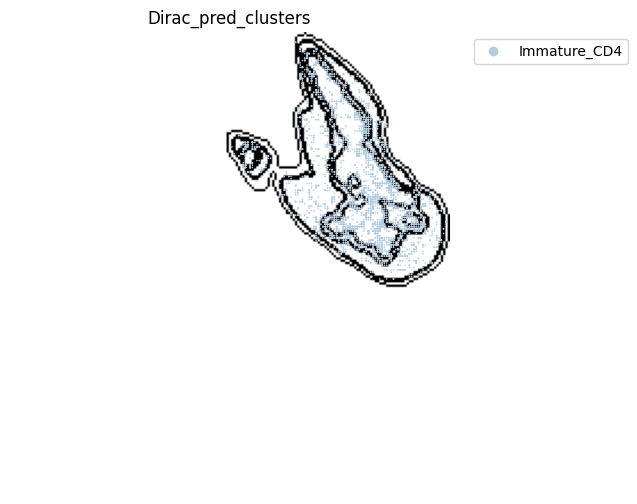

...

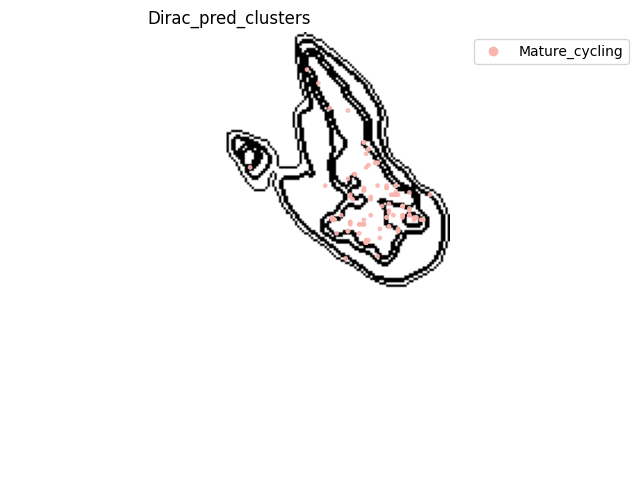

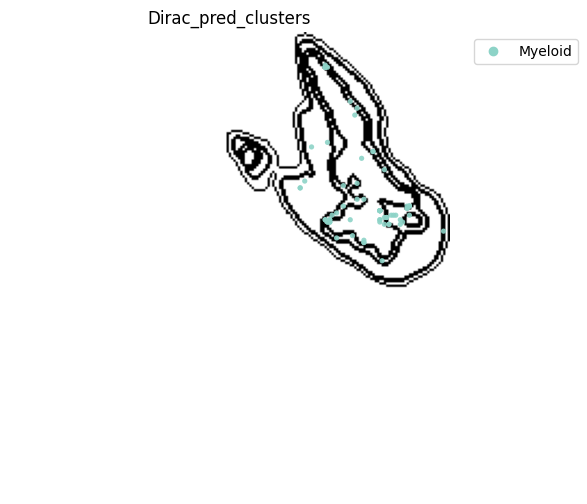

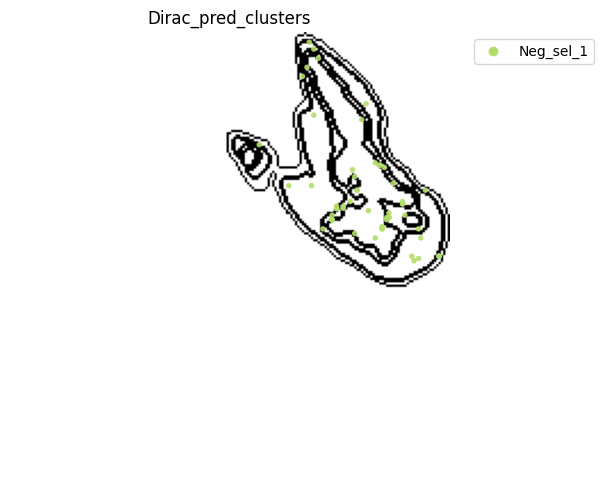

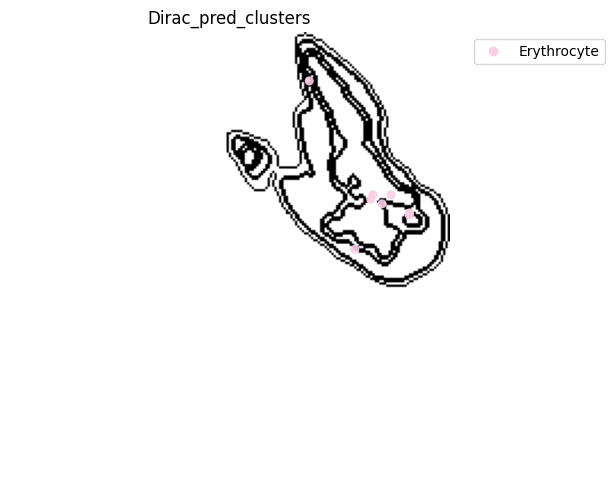

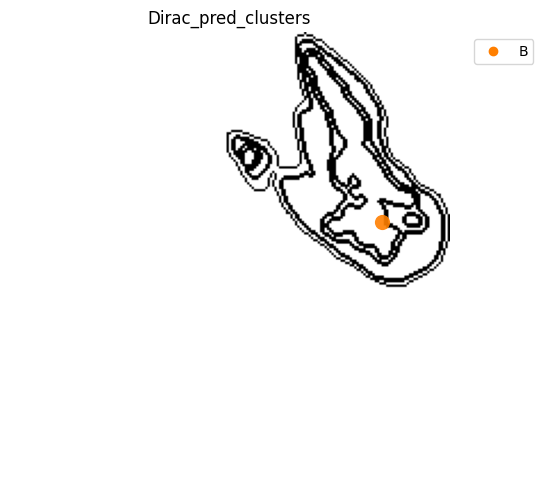

In [41]:
fig, ax = plt.subplots(figsize=(8, 6))
st.pl.space(
    target_adata_total,
    space="spatial_bin100",
    color=["Dirac_pred_clusters"],
    alpha=0.9,
    # figsize=(5, 3),
    show_legend="upper left",
    img_layers = "layer1",
    slices="slice1",
    # dpi=300, 
    pointsize=0.03,
    color_key = colormaps_clusters,
    ax=ax,
)
plt.tight_layout()
plt.show() 
fig.savefig(os.path.join(save_path, f"{data_name}_{methods}_cell_type_outlines.png"), dpi = 600)

save_fig_path = os.path.join(save_path, "Single_cell_type_outline")
if not os.path.exists(save_fig_path):
    os.makedirs(save_fig_path)

for i in target_adata_total.obs[f"{methods}_pred_clusters"].unique():
    fig, ax = plt.subplots(figsize=(8, 6))
    st.pl.space(
        target_adata_total[target_adata_total.obs[f"{methods}_pred_clusters"].isin([i])],
        space = "spatial_bin100",
        color = ["Dirac_pred_clusters"],
        alpha = 0.9,
        figsize = (5, 3),
        show_legend = "upper left",
        img_layers = "layer1",
        slices="slice1",
        dpi=300, 
        pointsize=0.03,
        color_key = colormaps_clusters,
        ax=ax)
    fig.savefig(os.path.join(save_fig_path, f"{data_name}_{i}.png"), dpi = 600)

# ######### 保存数据
target_adata_total.write(os.path.join(save_path, f"{data_name}_{methods}_{use_counts}_target.h5ad"), compression="gzip")
source_adata_total.write(os.path.join(save_path, f"{data_name}_{methods}_{use_counts}_source.h5ad"), compression="gzip")

In [42]:
save_path

'/home/users/nus/changxu/scratch/section5/Results/A02677B5_cellbin_Dirac/20241015172805/Total'

In [ ]:
##########
import stereo as st
import os
import scanpy as sc

now="20241015172805"

adata_cellbin = sc.read(f"/home/users/nus/changxu/scratch/section5/Results/A02677B5_cellbin_Dirac/{now}/Total/A02677B5_cellbin_Dirac_Total_target.h5ad")
adata_bin100 = sc.read("/home/users/nus/changxu/scratch/section5/Results/A02677B5_bin100_Dirac/20240923144826/A02677B5_bin100_Dirac_RNA_20240923144826.h5ad")

# create a dictionary to map cluster to annotation label
cluster2annotation = {
    "0": "Cortex",
    "1": "Medulla",
    "2": "Capsule",
    "3": "Cortex-Medulla",
}

# add a new `.obs` column called `cell type` by mapping clusters to annotation using pandas `map` function
adata_bin100.obs["region domain"] = adata_bin100.obs['Combined_leiden'].map(cluster2annotation).astype("category")

########### save colors
cluster2colors = {
    "Cortex": '#0d0887',
    "Medulla": '#9c179e',
    "Capsule": '#ed7953',
    "Cortex-Medulla":'#f0f921',
}
sc.pl.spatial(adata_bin100, color=["region domain"], palette=cluster2colors, frameon=False, spot_size=200, show=False)
adata_bin100.write(f"/home/users/nus/changxu/scratch/section5/Results/A02677B5_cellbin_Dirac/{now}/Total/bin100.h5ad", compression="gzip")

adata_bin50 = sc.read("/home/users/nus/changxu/scratch/section5/Results/A02677B5_bin50_Dirac/20240626143030/A02677B5_bin50_Dirac_RNA_deal.h5ad")

cluster2annotation = {
    "C_0":'Medullar level III',
    "C_1": 'Cortical level I',
    "C_2": 'Capsular',
    "C_3": 'Cortical level II',
    "C_4":'Cortical level III',
    "C_5":'Medullar level II',
    "C_6":'Cortical CMJ',
    "C_7":'Medullar level I',
    "C_8":'Medullar CMJ',
    "C_9":'Sub-Capsular',
}

# ['Capsular','Sub-Capsular','Cortical level I','Cortical level II','Cortical level III','Cortical CMJ','Medullar CMJ','Medullar level I','Medullar level II','Medullar level III']
# add a new `.obs` column called `cell type` by mapping clusters to annotation using pandas `map` function
adata_bin50.obs["region domain"] = adata_bin50.obs['Combined_leiden'].map(cluster2annotation).astype("category")

cluster2colors = {'Cortical level I': '#4DAF4A', 'Sub-Capsular': '#377EB8', 'Medullar level III': '#F781BF', 'Cortical level II': '#984EA3', 
                  'Cortical level III': '#FF7F00', 'Medullar CMJ': '#A65628', 'Medullar level II': '#E5D8BD', 'Medullar level I': '#999999', 
                  'Cortical CMJ': '#FFFF33', 'Capsular': '#E41A1C'}
sc.pl.spatial(adata_bin50, color=["region domain"], palette = cluster2colors, frameon=False, spot_size=65, img_key=None)

adata_bin50.write(f"/home/users/nus/changxu/scratch/section5/Results/A02677B5_cellbin_Dirac/{now}/Total/bin50.h5ad", compression="gzip")

adata_cellbin.write(f"/home/users/nus/changxu/scratch/section5/Results/A02677B5_cellbin_Dirac/{now}/Total/cellbin.h5ad", compression="gzip")

###############
adata_cellbin = st.io.read_h5ad(f"/home/users/nus/changxu/scratch/section5/Results/A02677B5_cellbin_Dirac/{now}/Total/cellbin.h5ad")
adata_bin100 = st.io.read_h5ad(f"/home/users/nus/changxu/scratch/section5/Results/A02677B5_cellbin_Dirac/{now}/Total/bin100.h5ad")
adata_bin50 = st.io.read_h5ad(f"/home/users/nus/changxu/scratch/section5/Results/A02677B5_cellbin_Dirac/{now}/Total/bin50.h5ad")


st.utils.cluster_bins_to_cellbins(adata_bin100, adata_cellbin, 'region domain')
adata_cellbin.cells["Clusters_from_bin100"] = adata_cellbin.cells["region domain_from_bins"]

st.utils.cluster_bins_to_cellbins(adata_bin50, adata_cellbin, 'region domain')
adata_cellbin.cells["Clusters_from_bin50"] = adata_cellbin.cells["region domain_from_bins"]

st.io.stereo_to_anndata(adata_cellbin,flavor='scanpy',output=os.path.join(f"/home/users/nus/changxu/scratch/section5/Results/A02677B5_cellbin_Dirac/{now}/Total","A02677B5_cluster_to_cellbin.h5ad"))


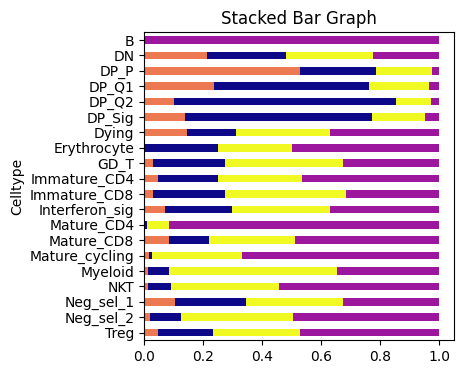

In [5]:
# Summary domain-cell relationship
now="20241015172805"

adata_cellbin = sc.read(os.path.join(f"/home/users/nus/changxu/scratch/section5/Results/A02677B5_cellbin_Dirac/{now}/Total","A02677B5_cluster_to_cellbin.h5ad"))
methods = "Dirac"
data_name = "A02677B5"

save_path = f"/home/users/nus/changxu/scratch/section5/Results/A02677B5_cellbin_Dirac/{now}/Total/cell_distribution_bin50_bin100_to_cellbin"
if not os.path.exists(save_path):
    os.makedirs(save_path)

bin100_cluster2colors = {
    "Cortex": '#0d0887',
    "Medulla": '#9c179e',
    "Capsule": '#ed7953',
    "Cortex-Medulla":'#f0f921',
}

domain_list = np.array([])
celltype_list = np.array([])
count_list = np.array([])
for i in np.unique(adata_cellbin.obs['Clusters_from_bin100']):
    tmp, counts = np.unique(adata_cellbin[adata_cellbin.obs['Clusters_from_bin100'] == i,:].obs[f"{methods}_pred_clusters"], return_counts=True)
    domain_list = np.append(domain_list, np.repeat(i, len(counts)))
    celltype_list = np.append(celltype_list, tmp)
    count_list = np.append(count_list, counts)
hetero_df = pd.DataFrame({"domain":domain_list, "celltype":celltype_list, "count":count_list.astype(int)})

hetero_df[0:10]

# Cell distribution among domains
spec_df_plt = hetero_df.pivot(index="celltype", columns="domain", values="count").fillna(0)
spec_df_plt = spec_df_plt.div(spec_df_plt.sum(axis=1), axis=0)

spec_df_plt['Celltype'] = spec_df_plt.index
spec_df_plt.index = pd.CategoricalIndex(spec_df_plt.index, categories=spec_df_plt.index.astype(str).sort_values())
spec_df_plt = spec_df_plt.sort_index(ascending=False)


ax = spec_df_plt.plot(
    x = 'Celltype',
    kind = 'barh',
    stacked = True,
    title = 'Stacked Bar Graph',
    mark_right = True,
    figsize=(4, 4),
    legend = False,
    color = bin100_cluster2colors,
)

# Save the plot
plt.savefig(os.path.join(save_path, f"{data_name}_bin100_celltype_distribution.pdf"), dpi = 600)
plt.show()


# spec_df_plt.plot(
#     x = 'Celltype',
#     kind = 'barh',
#     stacked = True,
#     title = 'Stacked Bar Graph',
#     mark_right = True,
#     figsize=(4, 4),
#     legend = False,
#     color = bin100_cluster2colors,
# )
# plt.savefig(os.path.join(save_path, f"{data_name}_bin100_celltype_distribution.pdf"), dpi = 600)

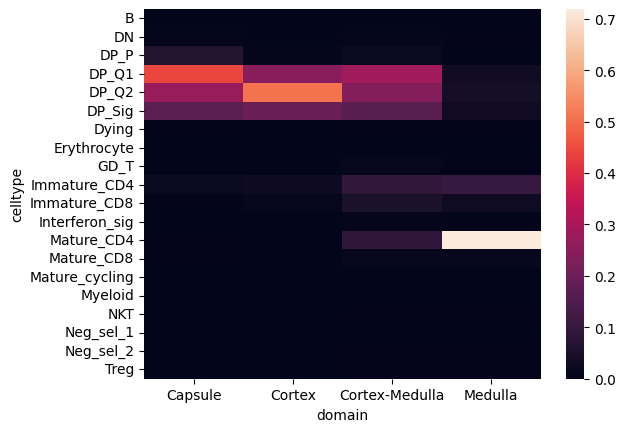

In [6]:
# Cell composition within each domain
import seaborn as sns
hetero_df_plt = hetero_df[hetero_df.domain!="NA"].pivot(index="domain", columns="celltype", values="count").fillna(0)
hetero_df_plt = hetero_df_plt.div(hetero_df_plt.sum(axis=1), axis=0)

ax = sns.heatmap(hetero_df_plt.T)
plt.savefig(os.path.join(save_path, f"{data_name}_bin100_celltype_heatmap.pdf"), dpi = 600)
plt.show()

In [7]:
adata_cellbin.obs['Clusters_from_bin50']

73250667242492        Capsular
69256347657413    Sub-Capsular
69221987919057    Sub-Capsular
69191923148014    Sub-Capsular
69097433867495        Capsular
                      ...     
56075093036591    Sub-Capsular
57397942963712        Capsular
57290568781326        Capsular
57251914075650        Capsular
57243324141082        Capsular
Name: Clusters_from_bin50, Length: 131958, dtype: category
Categories (10, object): ['Medullar level III', 'Cortical level I', 'Capsular', 'Cortical level II', ..., 'Cortical CMJ', 'Medullar level I', 'Medullar CMJ', 'Sub-Capsular']

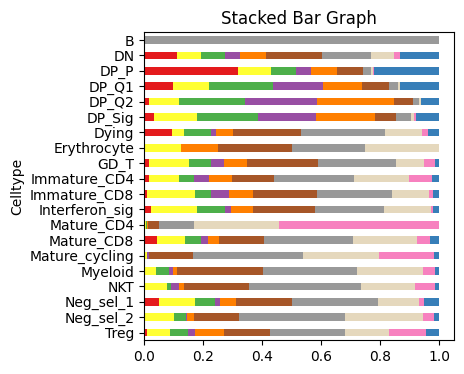

In [8]:
############## Perform downstream analysis bin=50
# Read the pre-existing data from a specific location (cell binning data)
adata_cellbin = sc.read(os.path.join(f"/home/users/nus/changxu/scratch/section5/Results/A02677B5_cellbin_Dirac/{now}/Total","A02677B5_cluster_to_cellbin.h5ad"))
methods = "Dirac"
data_name = "A02677B5"

# Define the save path for the results
save_path = f"/home/users/nus/changxu/scratch/section5/Results/A02677B5_cellbin_Dirac/{now}/Total/cell_distribution_bin50_bin100_to_cellbin"

# Define a color mapping for different clusters in bin 50
bin50_cluster2colors = {'Cortical level I': '#4DAF4A', 'Sub-Capsular': '#377EB8', 'Medullar level III': '#F781BF', 
                        'Cortical level II': '#984EA3', 'Cortical level III': '#FF7F00', 'Medullar CMJ': '#A65628', 
                        'Medullar level II': '#E5D8BD', 'Medullar level I': '#999999', 'Cortical CMJ': '#FFFF33', 
                        'Capsular': '#E41A1C'}

# Initialize lists for domain, cell type, and counts
domain_list = np.array([])
celltype_list = np.array([])
count_list = np.array([])

# Loop through the unique cluster types from bin 50 and gather information
for i in np.unique(adata_cellbin.obs['Clusters_from_bin50']):
    tmp, counts = np.unique(adata_cellbin[adata_cellbin.obs['Clusters_from_bin50'] == i,:].obs[f"{methods}_pred_clusters"], return_counts=True)
    domain_list = np.append(domain_list, np.repeat(i, len(counts)))  # Append the domain information
    celltype_list = np.append(celltype_list, tmp)  # Append the cell type information
    count_list = np.append(count_list, counts)  # Append the count information

# Create a DataFrame for heterogeneity data
hetero_df = pd.DataFrame({"domain": domain_list, "celltype": celltype_list, "count": count_list.astype(int)})

# Display the first 10 rows of the heterogeneity DataFrame
hetero_df[0:10]

# Summarize the distribution of cells among domains
spec_df_plt = hetero_df.pivot(index="celltype", columns="domain", values="count").fillna(0)

# Normalize the data by dividing each row by the sum of the row (to get proportions)
spec_df_plt = spec_df_plt.div(spec_df_plt.sum(axis=1), axis=0)

# Add 'Celltype' as an additional column and set the index to be a CategoricalIndex
spec_df_plt['Celltype'] = spec_df_plt.index
spec_df_plt.index = pd.CategoricalIndex(spec_df_plt.index, categories=spec_df_plt.index.astype(str).sort_values())

# Sort the DataFrame in reverse order
spec_df_plt = spec_df_plt.sort_index(ascending=False)

# Plot the stacked bar graph of the cell distribution across domains
ax = spec_df_plt.plot(
    x = 'Celltype',
    kind = 'barh',
    stacked = True,
    title = 'Stacked Bar Graph',
    mark_right = True,
    figsize=(4, 4),
    legend = False,
    color = bin50_cluster2colors,
)

# Save the generated plot to the specified save path
plt.savefig(os.path.join(save_path, f"{data_name}_bin50_celltype_distribution.pdf"), dpi = 600)
plt.show()

In [13]:
hetero_df['celltype']

0             DN
1           DP_P
2          DP_Q1
3          DP_Q2
4         DP_Sig
         ...    
175      Myeloid
176          NKT
177    Neg_sel_1
178    Neg_sel_2
179         Treg
Name: celltype, Length: 180, dtype: object

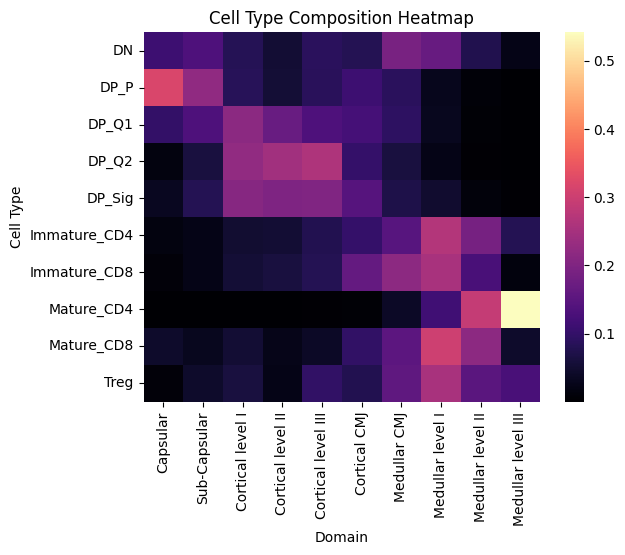

In [14]:
# Cell composition within each domain
exclude_celltypes = ['B', 'Dying', 'Erythrocyte', 'GD_T', 'Interferon_sig', 'Mature_cycling', 
                     'Myeloid', 'Neg_sel_1', 'Neg_sel_2', 'NKT']
hetero_df = hetero_df[~hetero_df['celltype'].isin(exclude_celltypes)]

import seaborn as sns
hetero_df_plt = hetero_df[hetero_df.domain!="NA"].pivot(index="domain", columns="celltype", values="count").fillna(0)
hetero_df_plt = hetero_df_plt.div(hetero_df_plt.sum(axis=0), axis=1)

# Define the desired order of domains
desired_order = [
    'Capsular', 'Sub-Capsular', 'Cortical level I', 
    'Cortical level II', 'Cortical level III', 
    'Cortical CMJ', 'Medullar CMJ', 
    'Medullar level I', 'Medullar level II', 
    'Medullar level III'
]

# Reindex to ensure the columns match the desired order
hetero_df_plt = hetero_df_plt.reindex(index=desired_order)

ax = sns.heatmap(hetero_df_plt.T, cmap="magma")
plt.title('Cell Type Composition Heatmap')  # 添加标题
plt.xlabel('Domain')  # 添加 x 轴标签
plt.ylabel('Cell Type')  # 添加 y 轴标签
plt.savefig(os.path.join(save_path, f"{data_name}_bin50_celltype_heatmap.pdf"), dpi = 600)
plt.show()

In [15]:
save_path

'/home/users/nus/changxu/scratch/section5/Results/A02677B5_cellbin_Dirac/20241015172805/Total/cell_distribution_bin50_bin100_to_cellbin'

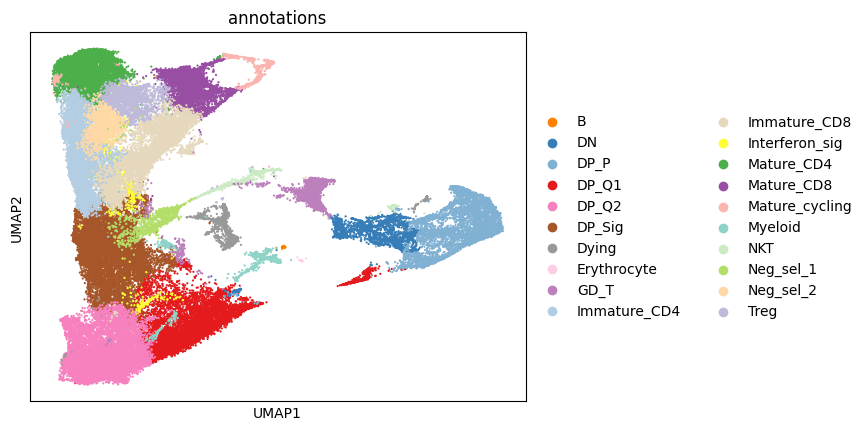

In [69]:
######### Single-cell data visualization
dp = sc.pl.umap(source_adata, color="annotations", palette=colormaps_clusters, size=10, return_fig=True)
dp.savefig(os.path.join(save_path, "cite_seq_annotation.pdf"), bbox_inches='tight', dpi=300)

In [70]:
target_adata

View of AnnData object with n_obs × n_vars = 137073 × 27445
    obs: 'dnbCount', 'area', 'total_counts', 'n_genes_by_counts', 'pct_counts_mt', 'orig.ident', 'x', 'y'
    var: 'n_cells', 'n_counts', 'mean_umi'
    uns: 'bin_size', 'bin_type', 'resolution', 'sn'
    obsm: 'cell_border', 'spatial'

In [71]:
source_adata

AnnData object with n_obs × n_vars = 71365 × 5125
    obs: 'batch_indices', 'percent_mito', 'n_counts', 'n_genes', 'n_protein_counts', 'n_proteins', 'batch', 'leiden_totalVI_res1.4', 'leiden_totalVI_res1.0', 'leiden_totalVI_res0.6', 'ADT_CD102_A0104_fore_prob', 'ADT_CD102_A0104', 'ADT_CD103_A0201_fore_prob', 'ADT_CD103_A0201', 'ADT_CD106_A0226_fore_prob', 'ADT_CD106_A0226', 'ADT_CD115(CSF-1R)_A0105_fore_prob', 'ADT_CD115(CSF-1R)_A0105', 'ADT_CD117(c-Kit)_A0012_fore_prob', 'ADT_CD117(c-Kit)_A0012', 'ADT_CD11a_A0595_fore_prob', 'ADT_CD11a_A0595', 'ADT_CD11c_A0106_fore_prob', 'ADT_CD11c_A0106', 'ADT_CD122(IL-2Rb)_A0227_fore_prob', 'ADT_CD122(IL-2Rb)_A0227', 'ADT_CD127(IL-7Ra)_A0198_fore_prob', 'ADT_CD127(IL-7Ra)_A0198', 'ADT_CD134(OX-40)_A0195_fore_prob', 'ADT_CD134(OX-40)_A0195', 'ADT_CD135_A0098_fore_prob', 'ADT_CD135_A0098', 'ADT_CD137_A0194_fore_prob', 'ADT_CD137_A0194', 'ADT_CD140a_A0573_fore_prob', 'ADT_CD140a_A0573', 'ADT_CD14_A0424_fore_prob', 'ADT_CD14_A0424', 'ADT_CD15(SSEA-1)_A

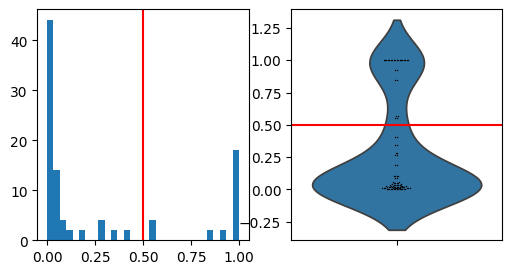

In [72]:
######### Explanation of Code for Trajectory Inference (PAGA)
import os
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns

save_path = "/home/users/nus/changxu/scratch/section5/Results/A02677B5_cellbin_Dirac/20241015153158/Total"

colors = ['#ff7f00ff','#377eb8ff','#80b1d3ff','#e41a1cff','#f781bfff','#a65628ff','#999999ff','#fccde5ff',
 '#bc80bdff','#b3cde3ff','#e5d8bdff','#ffff33ff','#4daf4aff','#984ea3ff','#fbb4aeff','#8dd3c7ff','#ccebc5ff',
 '#b3de69ff','#fed9a6ff','#bebadaff']

source_adata.uns['annotations_colors'] = colors

source_adata = source_adata[source_adata.obs["annotations"].isin(['DP_Q1', 'DN', 'Mature_CD4', 'Mature_CD8','DP_Sig','DP_Q2', 'Immature_CD8', 'Immature_CD4', 'Treg', 'DP_P'])]

sc.pp.neighbors(source_adata, use_rep="protein_expression")
sc.tl.paga(source_adata, groups="annotations")

# Distribution of PAGA connectivities for determining the cutting threshold
fig, axs = plt.subplots(1, 2, figsize=(6, 3))
paga_conn = source_adata.uns["paga"]["connectivities"].toarray().ravel()
a = axs[0].hist(paga_conn, bins=30)
sns.violinplot(paga_conn, ax=axs[1], inner=None)
sns.swarmplot(paga_conn, ax=axs[1], color="k", size=1)
thr = 0.5
_ = axs[1].axhline(thr, c="r")
_ = axs[0].axvline(thr, c="r")
fig.savefig(os.path.join(save_path, f"Single_cell_Prune_PAGA_edges.pdf"), bbox_inches='tight', dpi = 300)

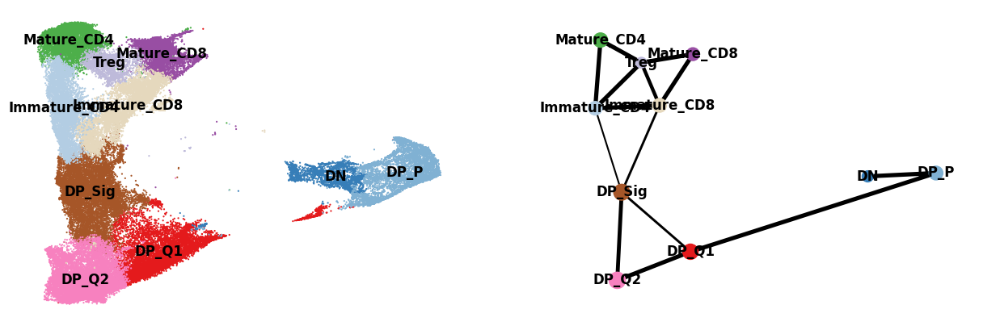

In [73]:
# colormaps_clusters = {'Myeloid': '#8DD3C7', 'DN': '#377EB8', 'DP_Q2': '#F781BF', 'Neg_sel_1': '#B3DE69', 
#  'Interferon_sig': '#FFFF33', 'Mature_CD4': '#4DAF4A', 'Immature_CD8': '#E5D8BD', 'DP_P': '#80B1D3', 
#  'Neg_sel_2': '#FED9A6', 'NKT': '#CCEBC5', 'GD_T': '#BC80BD', 'Mature_CD8': '#984EA3', 'DP_Q1': '#E41A1C', 
#  'Treg': '#BEBADA', 'B': '#FF7F00', 'Mature_cycling': '#FBB4AE', 'Erythrocyte': '#FCCDE5', 'DP_Sig': '#A65628', 
#  'Immature_CD4': '#B3CDE3', 'Dying': '#999999'}

# sc.pl.umap(source_adata, color="annotations", size=10, palette = colormaps_clusters)

# plt.savefig(os.path.join(save_path, f"Single_cell_background.pdf"), bbox_inches='tight', dpi = 300)

sc.pl.paga_compare(
    source_adata,
    threshold=0.4,
    title="",
    right_margin=0.2,
    size=10,
    edge_width_scale=0.5,
    legend_fontsize=12,
    fontsize=12,
    frameon=False,
    edges=False,
    save=False,
    show=False, 
)

plt.savefig(os.path.join(save_path, f"Single_cell_paga_compare.pdf"), bbox_inches='tight', dpi = 300)

plt.show()

# sc.pl.umap(source_adata, color="annotations", size=10, palette=['#808080'])

# plt.savefig(os.path.join(save_path, f"Single_cell_background.pdf"), bbox_inches='tight', dpi = 300)

### Step 2.2: ADT only

In [48]:
use_counts = "Protein"
common_features = list(set(source_adata_protein.var_names) & (set(target_adata_protein.var_names)))
source_adata_protein = source_adata_protein[:,common_features].copy()
target_adata_protein = target_adata_protein[:,common_features].copy()

source_adata_protein.obs[f"{use_obs_name}_num"] = source_adata_protein.obs[f"{use_obs_name}"].astype('category').cat.codes

save_path = os.path.join(results_path, f"{data_name}_{methods}", f"{now}", f"{use_counts}")
if not os.path.exists(save_path):
    os.makedirs(save_path)

source_adata_protein.obs["batch"] = "Source"
target_adata_protein.obs["batch"] = "Target"
pairs = dict(set(zip(source_adata_protein.obs[f"{use_obs_name}_num"], source_adata_protein.obs[f"{use_obs_name}"])))
source_label = source_adata_protein.obs[f"{use_obs_name}_num"].values
source_regions = source_adata_protein.obs["batch"].values
target_regions = target_adata_protein.obs["batch"].values

sc.pp.normalize_total(source_adata_protein, target_sum=1e4)
sc.pp.log1p(source_adata_protein)
sc.pp.scale(source_adata_protein)

sc.pp.normalize_total(target_adata_protein, target_sum=1e4)
sc.pp.log1p(target_adata_protein)
sc.pp.scale(target_adata_protein)

source_adata_protein.obsm["X_HVG"] = source_adata_protein.X
target_adata_protein.obsm["X_HVG"] = target_adata_protein.X

source_adata_protein.obsm["X_HVG"] = source_adata_protein.obsm["X_HVG"].astype("float32")
target_adata_protein.obsm["X_HVG"] = target_adata_protein.obsm["X_HVG"].astype("float32")


source_edge_index = sd.utils.get_multi_edge_index(source_adata_protein.X.copy(), source_adata.obs[f"{use_obs_name}"].copy(), n_neighbors = 10)
# source_edge_index = get_single_edge_index(source_adata.obsm["X_HVG"].copy(), n_neighbors = 16)
source_edge_index = torch.LongTensor(source_edge_index).T
target_adata_protein.obsm['spatial'] = target_adata_protein.obsm['spatial'].astype("float32")
target_edge_index = sd.utils.get_single_edge_index(target_adata_protein.obsm["spatial"].copy(), n_neighbors = 15)
target_edge_index = torch.LongTensor(target_edge_index).T

In [49]:
# Clear GPU memory
torch.cuda.empty_cache()
semisuper = sd.main.fit_semisupervised(save_path = save_path, use_gpu=True)
num_parts = 100
samples = semisuper._get_data(
                source_data = source_adata_protein.obsm["X_HVG"].copy(),
                source_label = source_label,
                source_edge_index = source_edge_index,
                target_data = target_adata_protein.obsm["X_HVG"].copy(),
                target_edge_index = target_edge_index,
                source_domain = np.zeros(source_adata_protein.shape[0]),
                target_domain = np.ones(target_adata_protein.shape[0]),
                num_parts_source = source_adata_total.shape[0] // 1024,
                num_parts_target = target_adata_total.shape[0] // 1024,
                weighted_classes = False,)

models = semisuper._get_model(samples=samples, opt_GNN = "SAGE")
results = semisuper._train_GCAN(samples=samples, models=models, n_epochs=50)
np.save(os.path.join(save_path, f"{data_name}_{methods}_Results.npy"), results)

Found 2 unique domains.


Computing METIS partitioning...
Done!
Computing METIS partitioning...
Done!
SpaGNNs..: 100%|█| 50/50 [01:04<00:00,  1.30s/it, Loss=5.6, Accu


Counter({'DP_Sig': 72931, 'GD_T': 31365, 'DP_Q2': 19328, 'DP_Q1': 5712, 'Immature_CD8': 1042, 'DP_P': 556, 'NKT': 265, 'DN': 249, 'Treg': 109, 'Neg_sel_1': 76, 'Neg_sel_2': 68, 'Myeloid': 65, 'Dying': 61, 'Immature_CD4': 55, 'Mature_CD4': 55, 'Mature_cycling': 34, 'Mature_CD8': 22, 'Interferon_sig': 18})


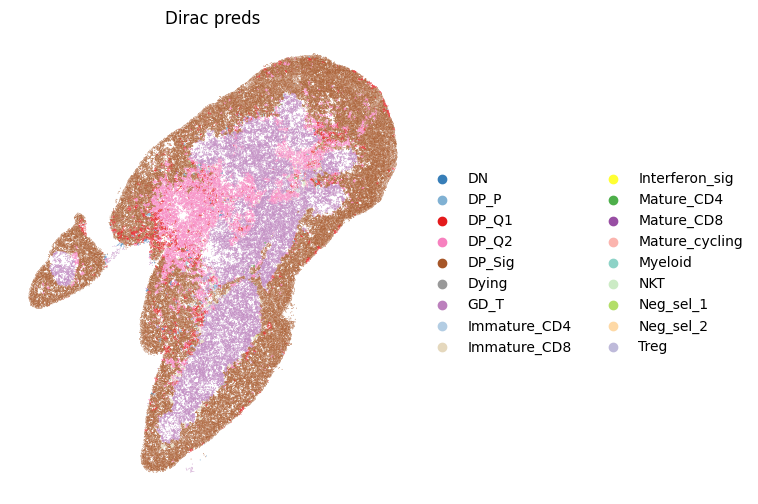

In [50]:
source_adata_protein.obsm[f"{methods}_embed"] = results["source_feat"]
target_adata_protein.obsm[f"{methods}_embed"] = results["target_feat"]
target_adata_protein.obs[f"{methods}_confs"] = results["target_confs"]
target_adata_protein.obs[f"{methods}_pred_num"] = results["target_pred"]
target_adata_protein.obs[f"{methods}_pred_clusters"] = target_adata_protein.obs[f"{methods}_pred_num"].map(pairs)
print(Counter(target_adata_protein.obs[f"{methods}_pred_clusters"]))

fig, ax = plt.subplots(figsize=(8, 6))
sc.pl.spatial(target_adata_protein, 
              color=[f"{methods}_pred_clusters"], 
              frameon=False, 
              spot_size=20, 
              title=["Dirac preds"], 
              palette = colormaps_clusters,
              ax=ax)
fig.savefig(os.path.join(save_path, f"{data_name}_cell_type.pdf"), bbox_inches='tight', dpi = 300)


# save_fig_path = os.path.join(save_path, "Single_cell_type")
# if not os.path.exists(save_fig_path):
#     os.makedirs(save_fig_path)

# for i in target_adata_protein.obs[f"{methods}_pred_clusters"].unique():
#     fig, ax = plt.subplots(figsize=(8, 6))
#     sc.pl.spatial(target_adata_protein, 
#                   color=[f"{methods}_pred_clusters"], 
#                   groups=[i], 
#                   frameon=False, 
#                   spot_size=20, 
#                   title=["Dirac preds"], 
#                   palette = colormaps_clusters,
#                   ax=ax,
#                  )
#     fig.savefig(os.path.join(save_fig_path, f"{data_name}_{i}.pdf"), bbox_inches='tight', dpi = 300)


In [51]:
save_path

'/home/users/nus/changxu/scratch/section5/Results/A02677B5_cellbin_Dirac/20241015172805/Protein'

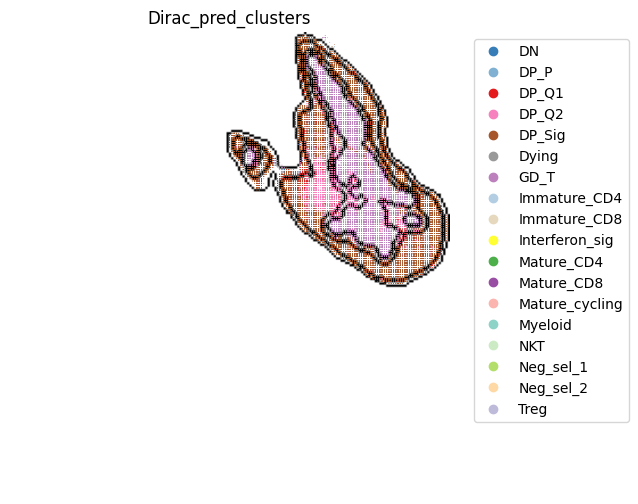

<Figure size 640x480 with 0 Axes>

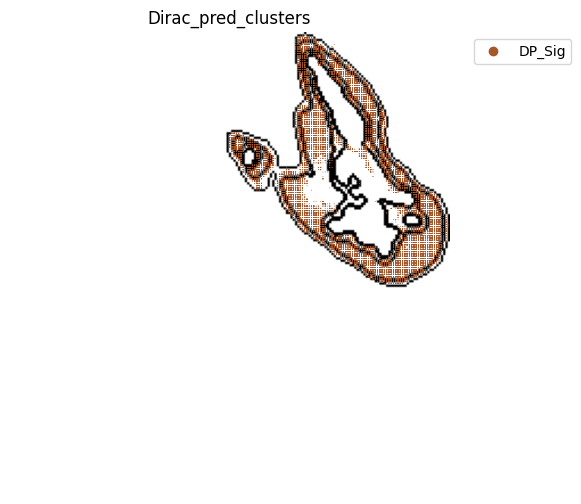

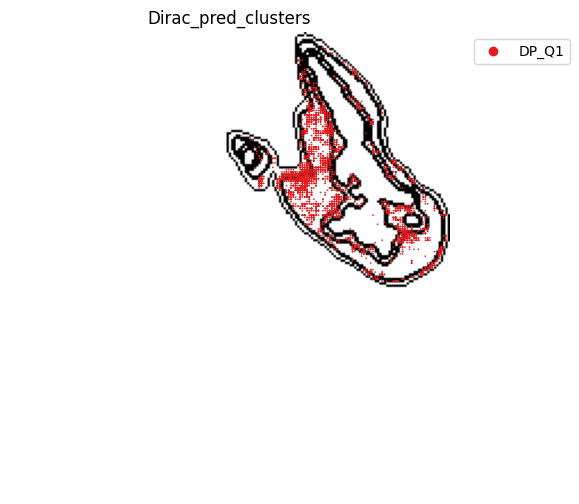

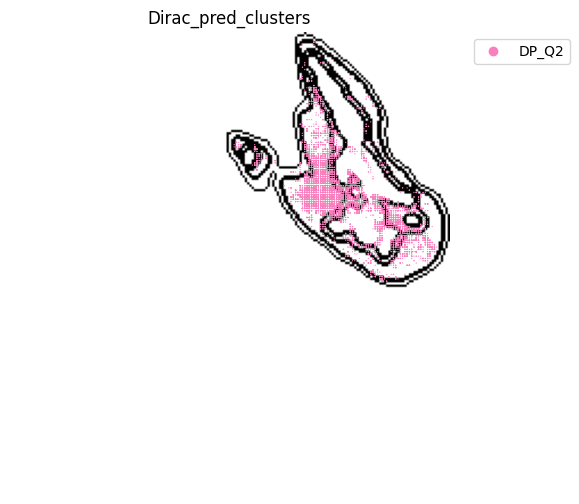

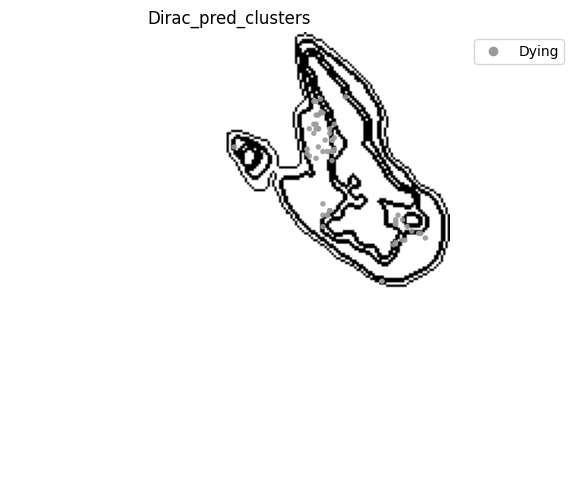

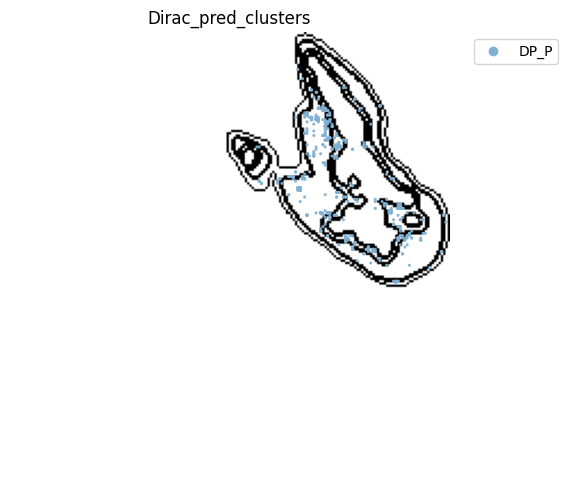

...

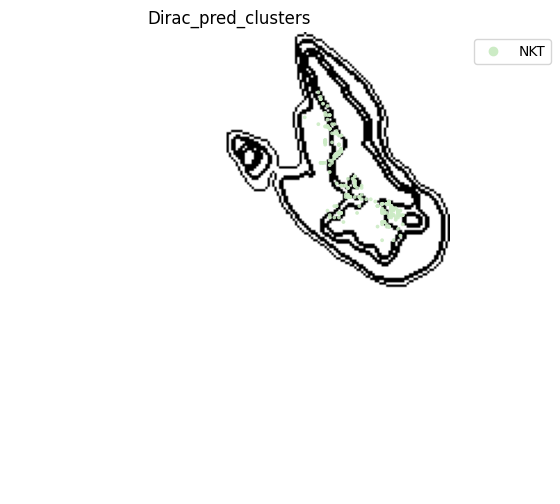

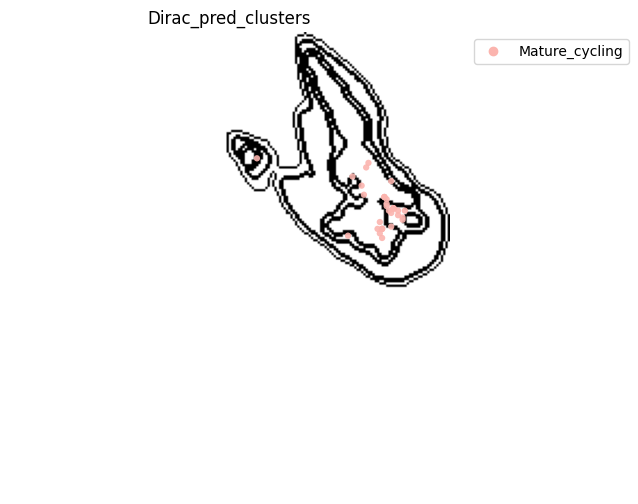

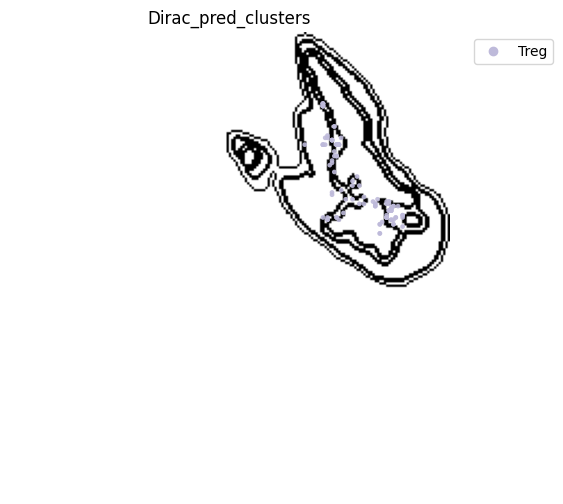

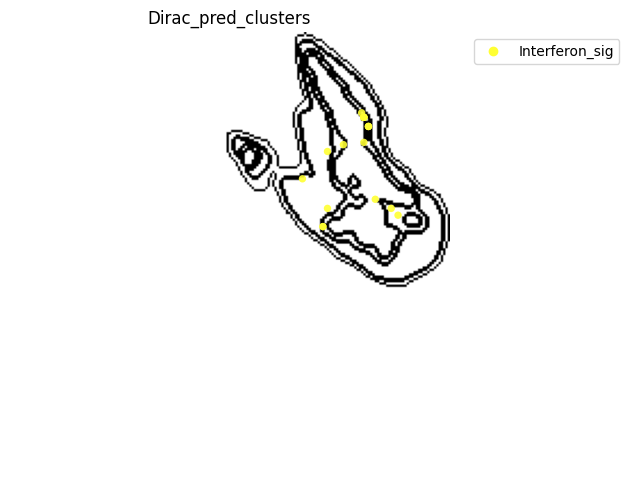

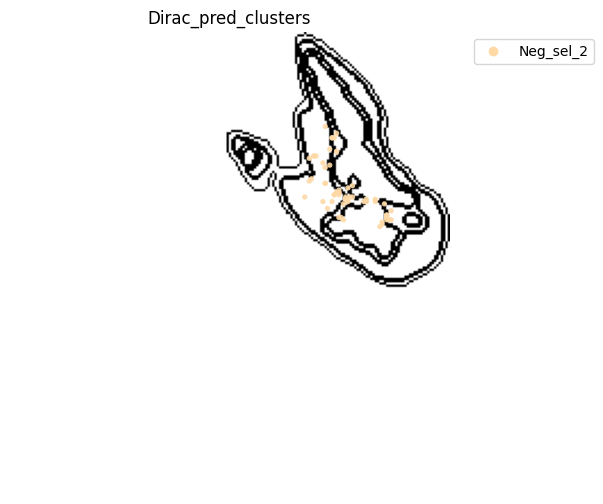

In [60]:
save_path = '/home/users/nus/changxu/scratch/section5/Results/A02677B5_cellbin_Dirac/20241015172805/Protein'

target_adata_protein.obsm['spatial_bin100'] = target_adata_protein.obsm['spatial'] // 100

target_adata_protein = st.io.read_image(
    target_adata_protein,
    filename=os.path.join("/home/users/nus/changxu/scratch/section5/Results/A02677B5_bin100_Dirac/20240923144826", "spatial_domains.png"),
    img_layer="layer1",
    slice="slice1",
    scale_factor=1,
)

target_adata_protein.uns["__type"] = "UMI"

fig, ax = plt.subplots(figsize=(8, 6))
st.pl.space(
    target_adata_protein,
    space="spatial_bin100",
    color=["Dirac_pred_clusters"],
    alpha=0.9,
    figsize=(5, 3),
    show_legend="upper left",
    img_layers = "layer1",
    slices="slice1",
    dpi=300, 
    pointsize=0.03,
    color_key = colormaps_clusters,
    ax=ax,
)
plt.tight_layout()
plt.show() 
fig.savefig(os.path.join(save_path, f"{data_name}_{methods}_cell_type_outlines.png"), dpi = 600)



save_fig_path = os.path.join(save_path, "Single_cell_type_outline")
if not os.path.exists(save_fig_path):
    os.makedirs(save_fig_path)

for i in target_adata_protein.obs[f"{methods}_pred_clusters"].unique():
    fig, ax = plt.subplots(figsize=(8, 6))
    st.pl.space(
        target_adata_protein[target_adata_protein.obs[f"{methods}_pred_clusters"].isin([i])],
        space = "spatial_bin100",
        color = ["Dirac_pred_clusters"],
        alpha = 0.9,
        figsize = (5, 3),
        show_legend = "upper left",
        img_layers = "layer1",
        slices="slice1",
        dpi=300, 
        pointsize=0.03,
        color_key = colormaps_clusters,
        ax=ax)
    fig.savefig(os.path.join(save_fig_path, f"{data_name}_{i}.png"), dpi = 600)

######### save data
target_adata_protein.write(os.path.join(save_path, f"{data_name}_{methods}_{use_counts}_target.h5ad"), compression="gzip")
target_adata_protein.write(os.path.join(save_path, f"{data_name}_{methods}_{use_counts}_source.h5ad"), compression="gzip")

### Step 2.3: Only RNA

In [53]:
use_counts = "RNA"

common_genes = list(set(source_adata.var_names) & (set(target_adata.var_names)))
source_adata = source_adata[:,common_genes].copy()
target_adata = target_adata[:,common_genes].copy()

source_adata.obs[f"{use_obs_name}_num"] = source_adata.obs[f"{use_obs_name}"].astype('category').cat.codes

save_path = os.path.join(results_path, f"{data_name}_{methods}", f"{now}", f"{use_counts}")
if not os.path.exists(save_path):
    os.makedirs(save_path)

source_adata.obs["batch"] = "Source"
target_adata.obs["batch"] = "Target"
pairs = dict(set(zip(source_adata.obs[f"{use_obs_name}_num"], source_adata.obs[f"{use_obs_name}"])))
source_label = source_adata.obs[f"{use_obs_name}_num"].values
source_regions = source_adata.obs["batch"].values
target_regions = target_adata.obs["batch"].values

sc.pp.normalize_total(source_adata, target_sum=1e4)
sc.pp.log1p(source_adata)
sc.pp.scale(source_adata)
sc.pp.pca(source_adata)

sc.pp.normalize_total(target_adata, target_sum=1e4)
sc.pp.log1p(target_adata)
sc.pp.scale(target_adata)

source_adata.obsm["X_HVG"] = source_adata.X
target_adata.obsm["X_HVG"] = target_adata.X

source_adata.obsm["X_HVG"] = source_adata.obsm["X_HVG"].astype("float32")
target_adata.obsm["X_HVG"] = target_adata.obsm["X_HVG"].astype("float32")

source_edge_index = sd.utils.get_multi_edge_index(source_adata.obsm["X_pca"].copy(), source_adata.obs[f"{use_obs_name}"].copy(), n_neighbors = 15)
# source_edge_index = get_single_edge_index(source_adata.obsm["X_HVG"].copy(), n_neighbors = 16)
source_edge_index = torch.LongTensor(source_edge_index).T
target_adata.obsm['spatial']  =  target_adata.obsm['spatial'].astype("float32")
target_edge_index = sd.utils.get_single_edge_index(target_adata.obsm["spatial"].copy(), n_neighbors = 15)
target_edge_index = torch.LongTensor(target_edge_index).T

In [54]:
# Clear GPU memory
torch.cuda.empty_cache()
semisuper = sd.main.fit_semisupervised(save_path = save_path, use_gpu=True)
num_parts = 200
samples = semisuper._get_data(
                source_data = source_adata.obsm["X_HVG"].copy(),
                source_label = source_label,
                source_edge_index = source_edge_index,
                target_data = target_adata.obsm["X_HVG"].copy(),
                target_edge_index = target_edge_index,
                source_domain = np.zeros(source_adata.shape[0]),
                target_domain = np.ones(target_adata.shape[0]),
                num_parts_source = num_parts,
                num_parts_target = num_parts,
                weighted_classes = False,)

models = semisuper._get_model(samples=samples, opt_GNN = "SAGE")
results = semisuper._train_GCAN(samples=samples, models=models, n_epochs=50)
np.save(os.path.join(save_path, f"{data_name}_{methods}_Results.npy"), results)

Found 2 unique domains.


Computing METIS partitioning...
Done!
Computing METIS partitioning...
Done!
SpaGNNs..: 100%|█| 50/50 [03:45<00:00,  4.51s/it, Loss=2.43, Acc


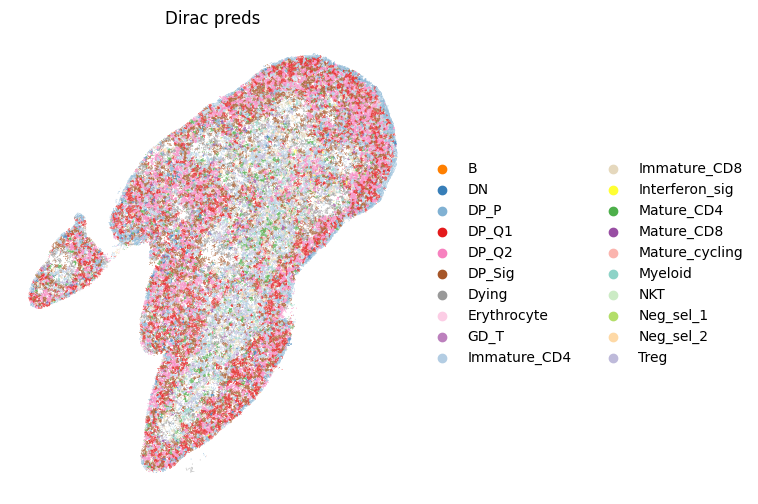

In [55]:
source_adata.obsm[f"{methods}_embed"] = results["source_feat"]
target_adata.obsm[f"{methods}_embed"] = results["target_feat"]
target_adata.obs[f"{methods}_confs"] = results["target_confs"]
target_adata.obs[f"{methods}_pred_num"] = results["target_pred"]
target_adata.obs[f"{methods}_pred_clusters"] = target_adata.obs[f"{methods}_pred_num"].map(pairs)
Counter(target_adata.obs[f"{methods}_pred_clusters"])

fig, ax = plt.subplots(figsize=(8, 6))

sc.pl.spatial(target_adata, 
              color=[f"{methods}_pred_clusters"], 
              frameon=False, 
              spot_size=20, 
              title=["Dirac preds"],
              img_key = None,
              palette = colormaps_clusters,
              ax=ax)
fig.savefig(os.path.join(save_path, f"{data_name}_cell_type.pdf"), bbox_inches='tight', dpi = 300)


# save_fig_path = os.path.join(save_path, "Single_cell_type")
# if not os.path.exists(save_fig_path):
#     os.makedirs(save_fig_path)

# for i in target_adata.obs[f"{methods}_pred_clusters"].unique():
#     fig, ax = plt.subplots(figsize=(8, 6))
#     sc.pl.spatial(target_adata, 
#                   color=[f"{methods}_pred_clusters"], 
#                   groups=[i], 
#                   frameon=False, 
#                   spot_size=20, 
#                   title=["Dirac preds"], 
#                   palette = colormaps_clusters,
#                   img_key = None,
#                   ax=ax,
#                  )
#     fig.savefig(os.path.join(save_fig_path, f"{data_name}_{i}.pdf"), bbox_inches='tight', dpi = 300)

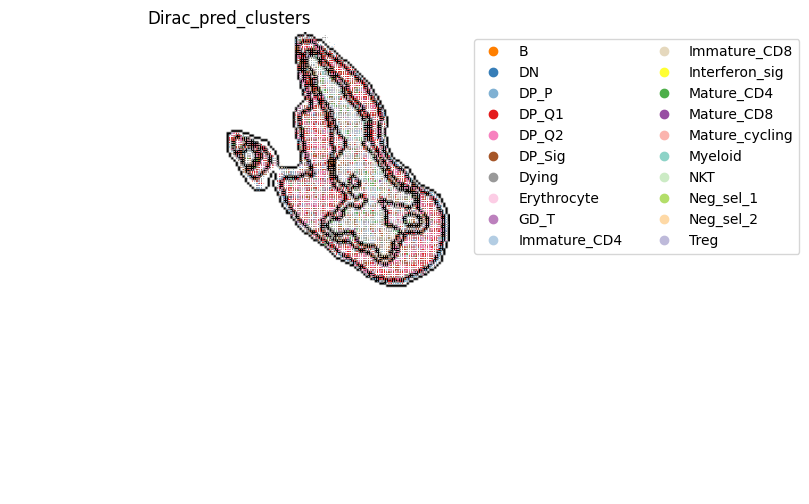

<Figure size 640x480 with 0 Axes>

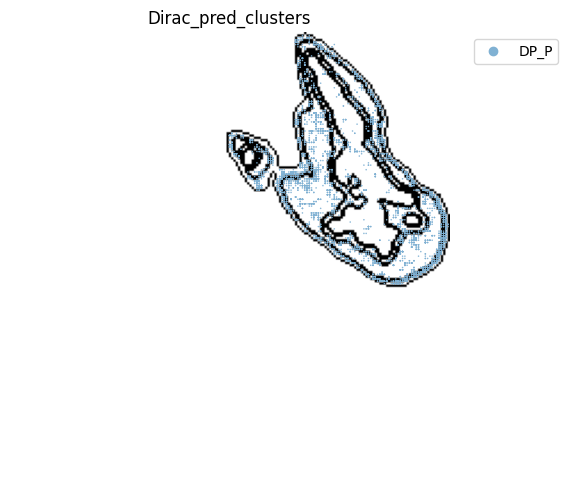

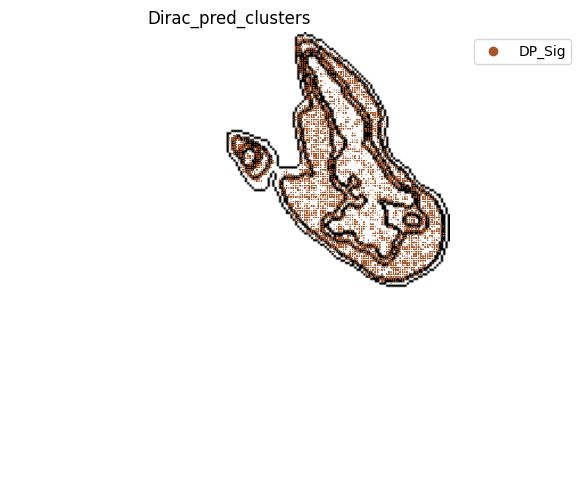

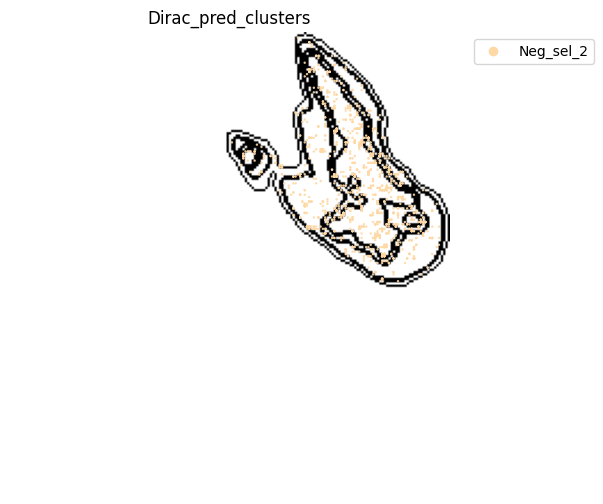

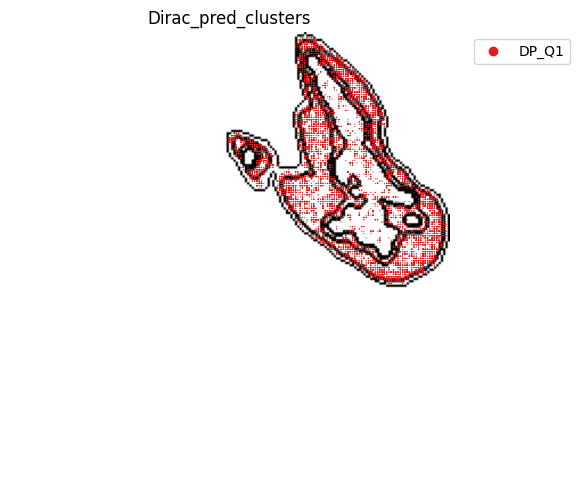

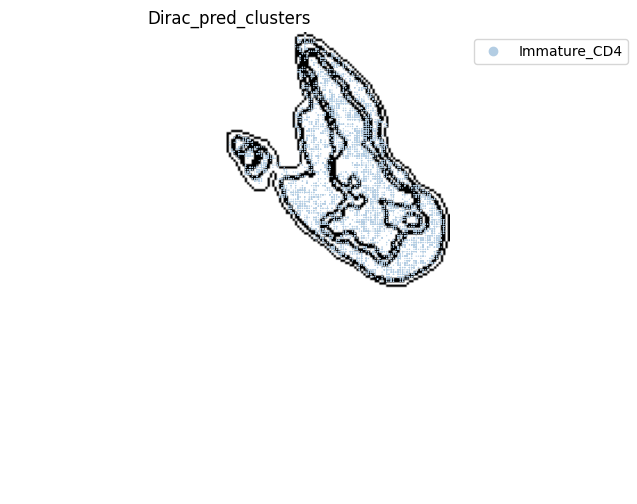

...

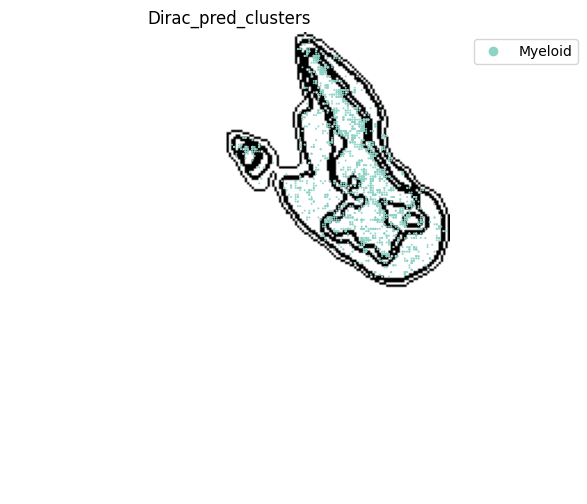

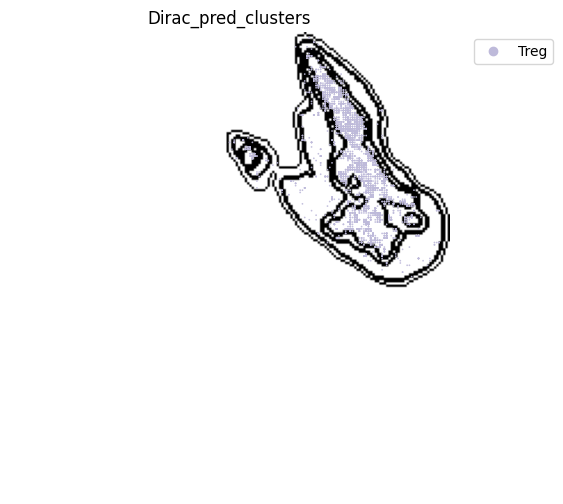

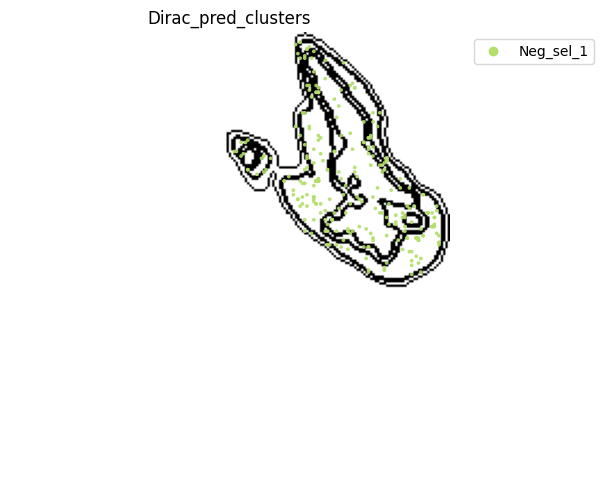

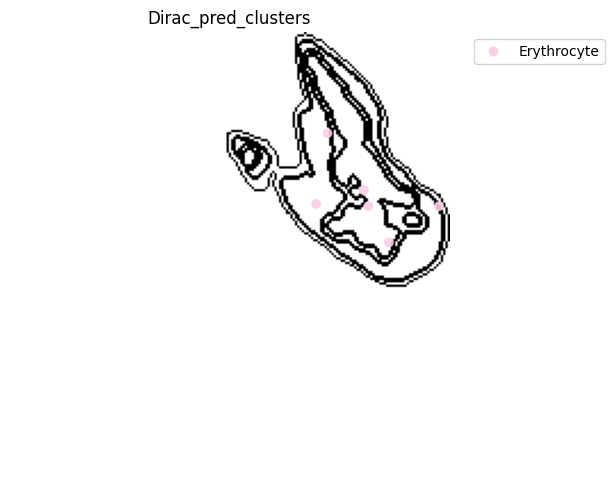

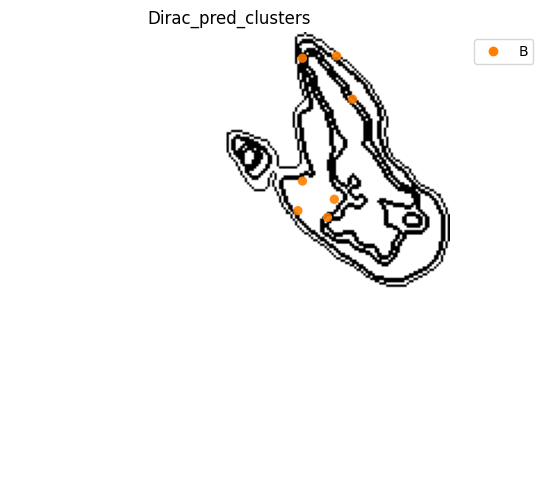

In [62]:
save_path = '/home/users/nus/changxu/scratch/section5/Results/A02677B5_cellbin_Dirac/20241015172805/RNA'

target_adata.obsm['spatial_bin100'] = target_adata.obsm['spatial'] // 100

target_adata = st.io.read_image(
    target_adata,
    filename=os.path.join("/home/users/nus/changxu/scratch/section5/Results/A02677B5_bin100_Dirac/20240923144826", "spatial_domains.png"),
    img_layer="layer1",
    slice="slice1",
    scale_factor=1,
)

target_adata.uns["__type"] = "UMI"

fig, ax = plt.subplots(figsize=(8, 6))
st.pl.space(
    target_adata,
    space="spatial_bin100",
    color=["Dirac_pred_clusters"],
    alpha=0.9,
    figsize=(5, 3),
    show_legend="upper left",
    img_layers = "layer1",
    slices="slice1",
    dpi=300, 
    pointsize=0.03,
    color_key = colormaps_clusters,
    ax=ax,
)
plt.tight_layout()
plt.show() 
fig.savefig(os.path.join(save_path, f"{data_name}_{methods}_cell_type_outlines.png"), dpi = 600)



save_fig_path = os.path.join(save_path, "Single_cell_type_outline")
if not os.path.exists(save_fig_path):
    os.makedirs(save_fig_path)

for i in target_adata.obs[f"{methods}_pred_clusters"].unique():
    fig, ax = plt.subplots(figsize=(8, 6))
    st.pl.space(
        target_adata[target_adata.obs[f"{methods}_pred_clusters"].isin([i])],
        space = "spatial_bin100",
        color = ["Dirac_pred_clusters"],
        alpha = 0.9,
        figsize = (5, 3),
        show_legend = "upper left",
        img_layers = "layer1",
        slices="slice1",
        dpi=300, 
        pointsize=0.03,
        color_key = colormaps_clusters,
        ax=ax)
    fig.savefig(os.path.join(save_fig_path, f"{data_name}_{i}.png"), dpi = 600)

######### save data
target_adata.write(os.path.join(save_path, f"{data_name}_{methods}_{use_counts}_target.h5ad"), compression="gzip")
target_adata.write(os.path.join(save_path, f"{data_name}_{methods}_{use_counts}_source.h5ad"), compression="gzip")

In [57]:
save_path

'/home/users/nus/changxu/scratch/section5/Results/A02677B5_cellbin_Dirac/20241015172805/RNA'

In [58]:
now

'20241015172805'

In [1]:
# Summary domain-cell relationship
# domain_list = np.array([])
# celltype_list = np.array([])
# count_list = np.array([])
# for i in np.unique(target_adata.obs["region_domain"]):
#     tmp, counts = np.unique(target_adata_total[target_adata.obs["region_domain"] == i,:].obs[f"{methods}_pred_clusters"], return_counts=True)
#     domain_list = np.append(domain_list, np.repeat(i, len(counts)))
#     celltype_list = np.append(celltype_list, tmp)
#     count_list = np.append(count_list, counts)
# hetero_df = pd.DataFrame({"domain":domain_list, "celltype":celltype_list, "count":count_list.astype(int)})

# hetero_df[0:10]

In [2]:
# # Cell distribution among domains
# spec_df_plt = hetero_df.pivot(index="celltype", columns="domain", values="count").fillna(0)
# spec_df_plt = spec_df_plt.div(spec_df_plt.sum(axis=1), axis=0)

# spec_df_plt['Celltype'] = spec_df_plt.index
# spec_df_plt.index = pd.CategoricalIndex(spec_df_plt.index, categories=spec_df_plt.index.astype(str).sort_values())
# spec_df_plt = spec_df_plt.sort_index(ascending=False)

# spec_df_plt.plot(
#     x = 'Celltype',
#     kind = 'barh',
#     stacked = True,
#     title = 'Stacked Bar Graph',
#     mark_right = True,
#     figsize=(4, 4),
#     legend = False,
#     color = cluster2colors,
# )

In [3]:
# # Cell composition within each domain
# import seaborn as sns
# hetero_df_plt = hetero_df[hetero_df.domain!="NA"].pivot(index="domain", columns="celltype", values="count").fillna(0)
# hetero_df_plt = hetero_df_plt.div(hetero_df_plt.sum(axis=1), axis=0)

# sns.heatmap(hetero_df_plt.T)

## Step 3: Comparison of cell proportions, including CITE-seq, Stereo-CITE-seq (Joint, Only RNA, Only Protein)

In [1]:
import os
import scanpy as sc
now = '20241015172805'

save_path = f"/home/users/nus/changxu/scratch/section5/Results/A02677B5_cellbin_Dirac/{now}"
source_adata_total = sc.read(os.path.join(save_path, "Total", "A02677B5_cellbin_Dirac_Total_source.h5ad"))
target_adata_total = sc.read(os.path.join(save_path, "Total", "A02677B5_cellbin_Dirac_Total_target.h5ad"))
target_adata_RNA = sc.read(os.path.join(save_path, "RNA", "A02677B5_cellbin_Dirac_RNA_target.h5ad"))
target_adata_protein = sc.read(os.path.join(save_path, "Protein", "A02677B5_cellbin_Dirac_Protein_target.h5ad"))

In [2]:
target_adata_total

AnnData object with n_obs × n_vars = 132011 × 5054
    obs: 'batch', 'Dirac_confs', 'Dirac_pred_num', 'Dirac_pred_clusters'
    var: 'mean', 'std'
    uns: 'Dirac_pred_clusters_colors', '__type', 'log1p', 'spatial'
    obsm: 'Dirac_embed', 'X_HVG', 'X_spatial_bin100', 'spatial', 'spatial_bin100'

In [3]:
colormaps_clusters = target_adata_total.uns['Dirac_pred_clusters_colors']

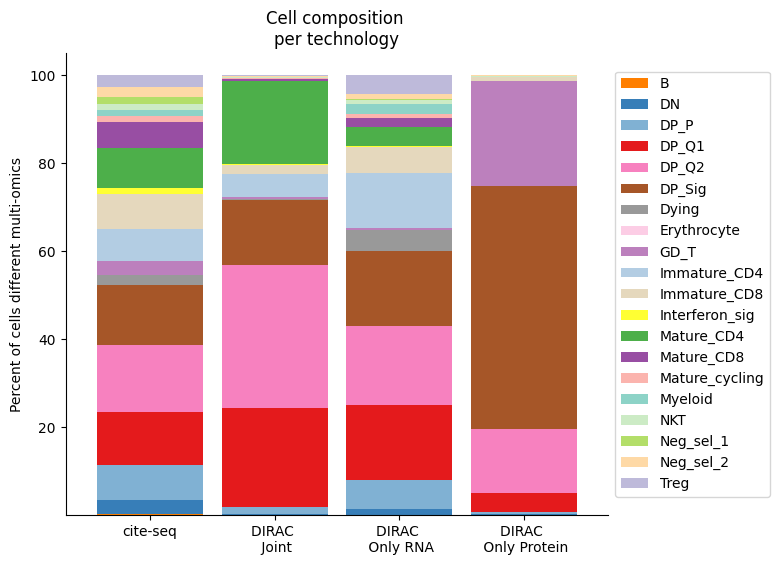

In [4]:
import seaborn as sns
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Get cluster labels
source_spleen_clusters = pd.Series(source_adata_total.obs["annotations"].values)
target_spleen_clusters_total = pd.Series(target_adata_total.obs["Dirac_pred_clusters"].values)
target_spleen_clusters_RNA = pd.Series(target_adata_RNA.obs["Dirac_pred_clusters"].values)
target_spleen_clusters_Protein = pd.Series(target_adata_protein.obs["Dirac_pred_clusters"].values)

colormaps_clusters = target_adata_total.uns['Dirac_pred_clusters_colors']

# Calculate cluster composition (cells as a percent of total in that tissue)
source_spleen_comp = source_spleen_clusters.value_counts()/np.sum(source_spleen_clusters.value_counts())*100
target_spleen_comp_total = target_spleen_clusters_total.value_counts()/np.sum(target_spleen_clusters_total.value_counts())*100
target_spleen_comp_RNA = target_spleen_clusters_RNA.value_counts()/np.sum(target_spleen_clusters_RNA.value_counts())*100
target_spleen_comp_Protein = target_spleen_clusters_Protein.value_counts()/np.sum(target_spleen_clusters_Protein.value_counts())*100

# Make data frame of composition

composition_df = np.transpose(pd.DataFrame({"cite-seq":source_spleen_comp, 
                                            "DIRAC \n Joint": target_spleen_comp_total, 
                                            "DIRAC \n Only RNA": target_spleen_comp_RNA,
                                            "DIRAC \n Only Protein": target_spleen_comp_Protein,
                                           }))
composition_df

# Plot tissue composition as stacked bar chart

fig, ax = plt.subplots(figsize=(7, 6)) # 5,8

composition_df.plot.bar(stacked = True, ax = ax, width = 0.85, color=colormaps_clusters),
plt.ylabel("Percent of cells different multi-omics")
plt.title("Cell composition \nper technology")
ax.legend(bbox_to_anchor = (1, 0.5), loc = "center left") # move legend to outside of plot
plt.xticks(rotation = 0)
sns.despine()

fig.savefig(os.path.join(save_path, "allcell_composition_per_tissue_including_Protein_RNA_joint.pdf"), dpi=300, bbox_inches='tight')

In [22]:
clusters

Index(['cite-seq', 'DIRAC \n Joint'], dtype='object')

In [5]:
colormaps_clusters

{'B': '#ff7f00',
 'DN': '#377eb8',
 'DP_P': '#80b1d3',
 'DP_Q1': '#e41a1c',
 'DP_Q2': '#f781bf',
 'DP_Sig': '#a65628',
 'Dying': '#999999',
 'Erythrocyte': '#fccde5',
 'GD_T': '#bc80bd',
 'Immature_CD4': '#b3cde3',
 'Immature_CD8': '#e5d8bd',
 'Interferon_sig': '#ffff33',
 'Mature_CD4': '#4daf4a',
 'Mature_CD8': '#984ea3',
 'Mature_cycling': '#fbb4ae',
 'Myeloid': '#8dd3c7',
 'NKT': '#ccebc5',
 'Neg_sel_1': '#b3de69',
 'Neg_sel_2': '#fed9a6',
 'Treg': '#bebada'}

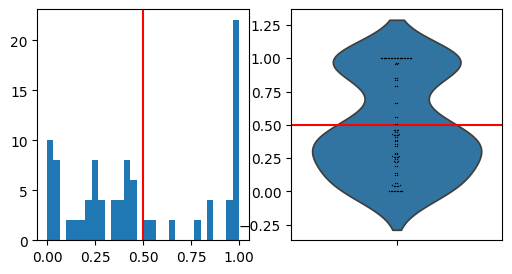

In [15]:
######## Perform PAGA on the total dataset, focusing on specific cell types
import os
# import stereo as st
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns

# Define the list of target T cell clusters
Tcell_clust_onevall = ['DP_Q2', 'DP_Sig', 'Immature_CD4', 'DP_Q1', 'DP_P',
                       'Immature_CD8','Mature_CD8','Treg','Mature_CD4', 'DN']

# Filter the target data to only include the specified T cell clusters
target_adata_T = target_adata_total[target_adata_total.obs["Dirac_pred_clusters"].isin(Tcell_clust_onevall)]

# Perform PCA preprocessing (commented out)
# sc.pp.pca(target_adata_T)

# Compute the neighborhood graph using Dirac embeddings
sc.pp.neighbors(target_adata_T, use_rep="Dirac_embed", n_neighbors=30)

# Perform UMAP to reduce dimensionality
sc.tl.umap(target_adata_T)

# Perform PAGA to infer cell trajectories
sc.tl.paga(target_adata_T, groups="Dirac_pred_clusters")

# Distribution of PAGA connectivities for determining the cutting threshold
fig, axs = plt.subplots(1, 2, figsize=(6, 3))
paga_conn = target_adata_T.uns["paga"]["connectivities"].toarray().ravel()

# Plot the histogram and violin plot to visualize the PAGA connectivities
a = axs[0].hist(paga_conn, bins=30)
sns.violinplot(paga_conn, ax=axs[1], inner=None)
sns.swarmplot(paga_conn, ax=axs[1], color="k", size=1)

# Set the threshold for pruning PAGA edges
thr = 0.5

# Add vertical and horizontal lines at the threshold
_ = axs[1].axhline(thr, c="r")
_ = axs[0].axvline(thr, c="r")

# Save the figure showing the pruning of PAGA edges
fig.savefig(os.path.join(save_path, f"Prune_PAGA_edges_T.pdf"), bbox_inches='tight', dpi = 300)


In [16]:
target_adata_T.uns["Dirac_pred_clusters_colors"]

array(['#377eb8', '#80b1d3', '#e41a1c', '#f781bf', '#a65628', '#b3cde3',
       '#e5d8bd', '#4daf4a', '#984ea3', '#bebada'], dtype='<U7')

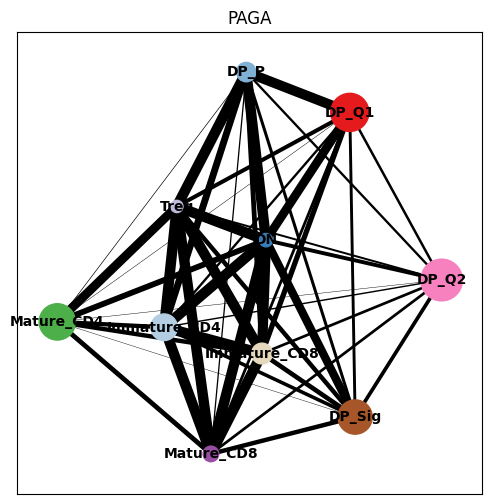

In [17]:
# Compare UMAP and PAGA layouts
fig, axs = plt.subplots(1, 1, figsize=(6, 6))
sc.pl.paga(target_adata_T, ax=axs, title="PAGA", node_size_scale=2, edge_width_scale=1)
fig.savefig(os.path.join(save_path, f"PAGA_edges_T.pdf"), bbox_inches='tight', dpi = 300)

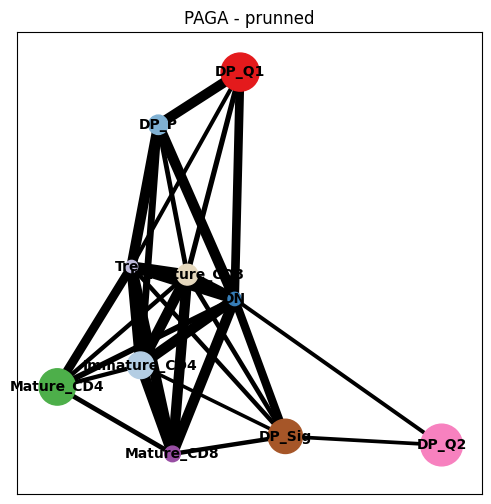

In [19]:
thr = 0.3
# Compare UMAP and PAGA layouts
fig, axs = plt.subplots(1, 1, figsize=(6, 6))
sc.pl.paga(target_adata_T, ax=axs, title="PAGA - prunned", threshold=thr, node_size_scale=2, edge_width_scale=1)
fig.savefig(os.path.join(save_path, f"PAGA_edges_prunned_T.pdf"), bbox_inches='tight', dpi = 300)

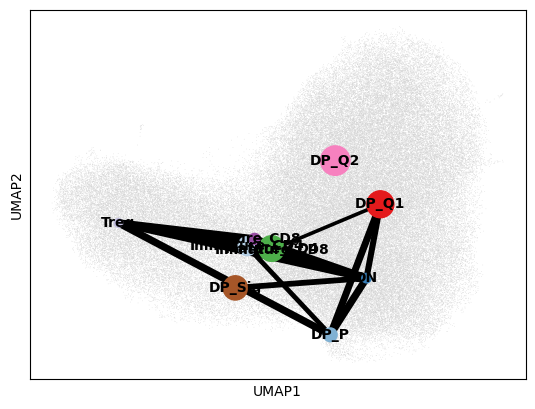

<Figure size 640x480 with 0 Axes>

In [21]:
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde

# Define a function to obtain the KDE center for each group
def kde_center(data):
    kde = gaussian_kde(data.T)  # Compute Kernel Density Estimate
    density = kde(data.T)  # Evaluate the density
    center_idx = density.argmax()  # Find the index of the highest density
    return data[center_idx]  # Return the coordinates corresponding to the center

# Create a DataFrame to store UMAP coordinates and group labels
pos = pd.DataFrame(target_adata_T.obsm["X_umap"], index=target_adata_T.obs_names)
pos["group"] = target_adata_T.obs[target_adata_T.uns["paga"]["groups"]]

# For each group, calculate the Kernel Density Estimate center
kde_pos = pos.groupby("group", observed=True).apply(lambda df: pd.Series(kde_center(df.values[:, :2])))

# Convert the DataFrame to a numpy array
kde_pos = kde_pos.values

# Plot UMAP background
ax = sc.pl.umap(target_adata_T, show=False)

# Plot PAGA
sc.pl.paga(
    target_adata_T,
    color='Dirac_pred_clusters',
    threshold=thr,  # Use the threshold for pruning PAGA edges
    node_size_scale=1,
    edge_width_scale=0.7,
    pos=kde_pos,  # Use KDE-based node positions
    random_state=0,
    ax=ax,
)

# Display the plot
plt.show()

# Save the figure showing the pruned PAGA edges on UMAP with KDE-based node positions
plt.savefig(os.path.join(save_path, f"PAGA_edges_prunned_T_UMAP_kde.pdf"), bbox_inches='tight', dpi = 300)


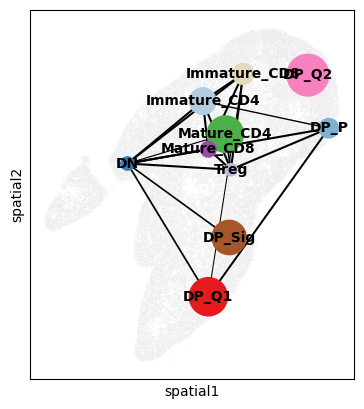

In [22]:
# Define a function to obtain the KDE center for each group
def kde_center(data):
    kde = gaussian_kde(data.T)  # Compute Kernel Density Estimate
    density = kde(data.T)  # Evaluate the density
    center_idx = density.argmax()  # Find the index of the highest density
    return data[center_idx]  # Return the coordinates corresponding to the center

# Create a DataFrame to store spatial coordinates and group labels
pos = pd.DataFrame(target_adata_T.obsm["spatial"], index=target_adata_T.obs_names)
pos["group"] = target_adata_T.obs[target_adata_T.uns["paga"]["groups"]]

# For each group, calculate the Kernel Density Estimate center
kde_pos = pos.groupby("group", observed=True).apply(lambda df: pd.Series(kde_center(df.values[:, :2])))

# Convert the DataFrame to a numpy array
kde_pos = kde_pos.values

# Plot the spatial background
ax = sc.pl.spatial(target_adata_T, show=False, img_key=None, spot_size=10)

# Plot PAGA
sc.pl.paga(
    target_adata_T,
    color='Dirac_pred_clusters',
    threshold=thr,  # Use the threshold for pruning PAGA edges
    node_size_scale=2,
    edge_width_scale=0.2,
    pos=kde_pos,  # Use KDE-based node positions
    random_state=0,
    ax=ax,
    show=False,
)

# Save the figure
plt.savefig(os.path.join(save_path, "PAGA_edges_prunned_T_spatial_kde.pdf"), bbox_inches='tight', dpi=300)
plt.show()


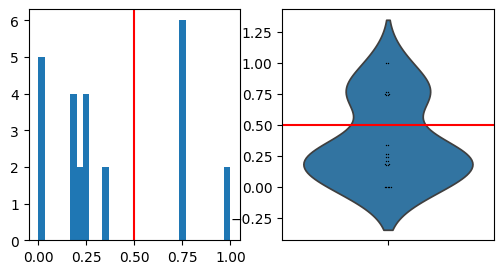

In [23]:
Tcell_clust_onevall = ['DP_Q2', 'DP_Sig', 'DP_Q1', 'DP_P', 'DN']  # Define the subset of T cell clusters

# Subset the target dataset based on the selected T cell clusters
sub_target_adata_T = target_adata_total[target_adata_total.obs["Dirac_pred_clusters"].isin(Tcell_clust_onevall)]

# sc.pp.pca(target_adata_T)  # Optional PCA (not used here)
sc.pp.neighbors(sub_target_adata_T, use_rep="Dirac_embed", n_neighbors=30)  # Calculate neighbors using the Dirac embedding
sc.tl.umap(sub_target_adata_T)  # Compute UMAP
sc.tl.paga(sub_target_adata_T, groups="Dirac_pred_clusters")  # Compute PAGA for the defined clusters

# Distribution of PAGA connectivities for determining the cutting threshold
fig, axs = plt.subplots(1, 2, figsize=(6, 3))
paga_conn = sub_target_adata_T.uns["paga"]["connectivities"].toarray().ravel()  # Get the connectivity values from PAGA
a = axs[0].hist(paga_conn, bins=30)  # Histogram of the PAGA connectivity values
sns.violinplot(paga_conn, ax=axs[1], inner=None)  # Violin plot for PAGA connectivity distribution
sns.swarmplot(paga_conn, ax=axs[1], color="k", size=1)  # Add swarmplot to visualize individual connectivity values
thr = 0.5  # Set the threshold for pruning edges
_ = axs[1].axhline(thr, c="r")  # Mark threshold with a horizontal line
_ = axs[0].axvline(thr, c="r")  # Mark threshold with a vertical line
fig.savefig(os.path.join(save_path, f"Prune_PAGA_edges_T_no_CD4_8.pdf"), bbox_inches='tight', dpi=300)  # Save the plot


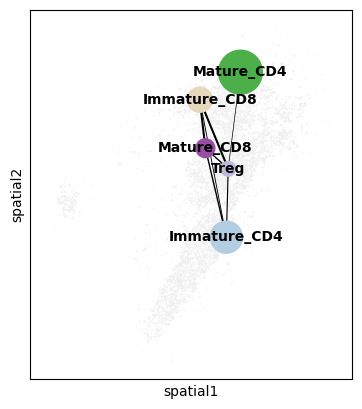

In [26]:
# Define function to obtain the kernel density estimate center for each group
def kde_center(data):
    kde = gaussian_kde(data.T)  # Compute the kernel density estimate
    density = kde(data.T)  # Get the density values
    center_idx = density.argmax()  # Find the index with the maximum density
    return data[center_idx]  # Return the corresponding data point (center)

# Create DataFrame to store UMAP coordinates and group labels
pos = pd.DataFrame(sub_target_adata_T.obsm["spatial"], index=sub_target_adata_T.obs_names)
pos["group"] = sub_target_adata_T.obs['Dirac_pred_clusters']  # Assign cluster labels

# Compute the kernel density estimate center for each group
kde_pos = pos.groupby("group", observed=True).apply(lambda df: pd.Series(kde_center(df.values[:, :2])))

# Convert the DataFrame to a numpy array
kde_pos = kde_pos.values

# Plot UMAP background
ax = sc.pl.spatial(sub_target_adata_T, show=False, img_key=None, spot_size=10)

# Plot PAGA
sc.pl.paga(
    sub_target_adata_T,
    color='Dirac_pred_clusters',  # Color by clusters
    threshold=0.2,  # Set the threshold for pruning edges
    node_size_scale=2,  # Scale the node size
    edge_width_scale=0.2,  # Scale the edge width
    pos=kde_pos,  # Use the KDE positions for the nodes
    random_state=0,  # Fix the random state for reproducibility
    ax=ax,  # Plot on the provided axis
    show=False,  # Do not show the plot immediately
)

# Save the figure
plt.savefig(os.path.join(save_path, "PAGA_edges_prunned_T_spatial_kde_no_CD4_8.pdf"), bbox_inches='tight', dpi=300)
plt.show()  # Display the plot

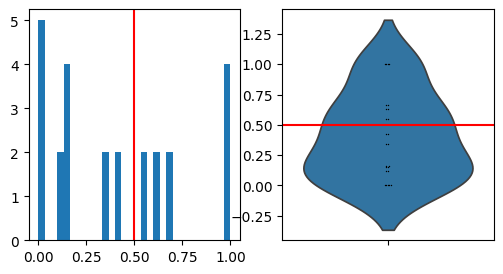

In [25]:
Tcell_clust_onevall = ['Immature_CD4', 'Mature_CD4', 'Mature_CD8','Immature_CD8','Treg']
sub_target_adata_T = target_adata_total[target_adata_total.obs["Dirac_pred_clusters"].isin(Tcell_clust_onevall)]

# sc.pp.pca(target_adata_T)
sc.pp.neighbors(sub_target_adata_T, use_rep="Dirac_embed", n_neighbors=30)
sc.tl.umap(sub_target_adata_T)
sc.tl.paga(sub_target_adata_T, groups="Dirac_pred_clusters")

# Distribution of PAGA connectivities for determining the cutting threshold
fig, axs = plt.subplots(1, 2, figsize=(6, 3))
paga_conn = sub_target_adata_T.uns["paga"]["connectivities"].toarray().ravel()
a = axs[0].hist(paga_conn, bins=30)
sns.violinplot(paga_conn, ax=axs[1], inner=None)
sns.swarmplot(paga_conn, ax=axs[1], color="k", size=1)
thr = 0.5
_ = axs[1].axhline(thr, c="r")
_ = axs[0].axvline(thr, c="r")
fig.savefig(os.path.join(save_path, f"Prune_PAGA_edges_T_no_DN.pdf"), bbox_inches='tight', dpi = 300)

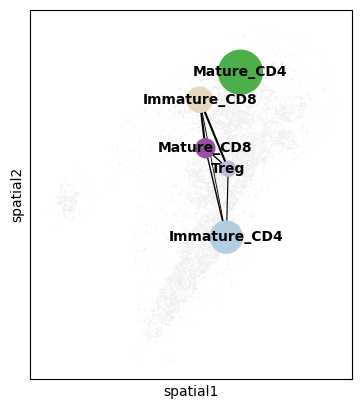

In [28]:
# Define function to obtain the kernel density estimate center for each group
def kde_center(data):
    kde = gaussian_kde(data.T)  # Compute the kernel density estimate
    density = kde(data.T)  # Get the density values
    center_idx = density.argmax()  # Find the index with the maximum density
    return data[center_idx]  # Return the corresponding data point (center)

# Create a DataFrame to store UMAP coordinates and group labels
pos = pd.DataFrame(sub_target_adata_T.obsm["spatial"], index=sub_target_adata_T.obs_names)
pos["group"] = sub_target_adata_T.obs[sub_target_adata_T.uns["paga"]["groups"]]  # Assign the group labels

# Compute the kernel density estimate center for each group
kde_pos = pos.groupby("group", observed=True).apply(lambda df: pd.Series(kde_center(df.values[:, :2])))

# Convert the DataFrame to a numpy array
kde_pos = kde_pos.values

# Plot UMAP background
ax = sc.pl.spatial(sub_target_adata_T, show=False, img_key=None, spot_size=10)

# Plot PAGA
sc.pl.paga(
    sub_target_adata_T,
    color='Dirac_pred_clusters',  # Color the nodes by their predicted cluster
    threshold=0.4,  # Set the threshold for pruning edges
    node_size_scale=2,  # Scale the size of the nodes
    edge_width_scale=0.2,  # Scale the width of the edges
    pos=kde_pos,  # Use the KDE-based node positions
    random_state=0,  # Set random state for reproducibility
    ax=ax,  # Use the provided axis for plotting
    show=False,  # Don't immediately show the plot
)

# Save the figure
plt.savefig(os.path.join(save_path, "PAGA_edges_prunned_T_spatial_kde_no_DN.pdf"), bbox_inches='tight', dpi=300)
plt.show()  # Display the plot


|-----> <insert> spatial_connectivities to obsp in AnnData Object.
|-----> <insert> spatial_distances to obsp in AnnData Object.
|-----> <insert> spatial_neighbors to uns in AnnData Object.
|-----> <insert> spatial_neighbors.indices to uns in AnnData Object.
|-----> <insert> spatial_neighbors.params to uns in AnnData Object.
|-----> <insert> spatial_weights to obsp in AnnData Object.
|-----> 
--- 10 labels, 130026 samples ---
initalized (11,) index ptr: [0 0 0 0 0 0 0 0 0 0 0]
initalized (130026,) indices: [0 0 0 ... 0 0 0]
initalized (130026,) data: [1 1 1 ... 1 1 1]

|-----> Deep copying AnnData object and working on the new copy. Original AnnData object will not be modified.
|-----> Matrix multiplying labels x weights x labels-transpose, shape (10, 130026) x (130026, 130026) x (130026, 10).


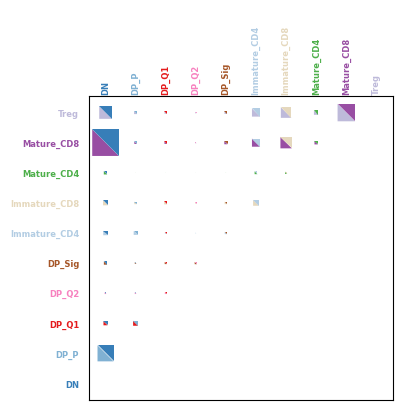

<Figure size 600x400 with 0 Axes>

In [30]:
now = '20241015172805'

save_path = f"/home/users/nus/changxu/scratch/section5/Results/A02677B5_cellbin_Dirac/{now}"
source_adata_total = sc.read(os.path.join(save_path, "Total", "A02677B5_cellbin_Dirac_Total_source.h5ad"))
target_adata_total = sc.read(os.path.join(save_path, "Total", "A02677B5_cellbin_Dirac_Total_target.h5ad"))
target_adata_RNA = sc.read(os.path.join(save_path, "RNA", "A02677B5_cellbin_Dirac_RNA_target.h5ad"))
target_adata_protein = sc.read(os.path.join(save_path, "Protein", "A02677B5_cellbin_Dirac_Protein_target.h5ad"))

Tcell_clust_onevall = ['DP_Q2', 'DP_Sig', 'Immature_CD4', 'DP_Q1', 'DP_P',
                       'Immature_CD8','Mature_CD8','Treg','Mature_CD4', 'DN']
target_adata_T = target_adata_total[target_adata_total.obs["Dirac_pred_clusters"].isin(Tcell_clust_onevall)]

colormaps_clusters = target_adata_total.uns['Dirac_pred_clusters_colors']

data_name = "A02677B5"

colormap = {
 'DN': '#377eb8',
 'DP_P': '#80b1d3',
 'DP_Q1': '#e41a1c',
 'DP_Q2': '#f781bf',
 'DP_Sig': '#a65628',
 'Immature_CD4': '#b3cde3',
 'Immature_CD8': '#e5d8bd',
 'Mature_CD4': '#4daf4a',
 'Mature_CD8': '#984ea3',
 'Treg': '#bebada'}

sc.pp.neighbors(target_adata_T, use_rep="Dirac_embed", n_neighbors=15)
sp.pl.plot_connections(
    target_adata_T,
    cat_key='Dirac_pred_clusters',
    save_show_or_return='show',
    title_str=" ",
    title_fontsize=6,
    label_fontsize=6,
    colormap = colormap,
    figsize = (4, 4),
)
# plt.show()

plt.savefig(os.path.join(save_path, f"{data_name}_T_CCI_spatial.pdf"), bbox_inches='tight', dpi = 300)

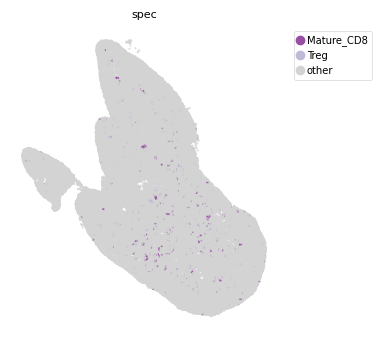

/home/users/nus/changxu/Software/anaconda3/envs/SpaGNNs_gpu/lib/python3.9/site-packages/spateo/tools/cci_two_cluster.py:128: ImplicitModificationWarning:

Trying to modify attribute `.var` of view, initializing view as actual.



|-----> 20 ligands for cell type Treg with highest fraction of prevalence: ['Tnfsf13b', 'Il4', 'Hbegf', 'Cd160', 'Selp', 'Xcl1', 'Dagla', 'Cntn1', 'Gip', 'Fcer2a', 'Alox5', 'Reln', 'Alox5ap', 'Il13', 'Ddc', 'Ccl12', 'Slit2', 'Tnfrsf8', 'Tnf', 'Crtam']. Testing interactions involving these genes.


/home/users/nus/changxu/Software/anaconda3/envs/SpaGNNs_gpu/lib/python3.9/site-packages/spateo/tools/cci_two_cluster.py:152: ImplicitModificationWarning:

Trying to modify attribute `.var` of view, initializing view as actual.



|-----> 20 receptors for cell type Mature_CD8 with highest fraction of prevalence: ['Rorb', 'Cd209e', 'Ccr1', 'Itga9', 'Itgb8', 'Crabp2', 'Cd177', 'Cd209a', 'Ltb4r1', 'C3ar1', 'Il27ra', 'Il18rap', 'Met', 'Ccr10', 'Rarg', 'P2ry6', 'Tnfrsf4', 'Flt1', 'Siglec1', 'Esam']. Testing interactions involving these genes.


100%|██████████████████████| 1000/1000 [00:03<00:00, 290.65it/s]


In [33]:
sender_ct = 'Treg'
receptor_ct = 'Mature_CD8'

sp.tl.prepare_cci_cellpair_adata(target_adata_T, sender_group=sender_ct,
                                 receiver_group=receptor_ct, group='Dirac_pred_clusters', all_cell_pair=True)
# plot all cell pair
sp.pl.space(target_adata_T,
            color=['spec'],
            pointsize=0.2,
            color_key={'other': '#D3D3D3', sender_ct: colormaps_clusters
                       [sender_ct], receptor_ct: colormaps_clusters[receptor_ct]},
            show_legend='upper left',
            figsize=(4, 4),
            save_show_or_return='show',
            #save_kwargs={"prefix": "./figures/left_2DPI_uninjury_cci_" + sender_ct + "_" + receptor_ct + "_all_cell_pair"}
            )

# _, adata = sp.tl.neighbors(
#     target_adata_T,
#     basis='spatial',
#     spatial_key='spatial',
#     n_neighbors=10
# )

db_dir = "/home/project/11003054/changxu/Projects/SpaGNNs/Final_code/Results/C03833D6_cellbin_Dirac_annotation/20240711150421/mouse_database/"
res = sp.tl.find_cci_two_group(target_adata_T,
                               path=db_dir,
                               species='mouse',
                               group='Dirac_pred_clusters',
                               sender_group=sender_ct,
                               receiver_group=receptor_ct,
                               filter_lr='outer',
                               min_pairs=0,
                               min_pairs_ratio=0,
                               top=20,)

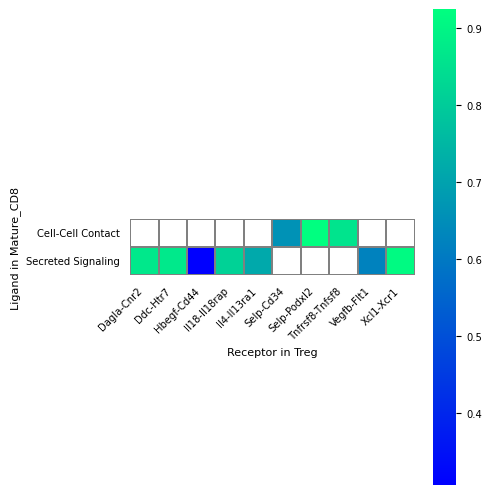

In [35]:
df = res['lr_pair']
df = df.loc[df['lr_co_exp_num'] > 0].sort_values(
    'lr_co_exp_ratio', ascending=False)[0:10]

%matplotlib inline
data1 = df.iloc[:, [2, 3, 7]]
test = data1.pivot(index="type", columns="lr_pair",
                   values="lr_co_exp_ratio_pvalue").fillna(0)
fig = plt.figure()
fig.set_size_inches(5, 5)
x_label = list(test.columns.tolist())
y_label = list(test.index)
ax = sns.heatmap(test,
                 cmap="winter",
                 square=True,
                 yticklabels=y_label,
                 linecolor='grey',
                 linewidths=0.3,
                 annot_kws={'size': 10, 'weight': 'bold', },
                 xticklabels=x_label,
                 mask=(test < 0.01))
plt.gcf().subplots_adjust(bottom=0.3)
plt.xlabel(f"Receptor in {sender_ct}")
plt.ylabel(f"Ligand in {receptor_ct}")
ax.set_xticklabels(x_label, rotation=45, ha="right")
ax.xaxis.set_ticks_position('none')
ax.yaxis.set_ticks_position('none')
plt.tight_layout()

plt.savefig(os.path.join(save_path,f"2DPI_sub_cci_{sender_ct}_{receptor_ct}_heatmap.pdf"), transparent=True)

#plt.savefig("./figures/2DPI_sub_cci_WSN_ReaEGC_heatmap.pdf", transparent=True)

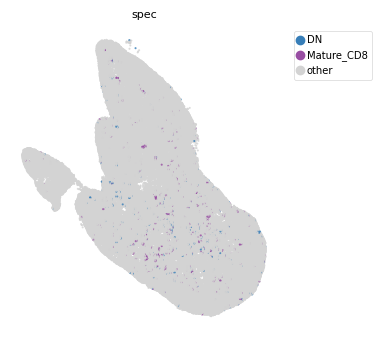

/home/users/nus/changxu/Software/anaconda3/envs/SpaGNNs_gpu/lib/python3.9/site-packages/spateo/tools/cci_two_cluster.py:128: ImplicitModificationWarning:

Trying to modify attribute `.var` of view, initializing view as actual.



|-----> 20 ligands for cell type Mature_CD8 with highest fraction of prevalence: ['Cadm3', 'Il12b', 'Areg', 'Adora2b', 'Alox5', 'F10', 'Tnfsf4', 'Tnf', 'Ccl24', 'Tnfsf13b', 'Esam', 'Dagla', 'Ccl12', 'Sema6d', 'Slit2', 'Lgals3', 'Lta', 'Clcf1', 'Adm', 'Plau']. Testing interactions involving these genes.


/home/users/nus/changxu/Software/anaconda3/envs/SpaGNNs_gpu/lib/python3.9/site-packages/spateo/tools/cci_two_cluster.py:152: ImplicitModificationWarning:

Trying to modify attribute `.var` of view, initializing view as actual.



|-----> 20 receptors for cell type DN with highest fraction of prevalence: ['Il23r', 'Csf2ra', 'Tnfrsf14', 'Cnr2', 'Rarb', 'Lilr4b', 'Tyrobp', 'Ramp3', 'Ccr5', 'Csf2rb', 'Htr7', 'C3ar1', 'Cd34', 'Plaur', 'Cdh5', 'Rarg', 'Tnfrsf4', 'Gper1', 'Esam', 'Slc7a1']. Testing interactions involving these genes.


100%|██████████████████████| 1000/1000 [00:03<00:00, 270.44it/s]


In [38]:
sender_ct = 'Mature_CD8'
receptor_ct = 'DN'

sp.tl.prepare_cci_cellpair_adata(target_adata_T, sender_group=sender_ct,
                                 receiver_group=receptor_ct, group='Dirac_pred_clusters', all_cell_pair=True)
# plot all cell pair
sp.pl.space(target_adata_T,
            color=['spec'],
            pointsize=0.2,
            color_key={'other': '#D3D3D3', sender_ct: colormaps_clusters
                       [sender_ct], receptor_ct: colormaps_clusters[receptor_ct]},
            show_legend='upper left',
            figsize=(4, 4),
            save_show_or_return='show',
            #save_kwargs={"prefix": "./figures/left_2DPI_uninjury_cci_" + sender_ct + "_" + receptor_ct + "_all_cell_pair"}
            )

# _, adata = sp.tl.neighbors(
#     target_adata_T,
#     basis='spatial',
#     spatial_key='spatial',
#     n_neighbors=10
# )

db_dir = "/home/project/11003054/changxu/Projects/SpaGNNs/Final_code/Results/C03833D6_cellbin_Dirac_annotation/20240711150421/mouse_database/"
res = sp.tl.find_cci_two_group(target_adata_T,
                               path=db_dir,
                               species='mouse',
                               group='Dirac_pred_clusters',
                               sender_group=sender_ct,
                               receiver_group=receptor_ct,
                               filter_lr='outer',
                               min_pairs=0,
                               min_pairs_ratio=0,
                               top=20,)

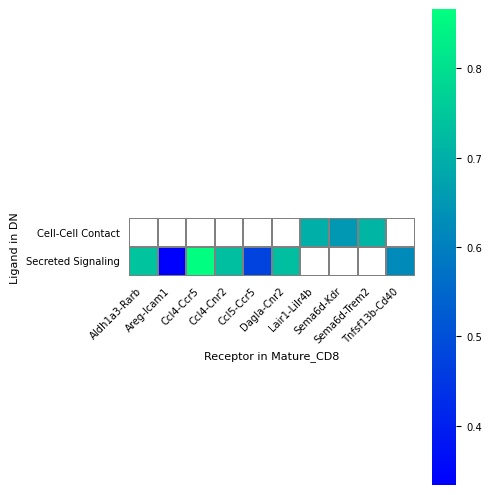

In [39]:
df = res['lr_pair']
df = df.loc[df['lr_co_exp_num'] > 0].sort_values(
    'lr_co_exp_ratio', ascending=False)[0:10]

%matplotlib inline
data1 = df.iloc[:, [2, 3, 7]]
test = data1.pivot(index="type", columns="lr_pair",
                   values="lr_co_exp_ratio_pvalue").fillna(0)
fig = plt.figure()
fig.set_size_inches(5, 5)
x_label = list(test.columns.tolist())
y_label = list(test.index)
ax = sns.heatmap(test,
                 cmap="winter",
                 square=True,
                 yticklabels=y_label,
                 linecolor='grey',
                 linewidths=0.3,
                 annot_kws={'size': 10, 'weight': 'bold', },
                 xticklabels=x_label,
                 mask=(test < 0.01))
plt.gcf().subplots_adjust(bottom=0.3)
plt.xlabel(f"Receptor in {sender_ct}")
plt.ylabel(f"Ligand in {receptor_ct}")
ax.set_xticklabels(x_label, rotation=45, ha="right")
ax.xaxis.set_ticks_position('none')
ax.yaxis.set_ticks_position('none')
plt.tight_layout()

plt.savefig(os.path.join(save_path,f"2DPI_sub_cci_{sender_ct}_{receptor_ct}_heatmap.pdf"), transparent=True)

[2024-10-16 13:20:49][Stereo][2207053][MainThread][140165830783488][st_pipeline][41][INFO]: start to run cal_qc...
[2024-10-16 13:20:49][Stereo][2207053][MainThread][140165830783488][st_pipeline][44][INFO]: cal_qc end, consume time 0.1980s.
[2024-10-16 13:20:50][Stereo][2207053][MainThread][140165830783488][st_pipeline][41][INFO]: start to run normalize_total...
[2024-10-16 13:20:50][Stereo][2207053][MainThread][140165830783488][st_pipeline][44][INFO]: normalize_total end, consume time 0.1606s.
[2024-10-16 13:20:50][Stereo][2207053][MainThread][140165830783488][st_pipeline][41][INFO]: start to run log1p...
[2024-10-16 13:20:50][Stereo][2207053][MainThread][140165830783488][st_pipeline][44][INFO]: log1p end, consume time 0.3177s.
[2024-10-16 13:20:50][Stereo][2207053][MainThread][140165830783488][st_pipeline][41][INFO]: start to run highly_variable_genes...
[2024-10-16 13:20:51][Stereo][2207053][MainThread][140165830783488][st_pipeline][44][INFO]: highly_variable_genes end, consume time

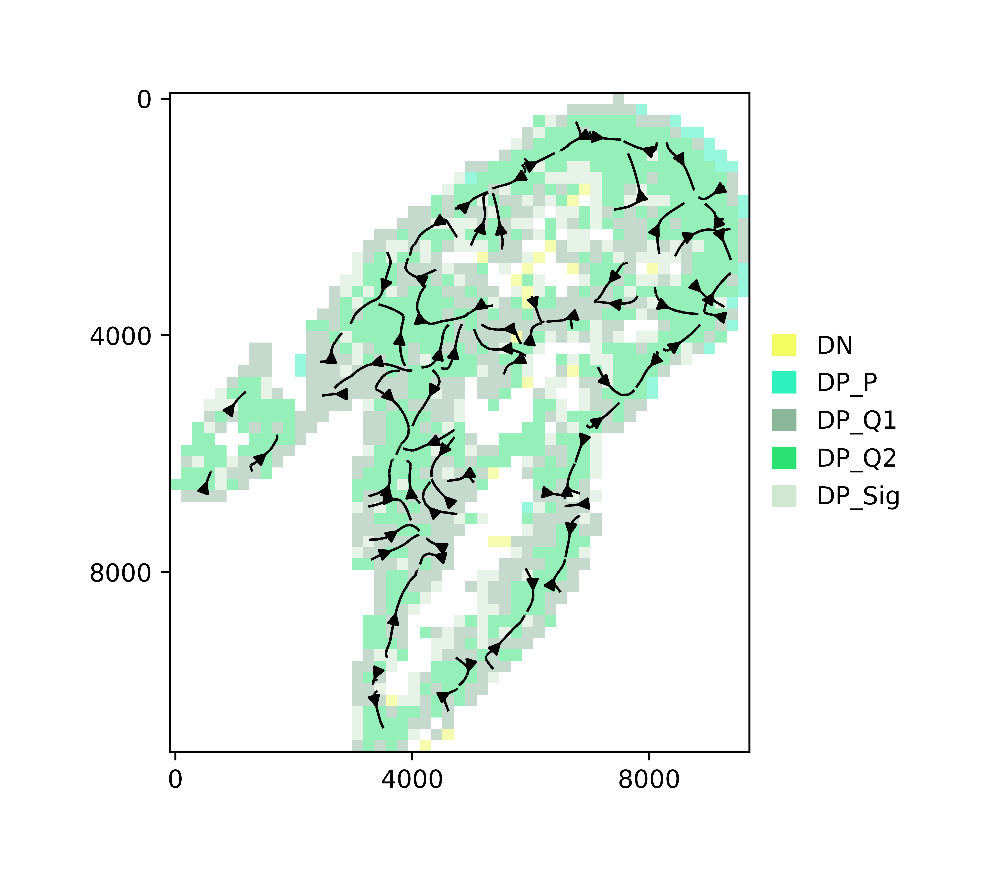

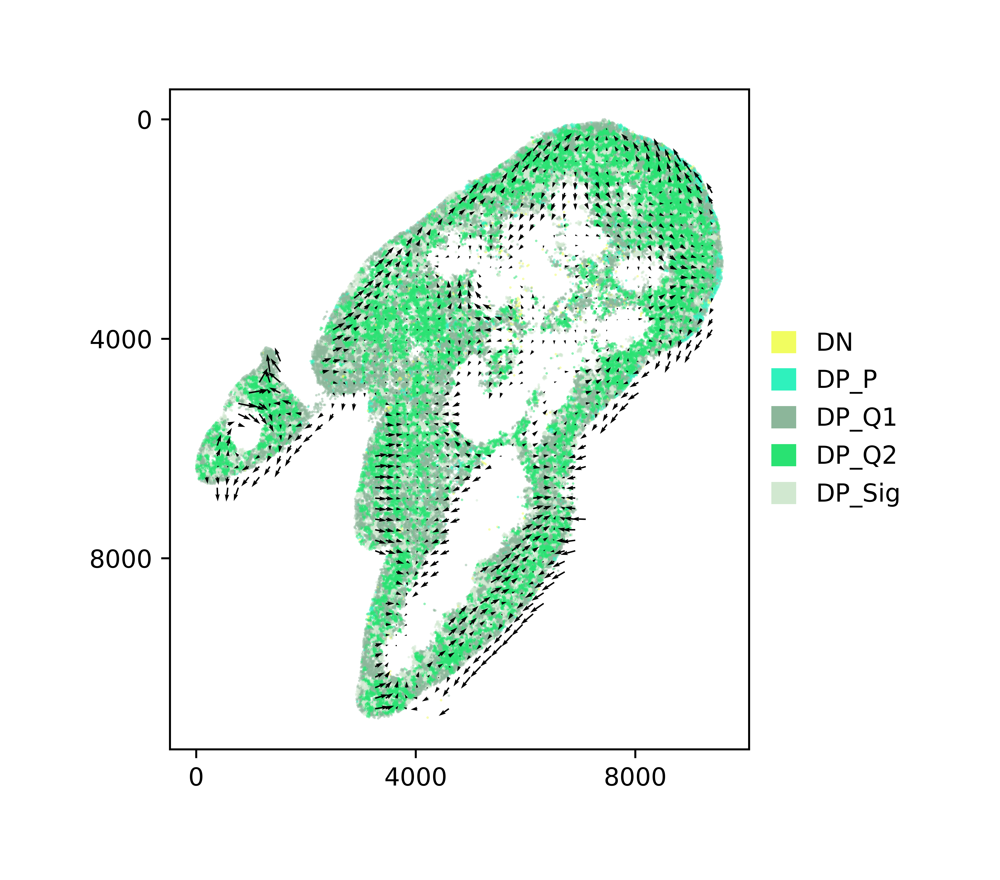

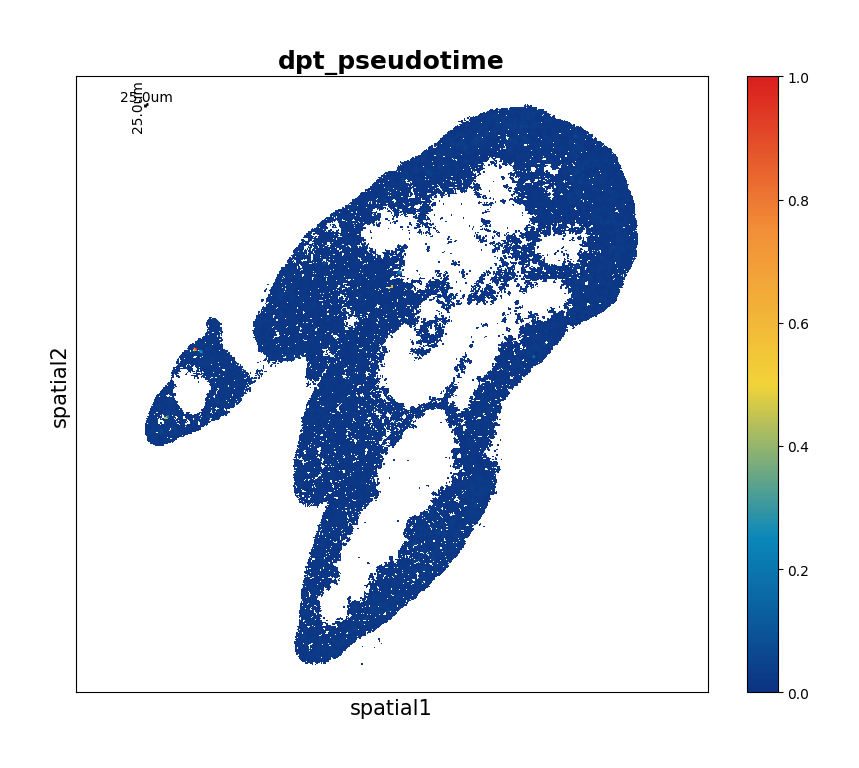

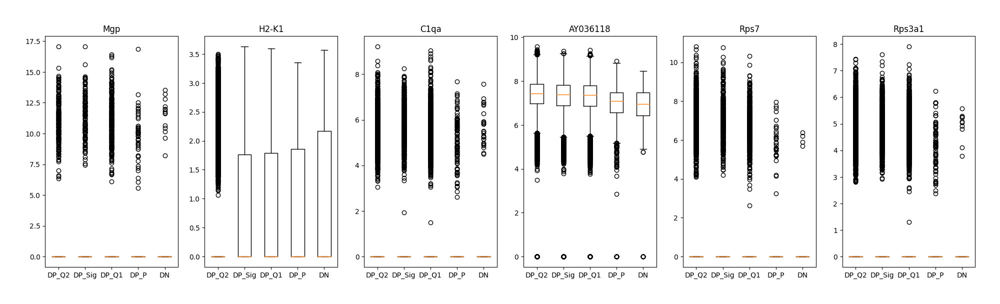

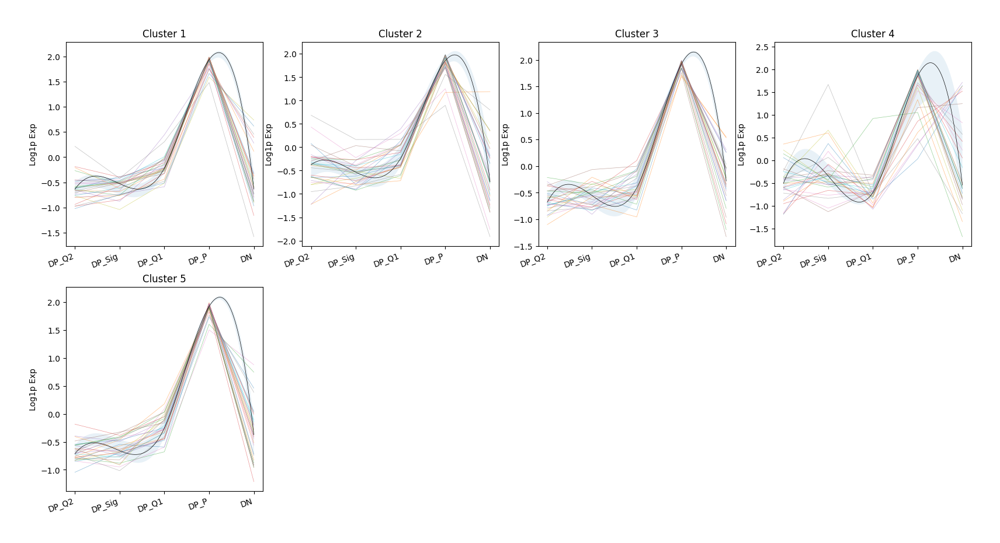

In [12]:
#### Trajectory Analysis
import os
import stereo as st
import warnings
warnings.filterwarnings('ignore')
import numpy as np
import matplotlib.pyplot as plt
import scanpy as sc
now = '20241015172805'

save_path = f"/home/users/nus/changxu/scratch/section5/Results/A02677B5_cellbin_Dirac/{now}"
data_path = "/home/project/11003054/changxu/Data/Stereo_cite_seq/"
data_name = "A02677B5_cellbin"

target_adata_total = sc.read(os.path.join(save_path, "Total", f"{data_name}_Dirac_Total_target.h5ad"))
data_raw = sc.read_h5ad(os.path.join(data_path, f"{data_name}_RNA.h5ad"))
target = data_raw[target_adata_total.obs_names]
target.obs = target_adata_total.obs
target.obsm = target_adata_total.obsm
target.uns = target_adata_total.uns
target.write(os.path.join(save_path, f"{data_name}_RAW.h5ad"), compression="gzip")

# Tcell_clust_onevall = ['DP_Q2', 'DP_Sig', 'Immature_CD4', 'DP_Q1', 'DP_P',
#                        'Immature_CD8','Mature_CD8','Treg','Mature_CD4', 'DN']

Tcell_clust_onevall = ['DP_Q2', 'DP_Sig', 'DP_Q1', 'DP_P','DN']
selected_colors = {cell_type: target.uns['Dirac_pred_clusters_colors'][cell_type] for cell_type in Tcell_clust_onevall}
target_T = target[target.obs['Dirac_pred_clusters'].isin(Tcell_clust_onevall)]
target_T.uns['Dirac_pred_clusters_colors'] = selected_colors
target_T.write(os.path.join(save_path, f"{data_name}_T_no_CD4_8.h5ad"), compression="gzip")



data = st.io.read_h5ad(os.path.join(save_path, f"{data_name}_T_no_CD4_8.h5ad"))

# preprocessing
data.tl.cal_qc()
data.tl.raw_checkpoint()
data.tl.normalize_total(target_sum=1e4)
data.tl.log1p()

# hvg
data.tl.highly_variable_genes(min_mean=0.0125, max_mean=3, min_disp=0.5, res_key='highly_variable_genes', n_top_genes=None)

data.tl.scale(zero_center=False)

# embedding
data.tl.neighbors(pca_res_key='Dirac_embed', n_pcs=None, res_key='neighbors')

# setting the `iroot` to data.tl.result
data.tl.result['iroot'] = np.flatnonzero(data.cells['Dirac_pred_clusters'] == 'DN')[100]  # 'Heart'
data.tl.dpt(n_branchings=0)

data.plt.plot_vec(
        data.position[:, 0] - data.position[:, 0].min(),
        data.position[:, 1] - data.position[:, 1].min(),
        data.cells['Dirac_pred_clusters'].to_numpy(),
        data.tl.result['dpt_pseudotime'],
        type='stream',
        line_width=1,
        background='field',
        num_pix=50,
        filter_type='gauss',
        sigma_val=1,
        radius_val=3,
        density=2,
        seed_val=0,
        num_legend_per_col=20,
        dpi_val=1000,
        )
plt.savefig(os.path.join(save_path, f"{data_name}_dpt_field_no_CD4_CD8.pdf"), bbox_inches='tight', dpi=300)



# target_adata_T = sc.read(os.path.join(save_path, f"{data_name}_T_no_CD4_8.h5ad"))

# fig, ax = plt.subplots(figsize=(8, 6))

# sc.pl.spatial(target_adata_T, 
#               color=["Dirac_pred_clusters"], 
#               frameon=False, 
#               spot_size=20, 
#               title=["Dirac preds"],
#               img_key = None,
#               palette = colormaps_clusters,
#               ax=ax)
# fig.savefig(os.path.join(save_path, f"{data_name}_T_no_CD4_8_cell_type.pdf"), bbox_inches='tight', dpi = 300)


data.plt.plot_vec(
        data.position[:, 0] - data.position[:, 0].min(),
        data.position[:, 1] - data.position[:, 1].min(),
        data.cells['Dirac_pred_clusters'].to_numpy(),
        data.tl.result['dpt_pseudotime'],
        type='vec',
        background='cell',
        num_pix=50,
        filter_type='gauss',
        sigma_val=2,
        radius_val=1,
        seed_val=0,
        dpi_val=1000,
        )
plt.savefig(os.path.join(save_path, f"{data_name}_dpt_vec_T_no_CD4_8.pdf"), bbox_inches='tight', dpi=300)


data.plt.plot_time_scatter(group='Dirac_pred_clusters', plotting_scale_width=50)
plt.savefig(os.path.join(save_path, f"{data_name}_dpt_time_scatter_T_no_CD4_8.pdf"), bbox_inches='tight', dpi=300)



data.tl.time_series_analysis(
        run_method='tvg_marker',
        use_col='Dirac_pred_clusters',
        branch=Tcell_clust_onevall,
        p_val_combination='FDR'
        )
data.genes.to_df().sort_values('less_pvalue').iloc[:3]
data.genes.to_df().sort_values('greater_pvalue').iloc[:3]

data.plt.boxplot_transit_gene(
                use_col='Dirac_pred_clusters',
                branch=Tcell_clust_onevall,
                genes=list(data.genes.to_df().sort_values('greater_pvalue').iloc[:3].index) + list(data.genes.to_df().sort_values('less_pvalue').iloc[:3].index)
                )
plt.savefig(os.path.join(save_path, f"{data_name}_dpt_transit_gene_T_no_CD4_8.pdf"), bbox_inches='tight', dpi=300)



data.tl.time_series_analysis(run_method='other', cluster_number=5)
data.plt.fuzz_cluster_plot(
        use_col='Dirac_pred_clusters',
        branch=Tcell_clust_onevall,
        threshold = 'p99.9',
        n_col = 4,
        summary_trend=True,
        width = None,
        height = None
        )
plt.savefig(os.path.join(save_path, f"{data_name}_dpt_time_series_analysis_T_no_CD4_8.pdf"), bbox_inches='tight', dpi=300)

[2024-10-16 13:03:31][Stereo][2207053][MainThread][140165830783488][st_pipeline][41][INFO]: start to run cal_qc...
[2024-10-16 13:03:31][Stereo][2207053][MainThread][140165830783488][st_pipeline][44][INFO]: cal_qc end, consume time 0.2663s.
[2024-10-16 13:03:32][Stereo][2207053][MainThread][140165830783488][st_pipeline][41][INFO]: start to run normalize_total...
[2024-10-16 13:03:32][Stereo][2207053][MainThread][140165830783488][st_pipeline][44][INFO]: normalize_total end, consume time 0.1689s.
[2024-10-16 13:03:32][Stereo][2207053][MainThread][140165830783488][st_pipeline][41][INFO]: start to run log1p...
[2024-10-16 13:03:32][Stereo][2207053][MainThread][140165830783488][st_pipeline][44][INFO]: log1p end, consume time 0.3391s.
[2024-10-16 13:03:32][Stereo][2207053][MainThread][140165830783488][st_pipeline][41][INFO]: start to run highly_variable_genes...
[2024-10-16 13:03:33][Stereo][2207053][MainThread][140165830783488][st_pipeline][44][INFO]: highly_variable_genes end, consume time

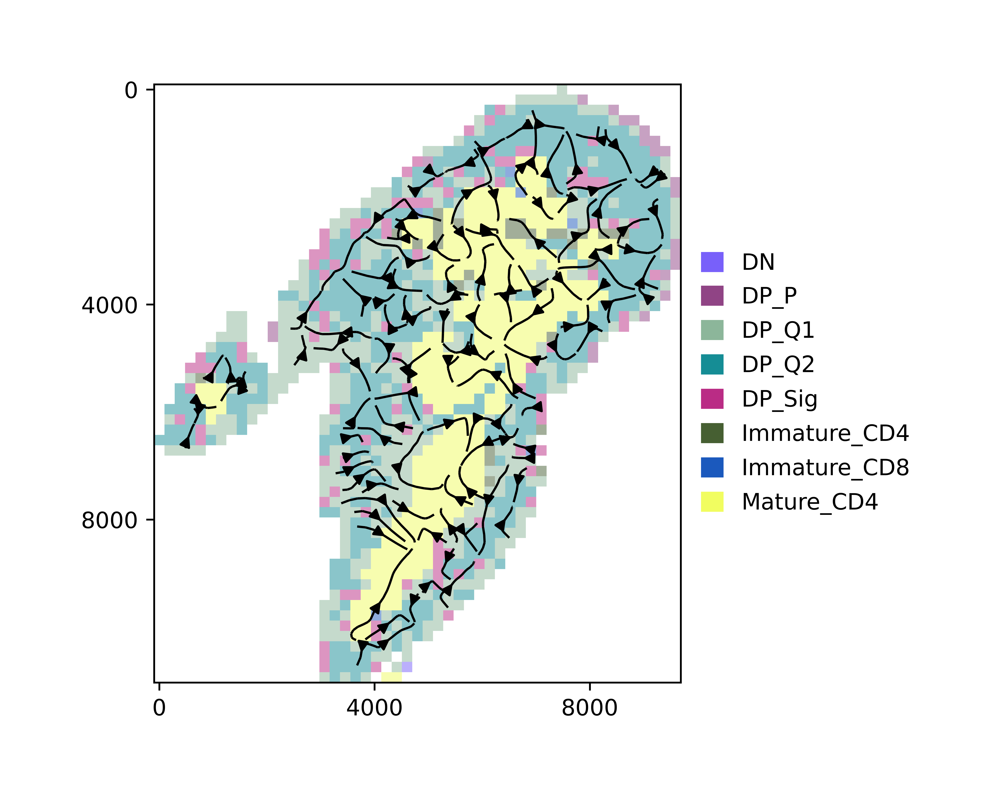

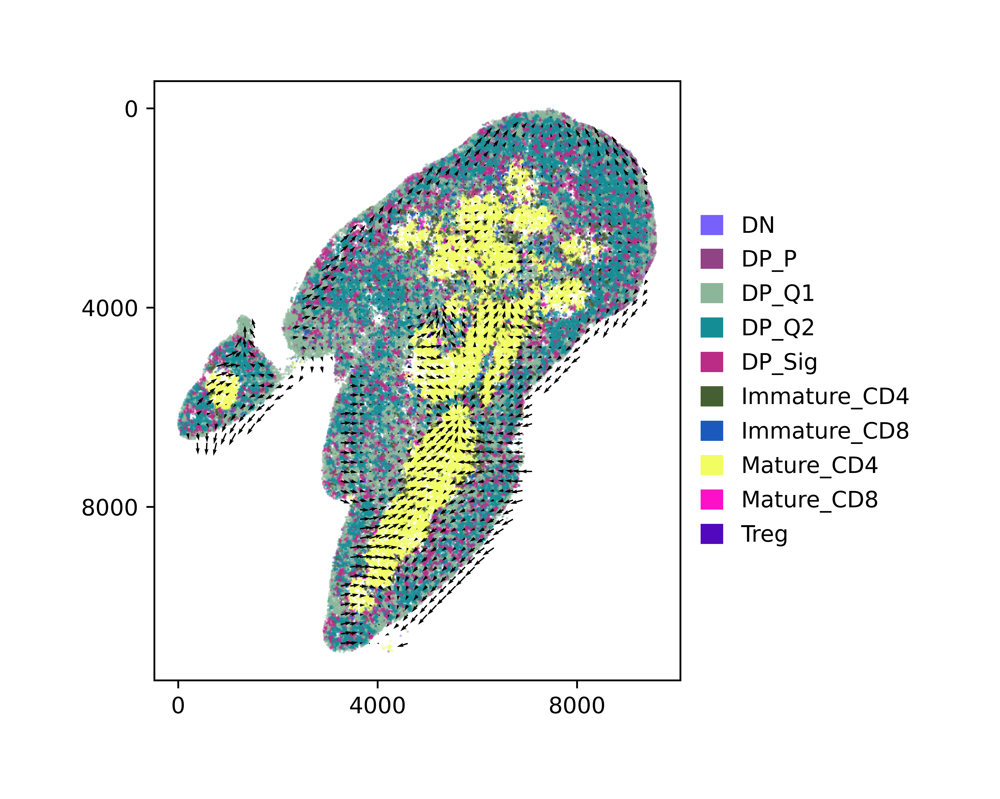

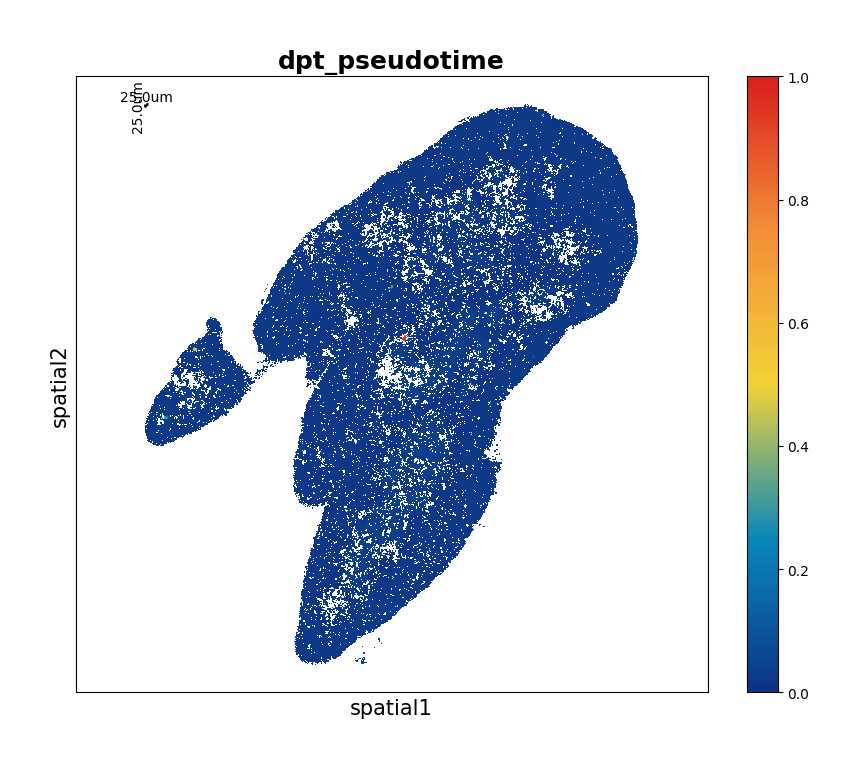

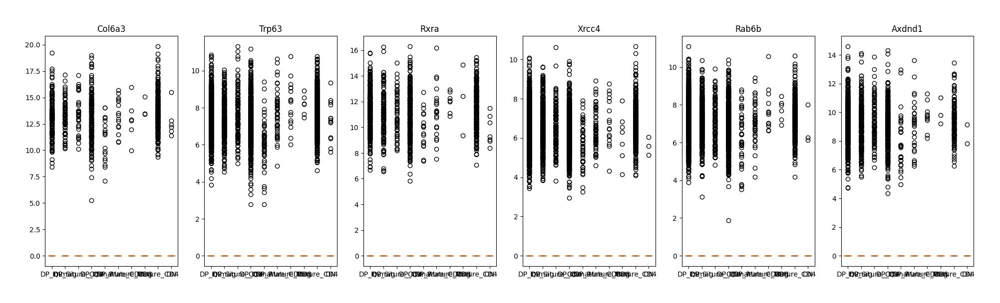

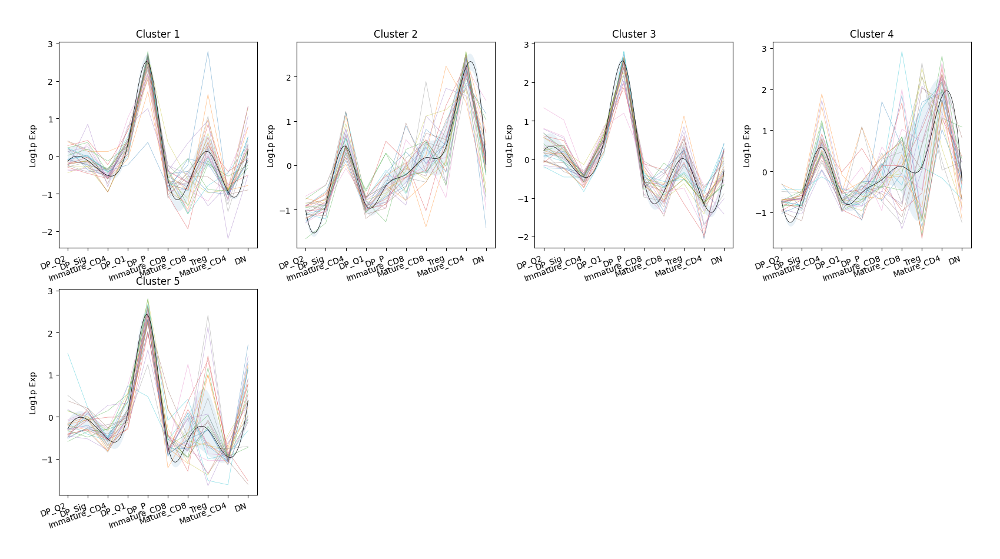

In [8]:
#### Trajectory Analysis
import os
import stereo as st
import warnings
warnings.filterwarnings('ignore')
import numpy as np
import matplotlib.pyplot as plt
import scanpy as sc
now = '20241015172805'

save_path = f"/home/users/nus/changxu/scratch/section5/Results/A02677B5_cellbin_Dirac/{now}"
data_path = "/home/project/11003054/changxu/Data/Stereo_cite_seq/"
data_name = "A02677B5_cellbin"

target_adata_total = sc.read(os.path.join(save_path, "Total", f"{data_name}_Dirac_Total_target.h5ad"))
data_raw = sc.read_h5ad(os.path.join(data_path, f"{data_name}_RNA.h5ad"))
target = data_raw[target_adata_total.obs_names]
target.obs = target_adata_total.obs
target.obsm = target_adata_total.obsm
target.uns = target_adata_total.uns
target.write(os.path.join(save_path, f"{data_name}_RAW.h5ad"), compression="gzip")

Tcell_clust_onevall = ['DP_Q2', 'DP_Sig', 'Immature_CD4', 'DP_Q1', 'DP_P',
                       'Immature_CD8','Mature_CD8','Treg','Mature_CD4', 'DN']

# Tcell_clust_onevall = ['DP_Q2', 'DP_Sig', 'DP_Q1', 'DP_P','DN']
selected_colors = {cell_type: target.uns['Dirac_pred_clusters_colors'][cell_type] for cell_type in Tcell_clust_onevall}
target_T = target[target.obs['Dirac_pred_clusters'].isin(Tcell_clust_onevall)]
target_T.uns['Dirac_pred_clusters_colors'] = selected_colors
target_T.write(os.path.join(save_path, f"{data_name}.h5ad"), compression="gzip")



data = st.io.read_h5ad(os.path.join(save_path, f"{data_name}.h5ad"))

# preprocessing
data.tl.cal_qc()
data.tl.raw_checkpoint()
data.tl.normalize_total(target_sum=1e4)
data.tl.log1p()

# hvg
data.tl.highly_variable_genes(min_mean=0.0125, max_mean=3, min_disp=0.5, res_key='highly_variable_genes', n_top_genes=None)

data.tl.scale(zero_center=False)

# embedding
data.tl.neighbors(pca_res_key='Dirac_embed', n_pcs=None, res_key='neighbors')

# setting the `iroot` to data.tl.result
data.tl.result['iroot'] = np.flatnonzero(data.cells['Dirac_pred_clusters'] == 'DN')[100]  # 'Heart'
data.tl.dpt(n_branchings=0)

data.plt.plot_vec(
        data.position[:, 0] - data.position[:, 0].min(),
        data.position[:, 1] - data.position[:, 1].min(),
        data.cells['Dirac_pred_clusters'].to_numpy(),
        data.tl.result['dpt_pseudotime'],
        type='stream',
        line_width=1,
        background='field',
        num_pix=50,
        filter_type='gauss',
        sigma_val=1,
        radius_val=3,
        density=2,
        seed_val=0,
        num_legend_per_col=20,
        dpi_val=1000,
        )
plt.savefig(os.path.join(save_path, f"{data_name}_dpt_field.pdf"), bbox_inches='tight', dpi=300)



# target_adata_T = sc.read(os.path.join(save_path, f"{data_name}_T_no_CD4_8.h5ad"))

# fig, ax = plt.subplots(figsize=(8, 6))

# sc.pl.spatial(target_adata_T, 
#               color=["Dirac_pred_clusters"], 
#               frameon=False, 
#               spot_size=20, 
#               title=["Dirac preds"],
#               img_key = None,
#               palette = colormaps_clusters,
#               ax=ax)
# fig.savefig(os.path.join(save_path, f"{data_name}_T_no_CD4_8_cell_type.pdf"), bbox_inches='tight', dpi = 300)


data.plt.plot_vec(
        data.position[:, 0] - data.position[:, 0].min(),
        data.position[:, 1] - data.position[:, 1].min(),
        data.cells['Dirac_pred_clusters'].to_numpy(),
        data.tl.result['dpt_pseudotime'],
        type='vec',
        background='cell',
        num_pix=50,
        filter_type='gauss',
        sigma_val=2,
        radius_val=1,
        seed_val=0,
        dpi_val=1000,
        )
plt.savefig(os.path.join(save_path, f"{data_name}_dpt_vec.pdf"), bbox_inches='tight', dpi=300)


data.plt.plot_time_scatter(group='Dirac_pred_clusters', plotting_scale_width=50)
plt.savefig(os.path.join(save_path, f"{data_name}_dpt_time_scatter.pdf"), bbox_inches='tight', dpi=300)



data.tl.time_series_analysis(
        run_method='tvg_marker',
        use_col='Dirac_pred_clusters',
        branch=Tcell_clust_onevall,
        p_val_combination='FDR'
        )
data.genes.to_df().sort_values('less_pvalue').iloc[:3]
data.genes.to_df().sort_values('greater_pvalue').iloc[:3]

data.plt.boxplot_transit_gene(
                use_col='Dirac_pred_clusters',
                branch=Tcell_clust_onevall,
                genes=list(data.genes.to_df().sort_values('greater_pvalue').iloc[:3].index) + list(data.genes.to_df().sort_values('less_pvalue').iloc[:3].index)
                )
plt.savefig(os.path.join(save_path, f"{data_name}_dpt_transit_gene.pdf"), bbox_inches='tight', dpi=300)



data.tl.time_series_analysis(run_method='other', cluster_number=5)
data.plt.fuzz_cluster_plot(
        use_col='Dirac_pred_clusters',
        branch=Tcell_clust_onevall,
        threshold = 'p99.9',
        n_col = 4,
        summary_trend=True,
        width = None,
        height = None
        )
plt.savefig(os.path.join(save_path, f"{data_name}_dpt_time_series_analysis.pdf"), bbox_inches='tight', dpi=300)

[2024-10-16 13:17:51][Stereo][2207053][MainThread][140165830783488][st_pipeline][41][INFO]: start to run cal_qc...
[2024-10-16 13:17:51][Stereo][2207053][MainThread][140165830783488][st_pipeline][44][INFO]: cal_qc end, consume time 0.0787s.
[2024-10-16 13:17:51][Stereo][2207053][MainThread][140165830783488][st_pipeline][41][INFO]: start to run normalize_total...
[2024-10-16 13:17:52][Stereo][2207053][MainThread][140165830783488][st_pipeline][44][INFO]: normalize_total end, consume time 0.0366s.
[2024-10-16 13:17:52][Stereo][2207053][MainThread][140165830783488][st_pipeline][41][INFO]: start to run log1p...
[2024-10-16 13:17:52][Stereo][2207053][MainThread][140165830783488][st_pipeline][44][INFO]: log1p end, consume time 0.0820s.
[2024-10-16 13:17:52][Stereo][2207053][MainThread][140165830783488][st_pipeline][41][INFO]: start to run highly_variable_genes...
[2024-10-16 13:17:52][Stereo][2207053][MainThread][140165830783488][st_pipeline][44][INFO]: highly_variable_genes end, consume time

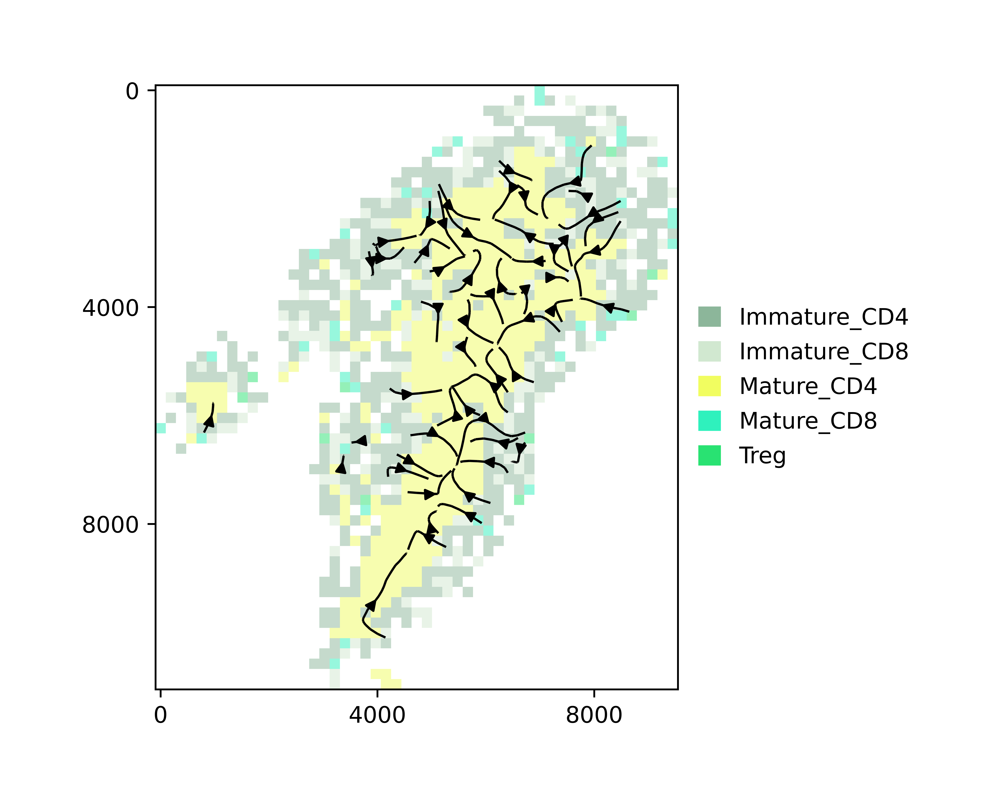

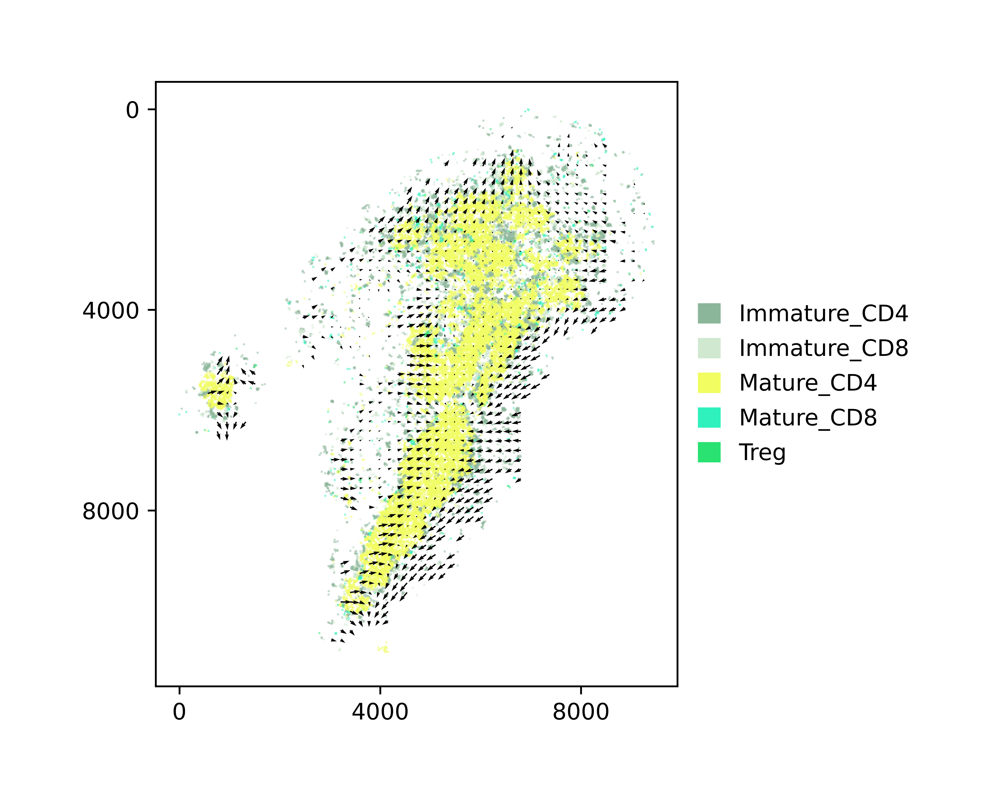

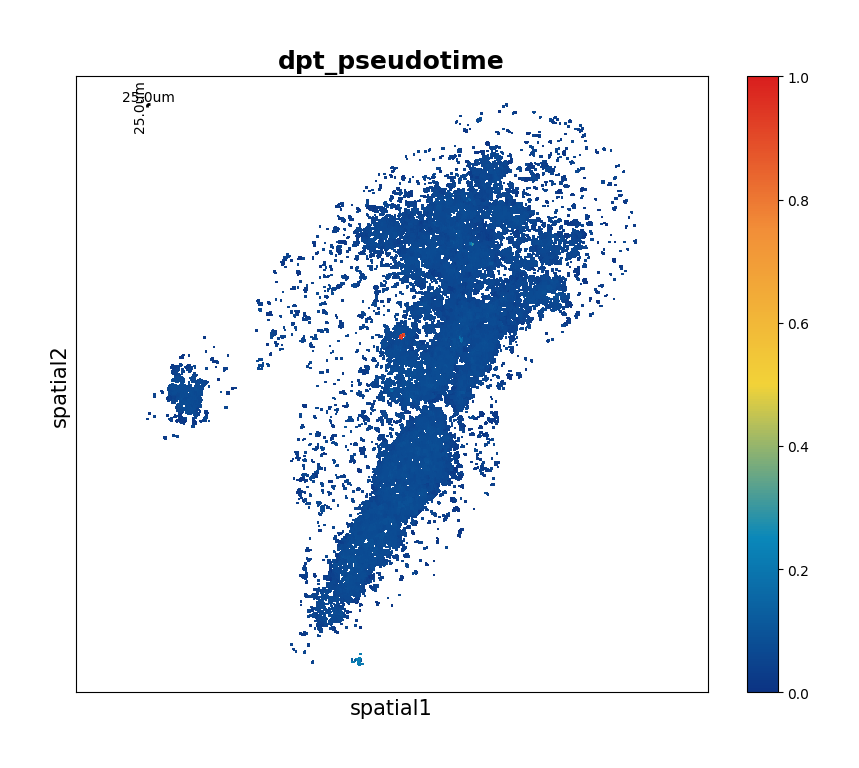

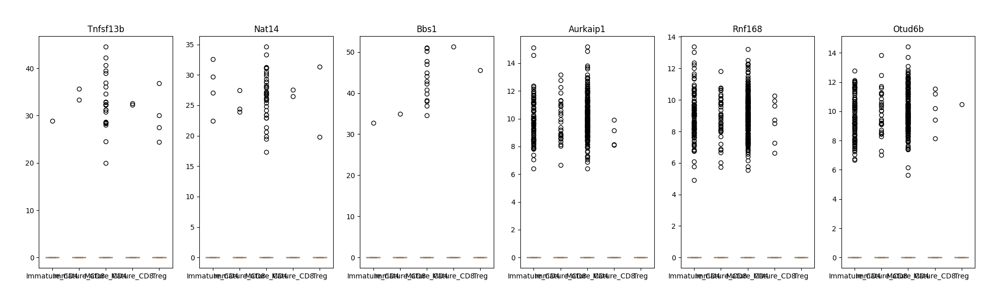

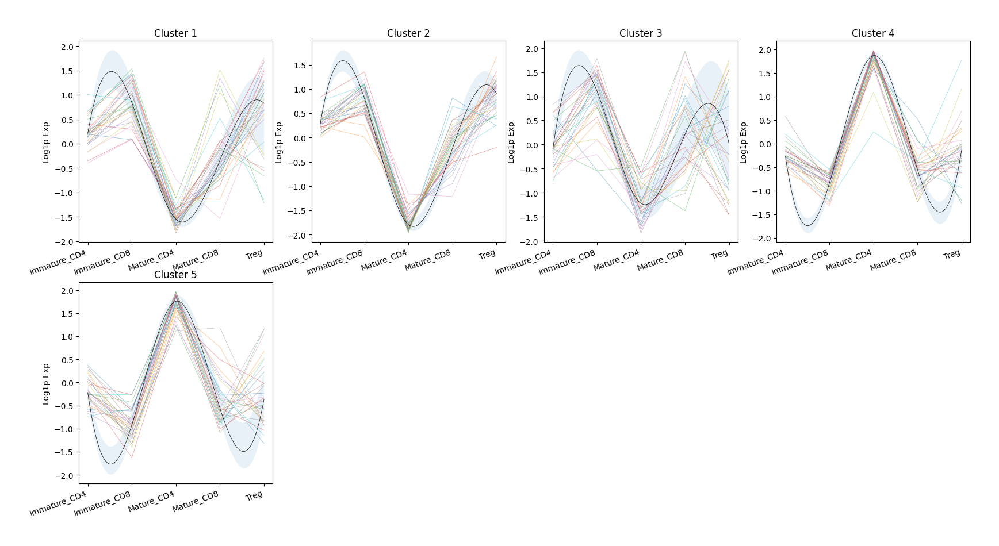

In [11]:
#### Trajectory Analysis
import os
import stereo as st
import warnings
warnings.filterwarnings('ignore')
import numpy as np
import matplotlib.pyplot as plt
import scanpy as sc
now = '20241015172805'

save_path = f"/home/users/nus/changxu/scratch/section5/Results/A02677B5_cellbin_Dirac/{now}"
data_path = "/home/project/11003054/changxu/Data/Stereo_cite_seq/"
data_name = "A02677B5_cellbin"

target_adata_total = sc.read(os.path.join(save_path, "Total", f"{data_name}_Dirac_Total_target.h5ad"))
data_raw = sc.read_h5ad(os.path.join(data_path, f"{data_name}_RNA.h5ad"))
target = data_raw[target_adata_total.obs_names]
target.obs = target_adata_total.obs
target.obsm = target_adata_total.obsm
target.uns = target_adata_total.uns
target.write(os.path.join(save_path, f"{data_name}_RAW.h5ad"), compression="gzip")



Tcell_clust_onevall = ['Immature_CD4', 'Immature_CD8', 'Mature_CD4', 'Mature_CD8','Treg']
selected_colors = {cell_type: target.uns['Dirac_pred_clusters_colors'][cell_type] for cell_type in Tcell_clust_onevall}
target_T = target[target.obs['Dirac_pred_clusters'].isin(Tcell_clust_onevall)]
target_T.uns['Dirac_pred_clusters_colors'] = selected_colors
target_T.write(os.path.join(save_path, f"{data_name}_only_T.h5ad"), compression="gzip")



data = st.io.read_h5ad(os.path.join(save_path, f"{data_name}_only_T.h5ad"))

# preprocessing
data.tl.cal_qc()
data.tl.raw_checkpoint()
data.tl.normalize_total(target_sum=1e4)
data.tl.log1p()

# hvg
data.tl.highly_variable_genes(min_mean=0.0125, max_mean=3, min_disp=0.5, res_key='highly_variable_genes', n_top_genes=None)

data.tl.scale(zero_center=False)

# embedding
data.tl.neighbors(pca_res_key='Dirac_embed', n_pcs=None, res_key='neighbors')

# setting the `iroot` to data.tl.result
data.tl.result['iroot'] = np.flatnonzero(data.cells['Dirac_pred_clusters'] == 'Immature_CD4')[100]  
data.tl.dpt(n_branchings=0)

data.plt.plot_vec(
        data.position[:, 0] - data.position[:, 0].min(),
        data.position[:, 1] - data.position[:, 1].min(),
        data.cells['Dirac_pred_clusters'].to_numpy(),
        data.tl.result['dpt_pseudotime'],
        type='stream',
        line_width=1,
        background='field',
        num_pix=50,
        filter_type='gauss',
        sigma_val=1,
        radius_val=3,
        density=2,
        seed_val=0,
        num_legend_per_col=20,
        dpi_val=1000,
        )
# 保存图形
plt.savefig(os.path.join(save_path, f"{data_name}_dpt_field_only_T.pdf"), bbox_inches='tight', dpi=300)



# target_adata_T = sc.read(os.path.join(save_path, f"{data_name}_T_no_CD4_8.h5ad"))

# fig, ax = plt.subplots(figsize=(8, 6))

# sc.pl.spatial(target_adata_T, 
#               color=["Dirac_pred_clusters"], 
#               frameon=False, 
#               spot_size=20, 
#               title=["Dirac preds"],
#               img_key = None,
#               palette = colormaps_clusters,
#               ax=ax)
# fig.savefig(os.path.join(save_path, f"{data_name}_T_no_CD4_8_cell_type.pdf"), bbox_inches='tight', dpi = 300)


data.plt.plot_vec(
        data.position[:, 0] - data.position[:, 0].min(),
        data.position[:, 1] - data.position[:, 1].min(),
        data.cells['Dirac_pred_clusters'].to_numpy(),
        data.tl.result['dpt_pseudotime'],
        type='vec',
        background='cell',
        num_pix=50,
        filter_type='gauss',
        sigma_val=2,
        radius_val=1,
        seed_val=0,
        dpi_val=1000,
        )
plt.savefig(os.path.join(save_path, f"{data_name}_dpt_vec_only_T.pdf"), bbox_inches='tight', dpi=300)


data.plt.plot_time_scatter(group='Dirac_pred_clusters', plotting_scale_width=50)
plt.savefig(os.path.join(save_path, f"{data_name}_dpt_time_scatter_only_T.pdf"), bbox_inches='tight', dpi=300)



data.tl.time_series_analysis(
        run_method='tvg_marker',
        use_col='Dirac_pred_clusters',
        branch=Tcell_clust_onevall,
        p_val_combination='FDR'
        )
data.genes.to_df().sort_values('less_pvalue').iloc[:3]
data.genes.to_df().sort_values('greater_pvalue').iloc[:3]

data.plt.boxplot_transit_gene(
                use_col='Dirac_pred_clusters',
                branch=Tcell_clust_onevall,
                genes=list(data.genes.to_df().sort_values('greater_pvalue').iloc[:3].index) + list(data.genes.to_df().sort_values('less_pvalue').iloc[:3].index)
                )
plt.savefig(os.path.join(save_path, f"{data_name}_dpt_transit_gene_only_T.pdf"), bbox_inches='tight', dpi=300)



data.tl.time_series_analysis(run_method='other', cluster_number=5)
data.plt.fuzz_cluster_plot(
        use_col='Dirac_pred_clusters',
        branch=Tcell_clust_onevall,
        threshold = 'p99.9',
        n_col = 4,
        summary_trend=True,
        width = None,
        height = None
        )
plt.savefig(os.path.join(save_path, f"{data_name}_dpt_time_series_analysis_only_T.pdf"), bbox_inches='tight', dpi=300)

In [5]:
import os
import warnings
warnings.filterwarnings('ignore')
import numpy as np
import matplotlib.pyplot as plt
import scanpy as sc
now = '20241015172805'

save_path = f"/home/users/nus/changxu/scratch/section5/Results/A02677B5_cellbin_Dirac/{now}"
data_path = "/home/project/11003054/changxu/Data/Stereo_cite_seq/"
data_name = "A02677B5_cellbin"
methods = "Dirac"

target_adata_total = sc.read(os.path.join(save_path, "Total", f"{data_name}_Dirac_Total_target.h5ad"))
colormaps_clusters = {'DP_P': '#80B1D3', 'Neg_sel_1': '#B3DE69', 'Mature_CD8': '#984EA3', 'Erythrocyte': '#FCCDE5', 
 'Dying': '#999999', 'NKT': '#CCEBC5', 'DP_Sig': '#A65628', 'Immature_CD4': '#B3CDE3', 'Myeloid': '#8DD3C7', 
 'B': '#FF7F00', 'Mature_CD4': '#4DAF4A', 'DP_Q2': '#F781BF', 'Neg_sel_2': '#FED9A6', 'GD_T': '#BC80BD', 
 'Treg': '#BEBADA', 'Mature_cycling': '#FBB4AE', 'Immature_CD8': '#E5D8BD', 'Interferon_sig': '#FFFF33', 
 'DN': '#377EB8', 'DP_Q1': '#E41A1C'}

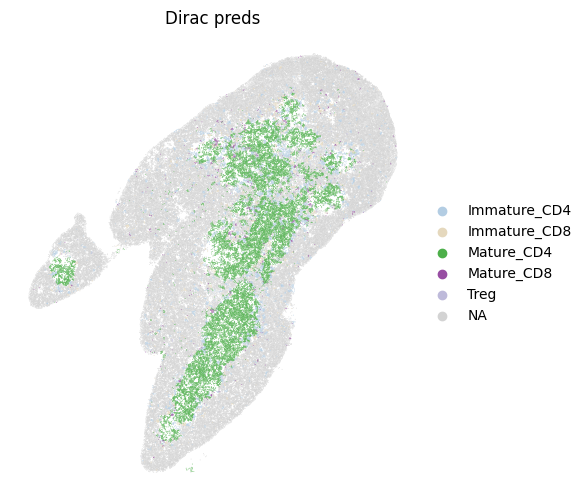

In [12]:
fig, ax = plt.subplots(figsize=(8, 6))

sc.pl.spatial(target_adata_total, 
              groups = ['Immature_CD4', 'Immature_CD8', 'Mature_CD4', 'Mature_CD8','Treg'],
              color=[f"{methods}_pred_clusters"], 
              frameon=False, 
              spot_size=20, 
              title=["Dirac preds"], 
              palette = colormaps_clusters,
              img_key=None,
              ax=ax)
fig.savefig(os.path.join(save_path, f"{data_name}_cell_type_only_T.pdf"), bbox_inches='tight', dpi = 300)

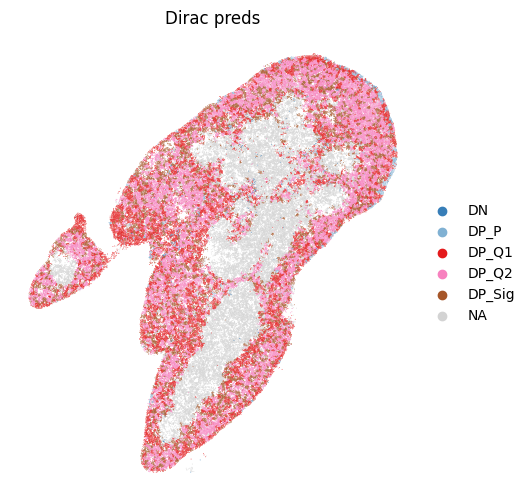

In [15]:
fig, ax = plt.subplots(figsize=(8, 6))

sc.pl.spatial(target_adata_total, 
              groups = ['DP_Q2', 'DP_Sig', 'DP_Q1', 'DP_P','DN'],
              color=[f"{methods}_pred_clusters"], 
              frameon=False, 
              spot_size=20, 
              title=["Dirac preds"], 
              palette = colormaps_clusters,
              img_key=None,
              ax=ax)
fig.savefig(os.path.join(save_path, f"{data_name}_cell_type_no_T.pdf"), bbox_inches='tight', dpi = 300)